In [ ]:
import rpy2
import rpy2.robjects as ro
ro.r(".libPaths")("/public1/software/liuzj/softwares/anaconda3/envs/sc_py/lib/R/library")
from rpy2.robjects.packages import importr
import rpy2.ipython.html
rpy2.ipython.html.init_printing()
from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re
from jpy_tools import loadPkl, toPkl
rBase = importr('base')
rUtils = importr('utils')
dplyr = importr('dplyr')
reticulate = importr('reticulate')
R = ro.r
T = Trl()
R("options(browser='firefox', shiny.port=6533)")
%load_ext rpy2.ipython


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

<Figure size 72x72 with 0 Axes>

In [ ]:
from jpy_tools import singleCellTools

Global seed set to 0


In [ ]:
import pandas as pd
import scanpy as sc
import numpy as np
import scipy.sparse as ss
from cool import F
import muon as mu

In [ ]:
import patchworklib as pw

In [ ]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"
sns.despine(top=True, right=True)
from itertools import product
from functools import reduce
import patchworklib as pw
from jpy_tools.otherTools import pwRecoverSeaborn, pwStack, F, pwShow
pw.show = pwShow
fc_recoverSns = pwRecoverSeaborn()
import seaborn.objects as so
from cycler import cycler
dt_snsStyle = {**sns.axes_style('ticks'), "legend.frameon": False, "axes.spines.top":False, "axes.spines.right":False, "axes.prop_cycle":cycler(color=['grey'])}

<Figure size 432x288 with 0 Axes>

In [ ]:
dir_temp = '/public/home/liuzj/projects/singleCell/02_jupyter/soybean/0510_combine/'

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Large Nodule": "Mature Nodule",
    "Small Nodule": "Developing Nodule",
}

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Mature Nodule": "Nodule (21 dpi)",
    "Developing Nodule": "Nodule (12 dpi)",
}

In [ ]:
# ad.obs['Sample_time'] = ad.obs['Sample_new'].map(dt_renameSample).cat.set_categories(['Nodule (21 dpi)', 'Nodule (12 dpi)', 'Root'])

# Load Gene Data

## load symbol info

In [ ]:
df_symbol = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/ncbi_locus/soybean_gene_symbol_name.txt").set_index('geneID')[['Symbol', 'other_designations']]

In [ ]:
df_symbol = df_symbol.loc[~df_symbol.index.duplicated()]

In [ ]:
dt_symbol = df_symbol.loc[~df_symbol['Symbol'].str.startswith('LOC')]['Symbol'].to_dict()

In [ ]:
df_soybase = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/soybase_genome_annotation_v2.0_09-27-2021.txt",
    skiprows=11,
)
dt_soybase = (
    df_soybase.assign(
        **{
            "Gmax 2.0 Primary Protein ID (1)": lambda df: df[
                "Gmax 2.0 Primary Protein ID (1)"
            ].str.replace("Glyma.", "GLYMA_")
        }
    )
    .set_index("Gmax 2.0 Primary Protein ID (1)")[
        "Top Arabidopsis (TAIR10) BLASTP Hit (4)"
    ]
    .to_dict()
)

## get arab desc

In [ ]:
df_arabDesc = pd.read_table('/data/Zhaijx/liuzj/data/Araport11/original/arab_gene_desc.txt')

In [ ]:
dt_arabDesc = df_arabDesc['Gene Model Name'].to_dict()

## load nodulation related gene

In [ ]:
dt_oldLocusToNew = pd.read_table(
    "/data/Zhaijx/liuzj/data/soybase_IPF/Glyma_11_to_Glyma_20_Correspondence_Full.csv",
    skiprows=1,
).assign(
    **{
        "Glyma 1.1": lambda df: df["Glyma 1.1"]
        .str.replace("Glyma", "Glyma."),
        "Glyma2.0": lambda df: df["Glyma2.0"]
        .str.replace("g", "G"),
    }
).set_index(
    "Glyma 1.1"
)[
    "Glyma2.0"
].to_dict()

In [ ]:
# other rules
dt_oldLocusToNew.update(
    {
        "Glyma.15G19630": "Glyma.15G178100",
        "Glyma.07G04510": "Glyma.07G040300",
        "Glyma.6g04220": "Glyma.06G039100",
        "Glyma.8g01770": "Glyma.08G014500",
        "Glyma.7G133000": "Glyma.07G133000",
        "Glyma.5G126200": "Glyma.05G126200",
    }
)

In [ ]:
dt_oldLocusToNew.update({x.replace('g', 'G'):y for x,y in dt_oldLocusToNew.items()})

In [ ]:
dt_oldLocusToNew.update({x.replace('Glyma.', 'Glyma'):y for x,y in dt_oldLocusToNew.items()})

In [ ]:
df_nodulationRelatedGene = pd.read_excel('/data/Zhaijx/liuzj/data/nodulation_related_gene/TPC2019-RA-00279_Supplemental_Data_Set_1.xlsx', skiprows=1, header = [0, 1])

In [ ]:
df_nodulationRelatedGene = df_nodulationRelatedGene[
    [
        ("Gene Symbol", "Unnamed: 0_level_1"),
        ("Phenotypic Defect", "Infection"),
        ("Phenotypic Defect", "Nodule Organogenesis "),
        ("Phenotypic Defect", "Fixation"),
        ("Reference", "Unnamed: 4_level_1"),
        ("Protein class/Molecular function", "Unnamed: 5_level_1"),
        ("Gene Name", "Unnamed: 6_level_1"),
        ("Alternate names", "Unnamed: 7_level_1"),
        ("Mutagen", "Unnamed: 8_level_1"),
        ("Medicago Gene ID", "Unnamed: 9_level_1"),
        ("Probeset", "Unnamed: 10_level_1"),
        ("Lotus Gene ID", "Unnamed: 11_level_1"),
        ("Soybean Gene ID", "Unnamed: 12_level_1"),
        ("Phaseolus Gene ID", "Unnamed: 13_level_1"),
        ("Myc Phenotype", "Unnamed: 14_level_1"),
    ]
]

In [ ]:
def _rename(x):
    if x[1].startswith('Unnamed'):
        return x[0]
    else:
        return x[1] + 'Phenotype'
df_nodulationRelatedGene.columns = df_nodulationRelatedGene.columns.map(_rename)
df_nodulationRelatedGene

,Gene Symbol,InfectionPhenotype,Nodule Organogenesis Phenotype,FixationPhenotype,Reference,Protein class/Molecular function,Gene Name,Alternate names,Mutagen,Medicago Gene ID,Probeset,Lotus Gene ID,Soybean Gene ID,Phaseolus Gene ID,Myc Phenotype
0,GmACP,NaN,Nod+/-,NaN,"Wang et al., 2014",Carrier protein,ACYL CARRIER PROTEIN (ACP),NaN,RNAi,Medtr7g080390,Mtr.48571.1.S1_at,Lj1g3v2840250,Glyma.18G244300,Phvul.008G052400,NaN
1,"PvAGO5, GmAGO5",Inf-,"Nod+/-, White++",NaN,"Reyero-Saavedra et al., 2017",Multidomain protein (RNA silencing),ARGONAUTE 5 (AGO5),NaN,RNAi,"Medtr4g056430, Medtr4g056470",Mtr.45521.1.S1_at,Lj0g3v0169039.1,Glyma.12G083500,Phvul.011G088200,NaN
2,LjAMSH,"Inf+/-, Inf*",Nod+/-,Fix*,"Malolepszy et al., 2015",Enzyme (Metalloprotease; Deubiquitinating),ASSOCIATED MOLECULE WITH THE SH3 DOMAIN OF STA...,NaN,LORE1,Medtr6g083940,Mtr.21924.1.S1_at; Mtr.21925.1.S1_s_at,Lj2g3v0721190,Glyma.07G093100,Phvul.003G094300,Myc+
3,LjAMT1.1,NaN,Nod++,Fix+/-,"Rogato et al., 2008",Transporter (Ammonium),AMMONIUM TRANSPORTER 1.1 (AMT1.1),NaN,Antisense,Medtr1g045550,Mtr.10556.1.S1_at,"Lj5g3v1314550, Lj0g3v0302059",Glyma.10G132300,Phvul.007G231700,NaN
4,PvANN1,Inf+/-,Nod+/-,Fix+/-,"Carrasco-castilla et al., 2018",Membrane binding protein,ANNEXIN1 (ANN1),NaN,RNAi,Medtr8g038210,Mtr.14183.1.S1_at,Lj0g3v0203419,Glyma.13G199800,Phvul.011G209300,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,MtZPT2,NaN,Nod*,Fix-,"Frugier et al., 2000",TF (Zinc-finger motif containing),Krüppel-like Cys-2/His-2 ZINC FINGER PROTEIN (...,NaN,Antisense,Medtr3g102980,Mtr.37495.1.S1_at,-,Glyma.06G045400,Phvul.009G070800,NaN
203,MtZR1,NaN,Nod*,Fix+/-,"Hopkins et al., 2013",Unknown protein,ZINC RIBBON protein 1 (ZR1),NaN,RNAi,Medtr3g086740,Msa.965.1.S1_at,-,Glyma18g01770,"Phvul.001G254500, Phvul.011G068500",NaN
204,MtγECS,NaN,Nod+,Fix+/-,"El Msehli et al., 2011",Enzyme (Synthetase),γ‐GLUTAMYLCYSTEINE SYNTHETASE (γECS),NaN,RNAi,Medtr8g098350,Mtr.26622.1.S1_at,Lj4g3v2951270,Glyma.05G207600,Phvul.002G289200,NaN
205,Gs52,NaN,"Nod+/-, Nod*",Fix*,"Govindarajulu M, 2009",Enzyme (Ecto-apyrase),Glycine sojae 52 (GS52),NaN,RNAi,Medtr7g085200,-,Lj1g3v3948070,Glyma.16G043300,-,NaN


In [ ]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene ID'].str.findall(r"Glyma.[\w]+\b")
df_nodulationRelatedGene = df_nodulationRelatedGene.explode('Soybean Gene Parsed ID')
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].map(lambda x:dt_oldLocusToNew.get(x,x))

In [ ]:
df_nodulationRelatedGene['Soybean Gene Parsed ID'] = df_nodulationRelatedGene['Soybean Gene Parsed ID'].str.replace('Glyma.', 'GLYMA_')

In [ ]:
ls_otherSpecies = """LjNFR5
LjSYMRK
LjNIN 
LjHAR1
MtVAMP721d/MtVAMP721e""".split('\n')

In [ ]:
df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene.pipe(lambda df:df.loc[df['Gene Symbol'].str.contains('Gm') | df.eval("`Gene Symbol` in @ls_otherSpecies")])
# df_nodulationRelatedGeneGmOnly = df_nodulationRelatedGene

In [ ]:
df_nodulationRelatedGene

,Gene Symbol,InfectionPhenotype,Nodule Organogenesis Phenotype,FixationPhenotype,Reference,Protein class/Molecular function,Gene Name,Alternate names,Mutagen,Medicago Gene ID,Probeset,Lotus Gene ID,Soybean Gene ID,Phaseolus Gene ID,Myc Phenotype,Soybean Gene Parsed ID
0,GmACP,NaN,Nod+/-,NaN,"Wang et al., 2014",Carrier protein,ACYL CARRIER PROTEIN (ACP),NaN,RNAi,Medtr7g080390,Mtr.48571.1.S1_at,Lj1g3v2840250,Glyma.18G244300,Phvul.008G052400,NaN,GLYMA_18G244300
1,"PvAGO5, GmAGO5",Inf-,"Nod+/-, White++",NaN,"Reyero-Saavedra et al., 2017",Multidomain protein (RNA silencing),ARGONAUTE 5 (AGO5),NaN,RNAi,"Medtr4g056430, Medtr4g056470",Mtr.45521.1.S1_at,Lj0g3v0169039.1,Glyma.12G083500,Phvul.011G088200,NaN,GLYMA_12G083500
2,LjAMSH,"Inf+/-, Inf*",Nod+/-,Fix*,"Malolepszy et al., 2015",Enzyme (Metalloprotease; Deubiquitinating),ASSOCIATED MOLECULE WITH THE SH3 DOMAIN OF STA...,NaN,LORE1,Medtr6g083940,Mtr.21924.1.S1_at; Mtr.21925.1.S1_s_at,Lj2g3v0721190,Glyma.07G093100,Phvul.003G094300,Myc+,GLYMA_07G093100
3,LjAMT1.1,NaN,Nod++,Fix+/-,"Rogato et al., 2008",Transporter (Ammonium),AMMONIUM TRANSPORTER 1.1 (AMT1.1),NaN,Antisense,Medtr1g045550,Mtr.10556.1.S1_at,"Lj5g3v1314550, Lj0g3v0302059",Glyma.10G132300,Phvul.007G231700,NaN,GLYMA_10G132300
4,PvANN1,Inf+/-,Nod+/-,Fix+/-,"Carrasco-castilla et al., 2018",Membrane binding protein,ANNEXIN1 (ANN1),NaN,RNAi,Medtr8g038210,Mtr.14183.1.S1_at,Lj0g3v0203419,Glyma.13G199800,Phvul.011G209300,NaN,GLYMA_13G199800
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,MtZPT2,NaN,Nod*,Fix-,"Frugier et al., 2000",TF (Zinc-finger motif containing),Krüppel-like Cys-2/His-2 ZINC FINGER PROTEIN (...,NaN,Antisense,Medtr3g102980,Mtr.37495.1.S1_at,-,Glyma.06G045400,Phvul.009G070800,NaN,GLYMA_06G045400
203,MtZR1,NaN,Nod*,Fix+/-,"Hopkins et al., 2013",Unknown protein,ZINC RIBBON protein 1 (ZR1),NaN,RNAi,Medtr3g086740,Msa.965.1.S1_at,-,Glyma18g01770,"Phvul.001G254500, Phvul.011G068500",NaN,GLYMA_18G014300
204,MtγECS,NaN,Nod+,Fix+/-,"El Msehli et al., 2011",Enzyme (Synthetase),γ‐GLUTAMYLCYSTEINE SYNTHETASE (γECS),NaN,RNAi,Medtr8g098350,Mtr.26622.1.S1_at,Lj4g3v2951270,Glyma.05G207600,Phvul.002G289200,NaN,GLYMA_05G207600
205,Gs52,NaN,"Nod+/-, Nod*",Fix*,"Govindarajulu M, 2009",Enzyme (Ecto-apyrase),Glycine sojae 52 (GS52),NaN,RNAi,Medtr7g085200,-,Lj1g3v3948070,Glyma.16G043300,-,NaN,GLYMA_16G043300


## load matrix and QC

In [ ]:
import glob

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/"

In [ ]:
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [ ]:
ls_cellrangerH5 = [f"{dir_result}/{x}/{x}/outs/filtered_feature_bc_matrix.h5" for x in ls_sample]

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]

In [ ]:
ad = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [ ]:
sc.pp.filter_genes(ad, min_cells=10)

In [ ]:
ad.obs.value_counts("batch")

batch
nodule_large    14819
nodule_small     9686
root             7636
dtype: int64

In [ ]:
singleCellTools.detectDoublet.byScDblFinder(ad, batch_key='batch')

2021-09-26 10:50:51.612 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:167 - start to transfer adata to R


transfer `<class 'anndata._core.anndata.AnnData'>` to R:  End  


2021-09-26 10:53:26.225 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:171 - start to calculate doublet score
2021-09-26 10:55:32.050 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:175 - start to intergrate result with adata


transfer `DFrame` to python:  End  


2021-09-26 10:55:33.833 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:188 - before filter: 32141
2021-09-26 10:55:34.100 | INFO     | jpy_tools.singleCellTools.detectDoublet:byScDblFinder:192 - after filter: 27602


In [ ]:
ad.obs['batch'] = ad.obs['batch'].cat.set_categories(['nodule_small', 'nodule_large', 'root'])

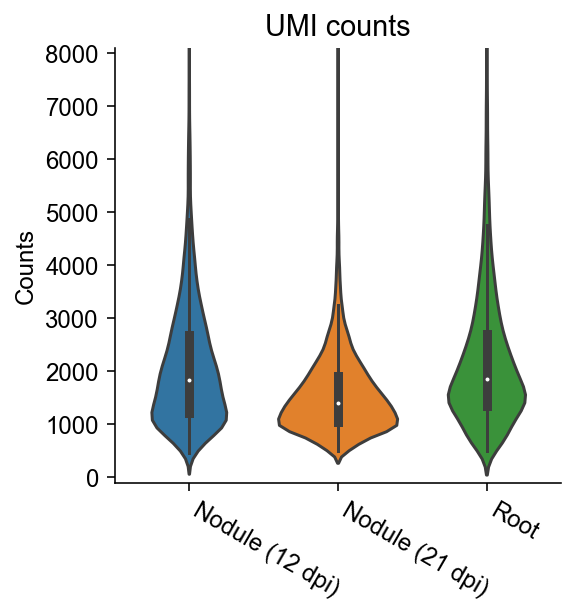

In [ ]:
plt.subplots(figsize=(4,4))
sns.violinplot(data = ad.obs, x='batch', y='n_counts')
plt.ylim(-100, 8100)
plt.xticks([0,1,2], ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'], rotation=-30, ha='left')
plt.xlabel('')
plt.ylabel("Counts")
plt.title("UMI counts")
sns.despine()

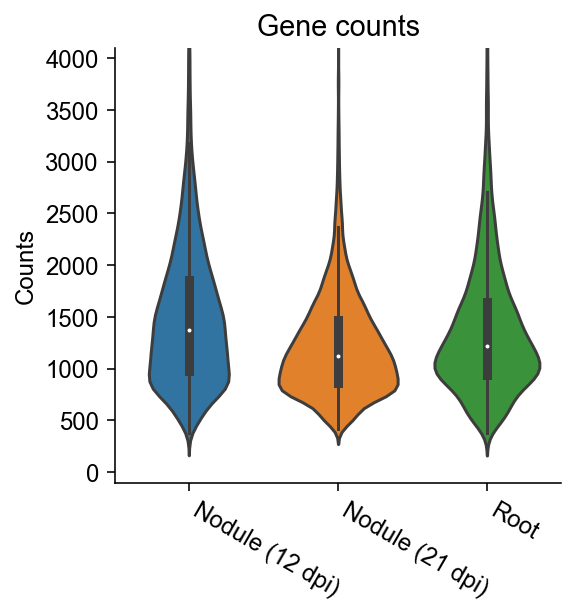

In [ ]:
plt.subplots(figsize=(4,4))
sns.violinplot(data = ad.obs, x='batch', y='n_genes')
plt.ylim(-100, 4100)
plt.xticks([0,1,2], ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'], rotation=-30, ha='left')
plt.xlabel('')
plt.ylabel("Counts")
plt.title("Gene counts")
sns.despine()

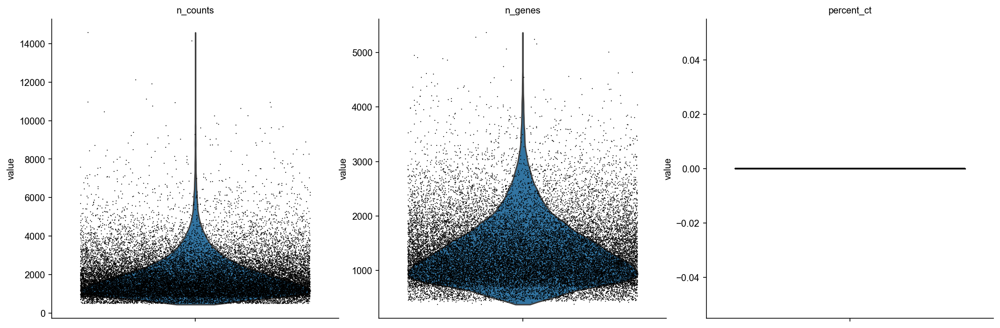

In [ ]:
singleCellTools.plotting.plotCellScatter(ad)

In [ ]:
ad = ad[ad.obs.eval("400 < n_genes < 4000 & 600 < n_counts < 6000")]

In [ ]:
ad.obs.value_counts("batch")

batch
nodule_large    12004
nodule_small     8229
root             6479
dtype: int64

In [ ]:
ad.layers['raw'] = ad.X.copy()

## basic static

In [ ]:
ad.obs['UMI counts'] = ad.to_df('raw').sum(1)
ad.obs['Gene counts'] = (ad.to_df('raw') > 0).astype(int).sum(1)

In [ ]:
_dt = {'nodule_large':'Large Nodule', 'nodule_small':'Small Nodule', 'root':'Root'}
ad.obs['Sample'] = ad.obs['batch'].map(_dt)

In [ ]:
ad_merged = singleCellTools.geneEnrichInfo._mergeData(ad, 'Sample_time', 'raw')

In [ ]:
(ad_merged.to_df() > 0).T.to_excel(f"{dir_result}/gene_basic_info.xlsx")

## clustering

In [ ]:
import scvi
from jpy_tools.otherTools import loadPkl, toPkl

In [ ]:
sc.pp.highly_variable_genes(ad, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad.layers['normalize_log'] = ad.layers['raw'].copy()
sc.pp.normalize_total(ad, 1e4, layer='normalize_log')
sc.pp.log1p(ad, layer='normalize_log')

## run scVI to integrate datasets

In [ ]:
ad_forScvi = singleCellTools.basic.getPartialLayersAdata(ad, 'raw', ['batch'], ['highly_variable'])
ad_forScvi = ad_forScvi[:, ad_forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_forScvi, 'ad_forScvi_soybean', 'scem')

0


In [ ]:
# run on scem
# scvi.data.setup_anndata(
#     ad_forScvi,
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model_withBatchEffect = scvi.model.SCVI(ad_forScvi)
# model_withBatchEffect.train()
# ad_forScvi.obsm['X_scvi_withBatchEffect'] = model_withBatchEffect.get_latent_representation(ad_forScvi).copy()


# scvi.data.setup_anndata(
#     ad_forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 56

# model = scvi.model.SCVI(ad_forScvi)
# model.train()
# ad_forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_forScvi).copy()

In [ ]:
ad_forScvi = loadPkl('ad_forScvi_soybean').copy()

In [ ]:
ad.obsm['X_scvi_withBatchEffect'] = ad_forScvi.obsm['X_scvi_withBatchEffect']
ad.obsm['X_scvi'] = ad_forScvi.obsm['X_scvi']

In [ ]:
sc.pp.neighbors(ad, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad)

In [ ]:
sc.tl.leiden(ad, resolution=0.3)
ad.obs['Cluster'] = ad.obs['leiden']

In [ ]:
ad.obs['Cluster'] = ad.obs['Cluster'].astype(str)

In [ ]:
_ls_colors = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#ff9896',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#d62728',
 '#c5b0d5',
 '#c49c94']

ad.uns['leiden_colors'] = _ls_colors
ad.uns['Cluster_colors'] = _ls_colors
ad.uns['Cell type_colors'] = _ls_colors

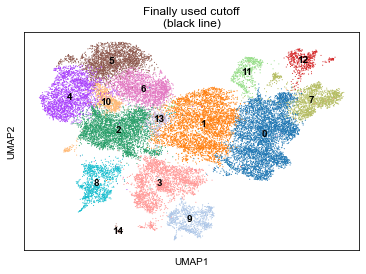

In [ ]:
sc.pl.umap(ad, color = 'Cluster', legend_loc='on data', title='Finally used cutoff\n(black line)')

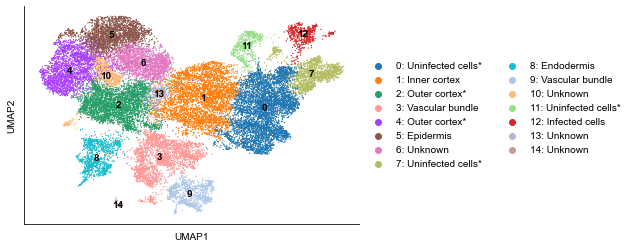

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

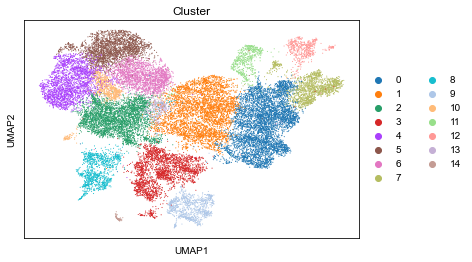

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

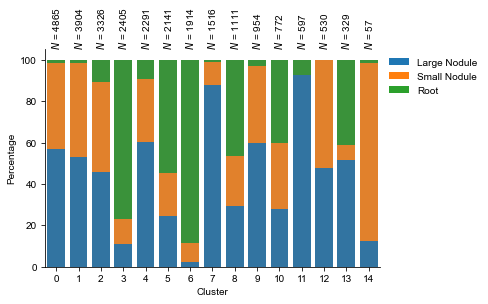

In [ ]:
sc.pl.umap(ad, color = 'Cluster')
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

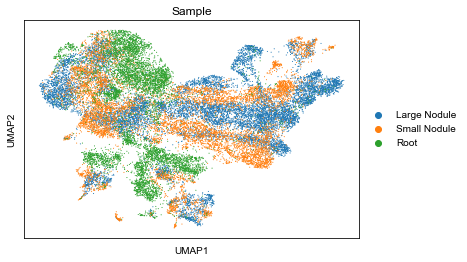

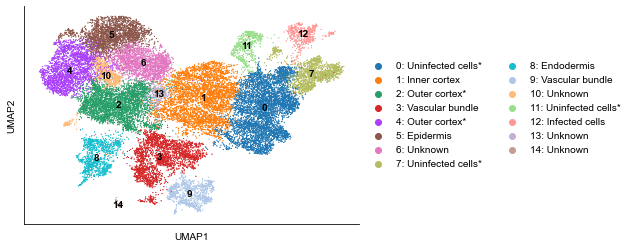

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

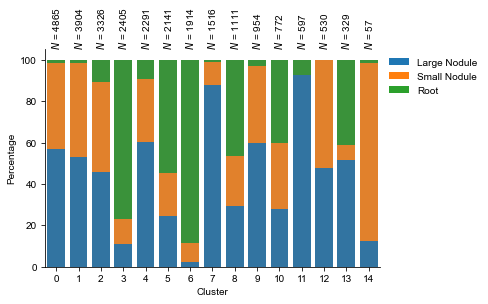

In [ ]:
sc.pl.umap(ad, color="Sample")
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

In [ ]:
ad.uns['Sample_time_colors'] = ['#ff7f0e', '#1f77b4', '#2ca02c']

In [ ]:
ad.obs['Sample_time'] = ad.obs['Sample_time'].cat.set_categories([ 'Nodule (12 dpi)','Nodule (21 dpi)', 'Root'])

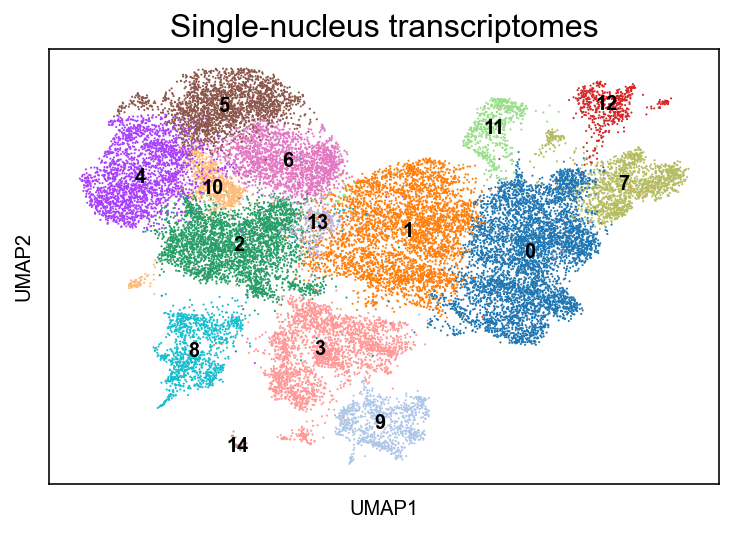

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", title='Single-nucleus transcriptomes', legend_loc='on data', show=False)
plt.title('Single-nucleus transcriptomes', fontsize=16)
plt.show()

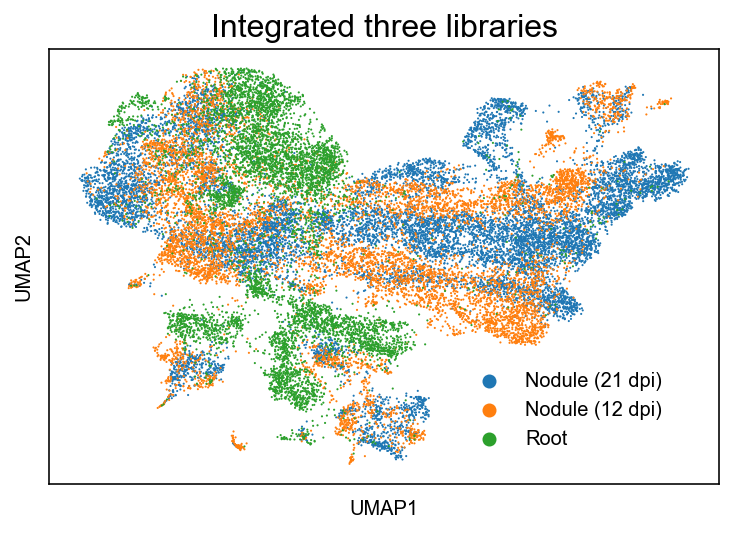

In [ ]:
ax = sc.pl.umap(ad, color="Sample_time", title='Integrated three libraries', show=False)
plt.title('Integrated three libraries', fontsize=16)
plt.legend(loc='upper left', bbox_to_anchor=(0.6, 0.3), frameon=False, ncol=1)
plt.show()

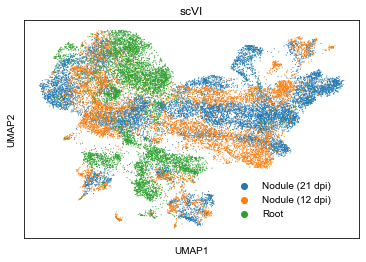

In [ ]:
ax = sc.pl.umap(ad, color="Sample_time", title='scVI', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(0.6, 0.3), frameon=False, ncol=1)

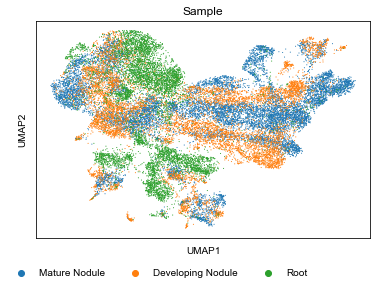

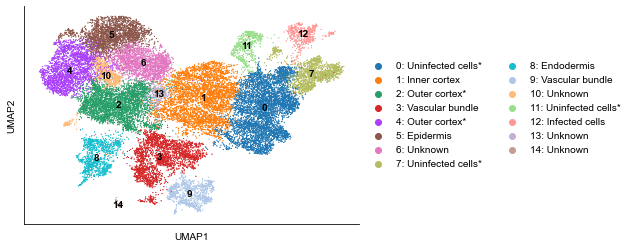

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

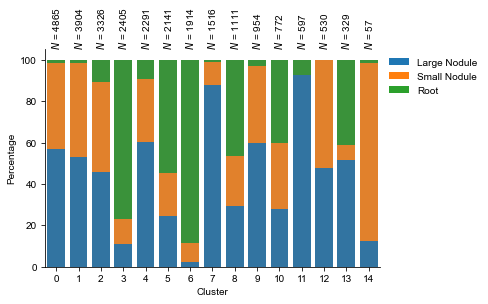

In [ ]:
ax = sc.pl.umap(ad, color="Sample_new", title='Sample', show=False)
plt.legend(loc='upper left', bbox_to_anchor=(-0.1, -0.1), frameon=False, ncol=3)

ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
sns.despine(top=True, right=True)
plt.show()

singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")

## scanorama

In [ ]:
import scanpy.external as sce

In [ ]:
ad_scanorama = ad.copy()

In [ ]:
ad_scanorama.X = ad_scanorama.layers['normalize_log'].copy()

In [ ]:
sc.tl.pca(ad_scanorama)

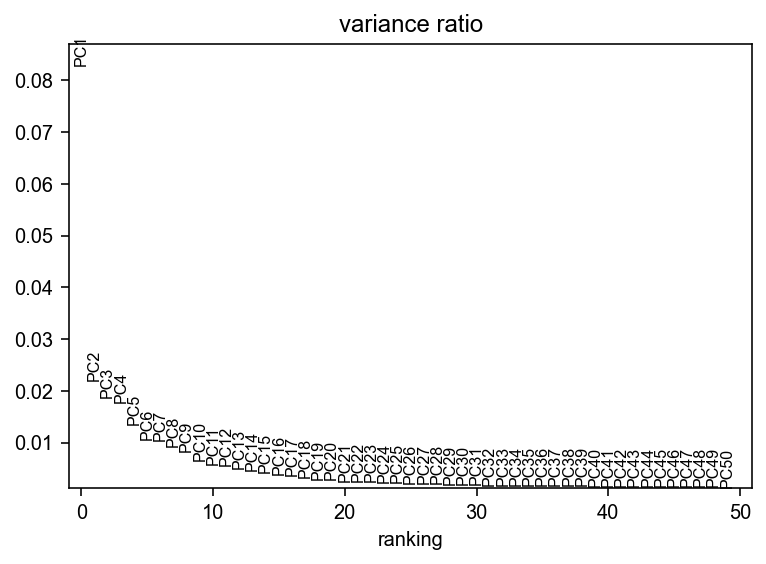

In [ ]:
sc.pl.pca_variance_ratio(ad_scanorama, 50,)

In [ ]:
ad_scanorama.obsm['X_pca_10'] = ad_scanorama.obsm['X_pca'][:, :10]

In [ ]:
sce.pp.scanorama_integrate(ad_scanorama, 'batch', basis='X_pca_10')

[[0.         0.19650018 0.01389103]
 [0.         0.         0.20311777]
 [0.         0.         0.        ]]
Processing datasets nodule_small <=> root
Processing datasets nodule_large <=> nodule_small


In [ ]:
sc.pp.neighbors(ad_scanorama, use_rep='X_scanorama')

In [ ]:
sc.tl.umap(ad_scanorama, 0.3)

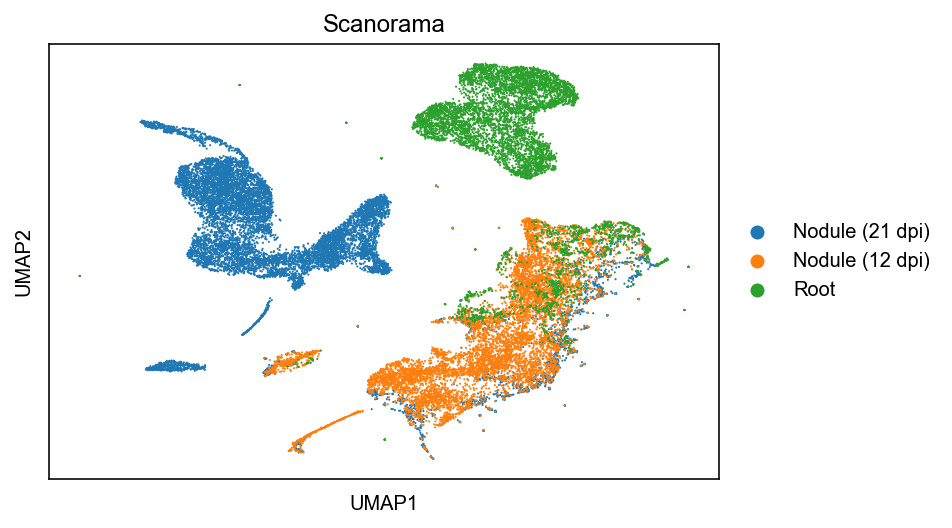

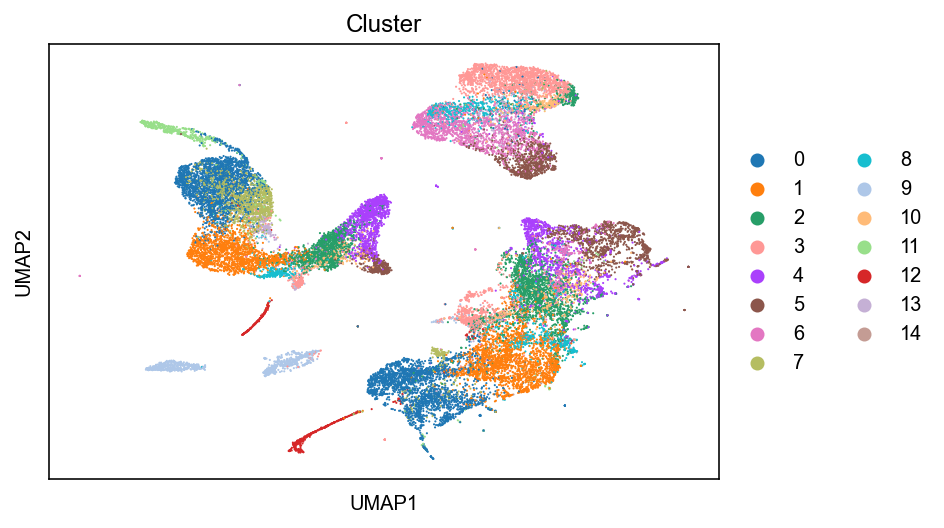

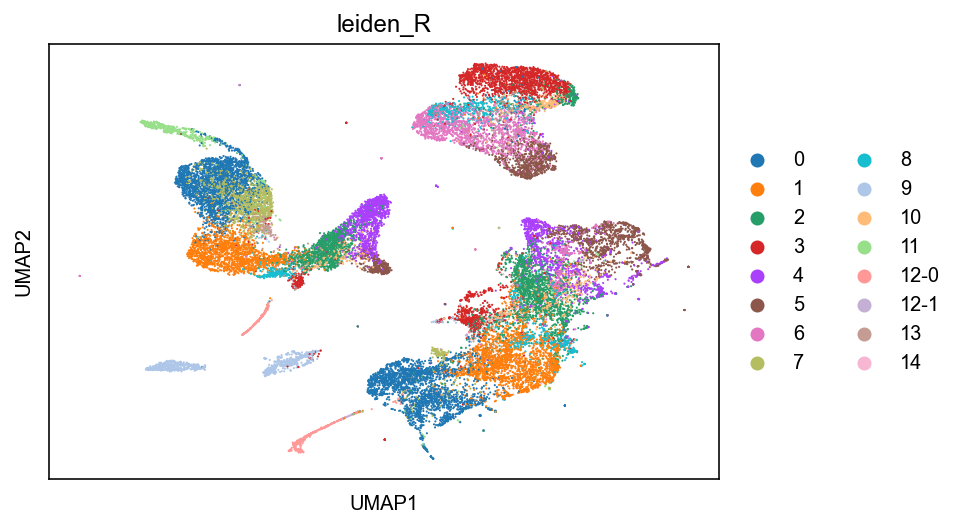

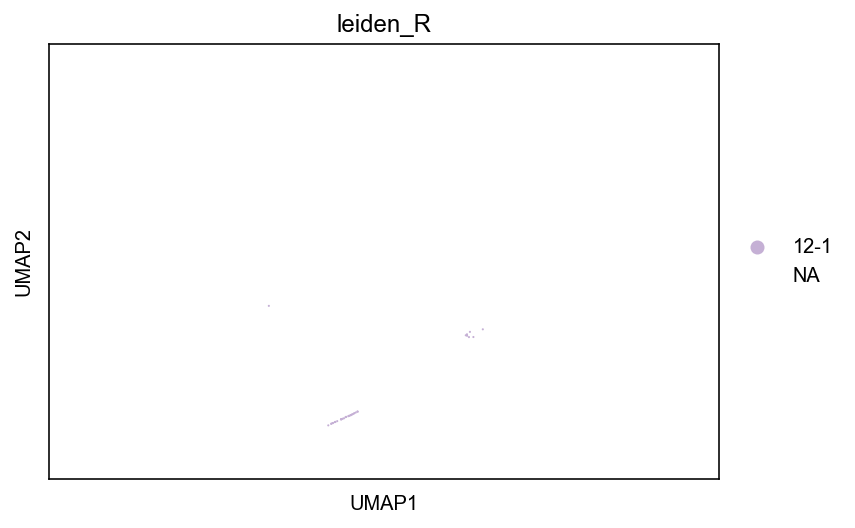

In [ ]:
sc.pl.umap(ad_scanorama, color='Sample_time', title='Scanorama')
sc.pl.umap(ad_scanorama, color='Cluster')
sc.pl.umap(ad_scanorama, color='leiden_R')
sc.pl.umap(ad_scanorama, color='leiden_R', groups=('leiden', ('12-1')), na_color='#FFFFFF')

Text(0, 0.5, '')

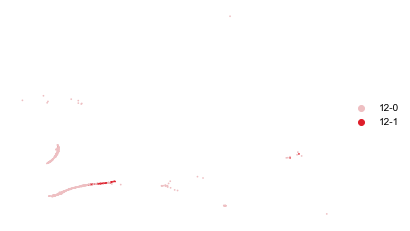

In [ ]:
sc.pl.umap(
    ad_scanorama[ad_scanorama.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

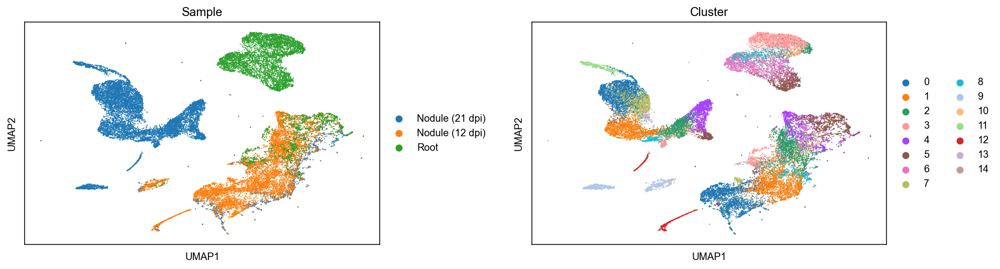

In [ ]:
axs = sc.pl.umap(ad_scanorama, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3, show=False)
ax = axs[0]
plt.sca(ax)
# plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.07), frameon=False, ncol=3, fontsize=12)
# plt.tight_layout()
plt.show()

## harmony

In [ ]:
import scanpy.external as sce

In [ ]:
ad_harmony = ad.copy()

In [ ]:
ad_harmony.X = ad_harmony.layers['normalize_log'].copy()

In [ ]:
sc.tl.pca(ad_harmony)

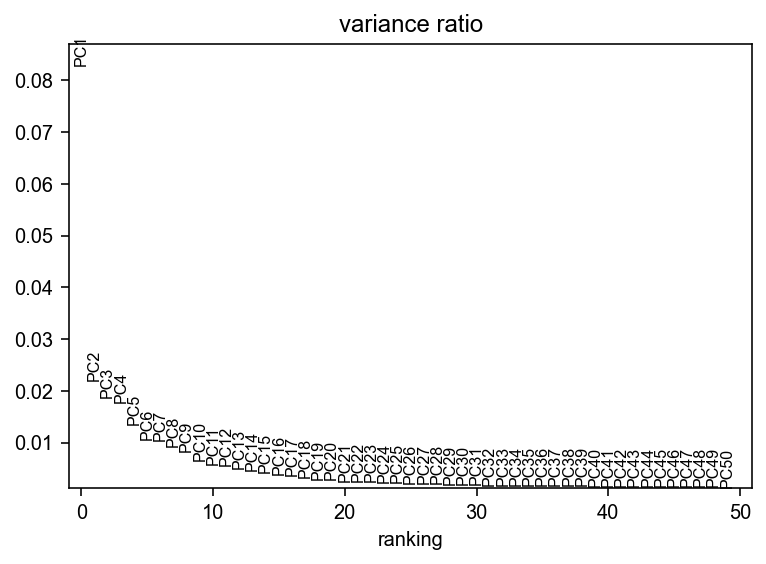

In [ ]:
sc.pl.pca_variance_ratio(ad_harmony, 50,)

In [ ]:
ad_harmony.obsm['X_pca_10'] = ad_harmony.obsm['X_pca'][:, :10]

In [ ]:
sce.pp.harmony_integrate(ad_harmony, 'batch', basis='X_pca_10')

2022-10-31 14:01:49,755 - harmonypy - INFO - Iteration 1 of 10
2022-10-31 14:01:59,244 - harmonypy - INFO - Iteration 2 of 10
2022-10-31 14:02:08,679 - harmonypy - INFO - Iteration 3 of 10
2022-10-31 14:02:18,614 - harmonypy - INFO - Iteration 4 of 10
2022-10-31 14:02:28,275 - harmonypy - INFO - Iteration 5 of 10
2022-10-31 14:02:37,530 - harmonypy - INFO - Iteration 6 of 10
2022-10-31 14:02:46,733 - harmonypy - INFO - Converged after 6 iterations


In [ ]:
sc.pp.neighbors(ad_harmony, use_rep='X_pca_harmony')

In [ ]:
sc.tl.umap(ad_harmony, 0.3)

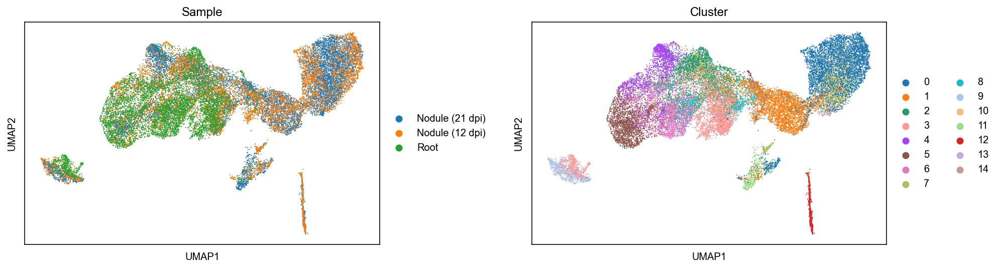

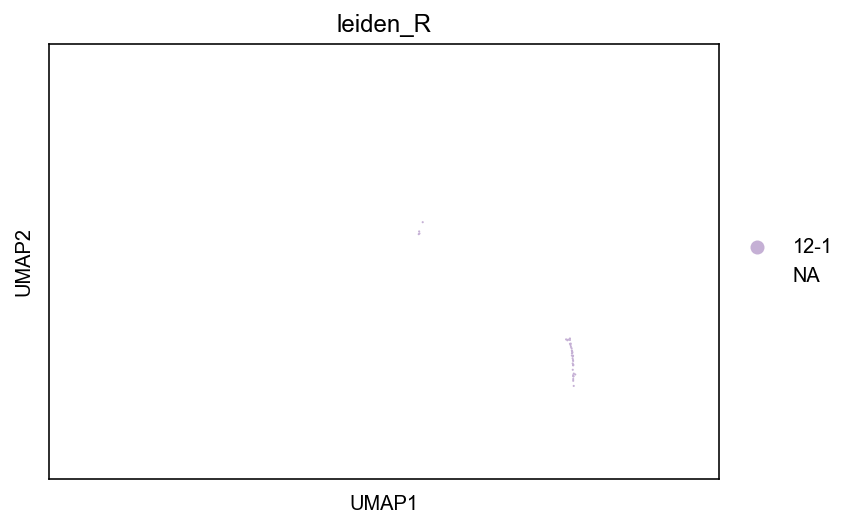

In [ ]:
axs = sc.pl.umap(ad_harmony, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3)

sc.pl.umap(ad_harmony, color='leiden_R', groups=('leiden_R', ('12-1')), na_color='#FFFFFF')

Text(0.5, 1.0, 'Cluster 12')

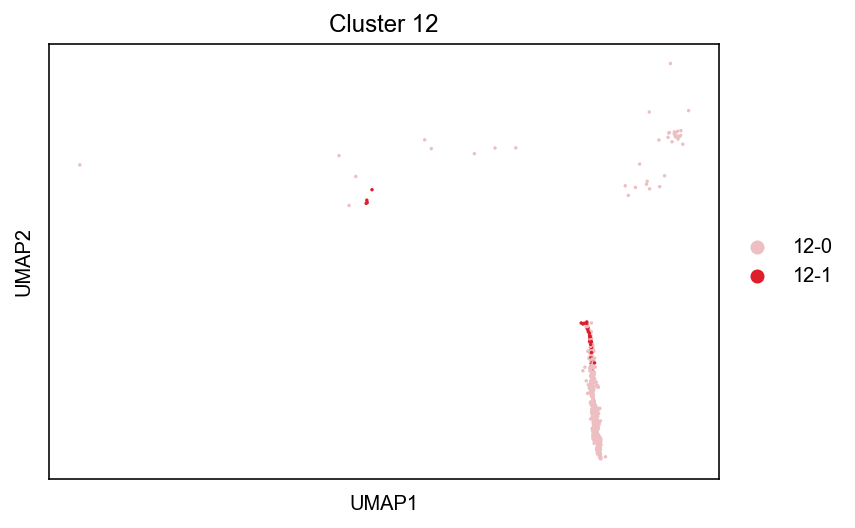

In [ ]:
sc.pl.umap(
    ad_harmony[ad_harmony.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
plt.title('Cluster 12')

## CCA

In [ ]:
Seurat = importr('Seurat')

In [ ]:
ad_cca = singleCellTools.normalize.integrateBySeurat(ad, 'batch', ad.var.loc[lambda df:df['highly_variable']].index.to_list())

R[write to console]: Warning:
R[write to console]:  Feature names cannot have underscores ('_'), replacing with dashes ('-')

R[write to console]: Warning:
R[write to console]:  Invalid name supplied, making object name syntactically valid. New object name is batchn_genesn_countspercent_ctleiden_0.0leiden_0.1leiden_0.2leiden_0.3leiden_0.4leiden_0.5leiden_0.6leiden_0.7leiden_0.8leiden_0.9leiden_1.0leiden_1.1leiden_1.2leiden_1.3leiden_1.4leiden_1.5leiden_1.6leiden_1.7leiden_1.8leiden_1.9leiden_2.0leidenUMI.countsGene.countsSampleleiden_RClusterCell.typeX__groupSample_twoPartitionUMI.counts.log10Sample_newwgcna_clustercluster_mergeUCSample_time; see ?make.names for more details on syntax validity

R[write to console]: Warning:
R[write to console]:  Keys should be one or more alphanumeric characters followed by an underscore, setting key from scvi_withBatchEffect_ to scviwithBatchEffect_

R[write to console]: Warning:
R[write to console]:  All keys should be one or more alphanumeric charac


  |                                                  | 0 % ~calculating  
  |+++++++++++++++++                                 | 33% ~10s          
  |++++++++++++++++++++++++++++++++++                | 67% ~04s          
  |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=11s  


R[write to console]: Finding all pairwise anchors




  |                                                  | 0 % ~calculating  

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 15752 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 5537 anchors




  |+++++++++++++++++                                 | 33% ~12m 38s      

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 15221 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 2648 anchors




  |++++++++++++++++++++++++++++++++++                | 67% ~06m 35s      

R[write to console]: Running CCA

R[write to console]: Merging objects

R[write to console]: Finding neighborhoods

R[write to console]: Finding anchors

R[write to console]: 	Found 12094 anchors

R[write to console]: Filtering anchors

R[write to console]: 	Retained 3489 anchors




  |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=15m 26s


R[write to console]: Merging dataset 2 into 1

R[write to console]: Extracting anchors for merged samples

R[write to console]: Finding integration vectors

R[write to console]: Finding integration vector weights

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to con

In [ ]:
sc.tl.pca(ad_cca)

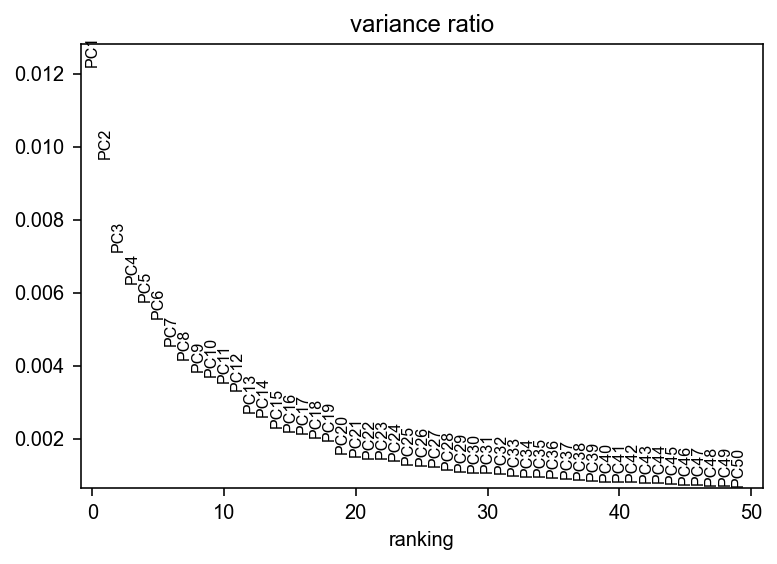

In [ ]:
sc.pl.pca_variance_ratio(ad_cca, 50)

In [ ]:
sc.pp.neighbors(ad_cca, n_pcs=20)

In [ ]:
sc.tl.umap(ad_cca, 0.3)

In [ ]:
ad_cca.uns['Cluster_colors'] = ad.uns['Cluster_colors']

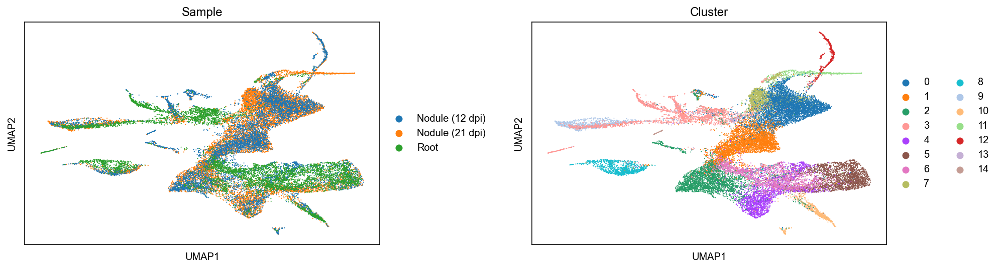

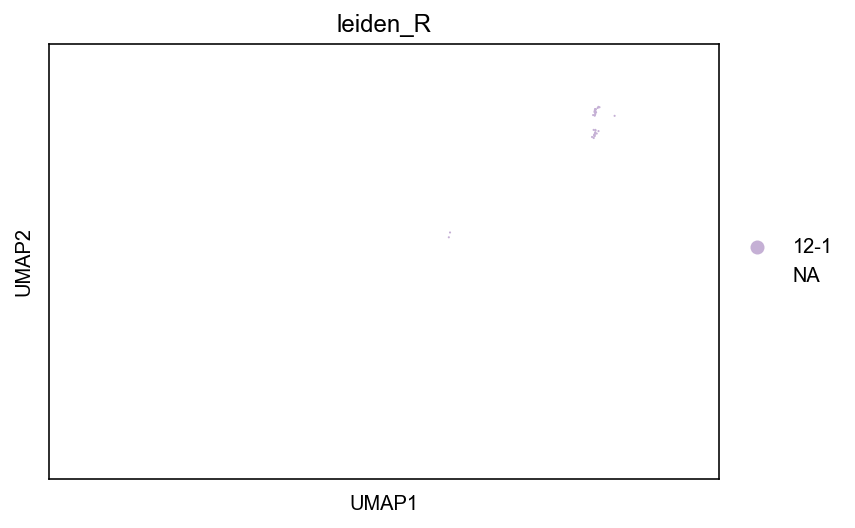

In [ ]:
axs = sc.pl.umap(ad_cca, color=['Sample_time', 'Cluster'], title=['Sample', 'Cluster'], wspace=0.3)

sc.pl.umap(ad_cca, color='leiden_R', groups=('leiden_R', ('12-1')), na_color='#FFFFFF')

Text(0.5, 1.0, 'Cluster 12')

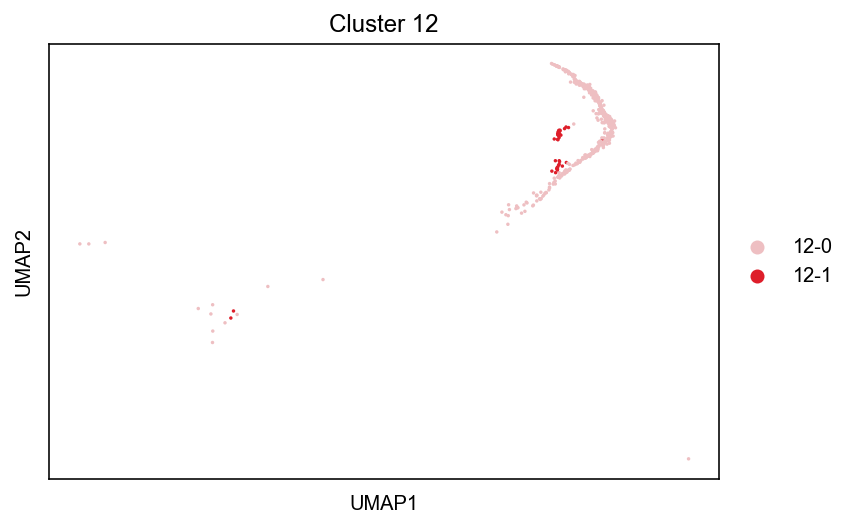

In [ ]:
sc.pl.umap(
    ad_cca[ad_cca.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'],size=12
)
plt.title('Cluster 12')

# annotation

## by gene

In [ ]:
dt_visualizationGene = {
    "Cortex": {"PIN2": "GLYMA_09G117900", "ENOD2": "GLYMA_20G203800", "CA1": "GLYMA_06G182700"},
    "Stele": dict(
        # MATE79="GLYMA_13G339800",
        MATE87="GLYMA_15G274600",
        PIN1b="GLYMA_07G102500",
        #         PIN1d="GLYMA_03G126000",
        SLR="GLYMA_03G158700",
        **{"NPF7.3":"GLYMA_17G153300"}
    ),
    #     "Infection Zone": dict(
    #         LBA="GLYMA_10G199100",
    #         LBC1="GLYMA_10G199000",
    #         LBC2="GLYMA_20G191200",
    #         LBC3="GLYMA_10G198800",
    #     ),
    "Infected cell": {"SYMREM1.1": "GLYMA_08G012800", "ENOD55": "GLYMA_02G204500", "RPG": "GLYMA_10G198700"}, 
    "Epidermis": dict(SHV3='GLYMA_08G324300', COBL7="GLYMA_09G039900",  CPC= "GLYMA_01G224900"),
}
dt_visualizationGene = {x:{j:f"{i}\n({j})" for i,j in y.items()} for x,y in dt_visualizationGene.items()}

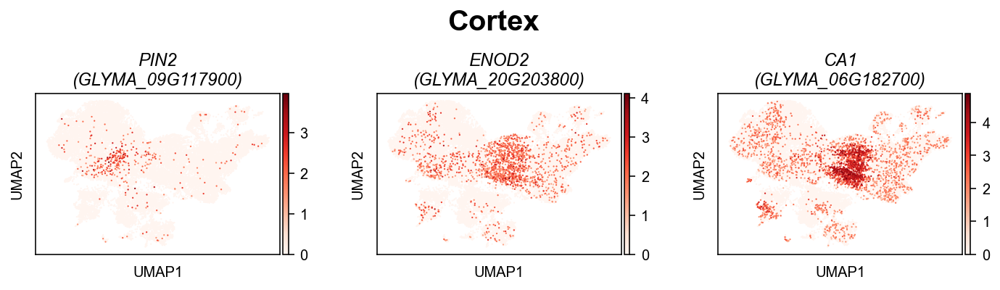

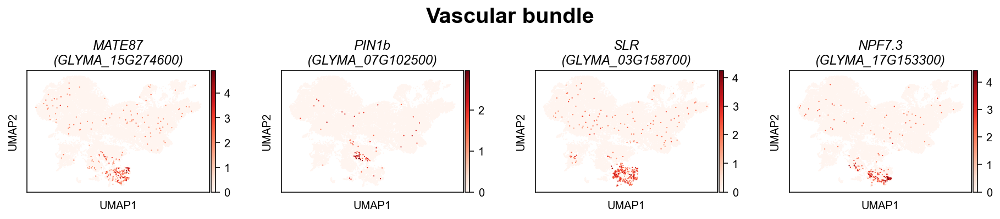

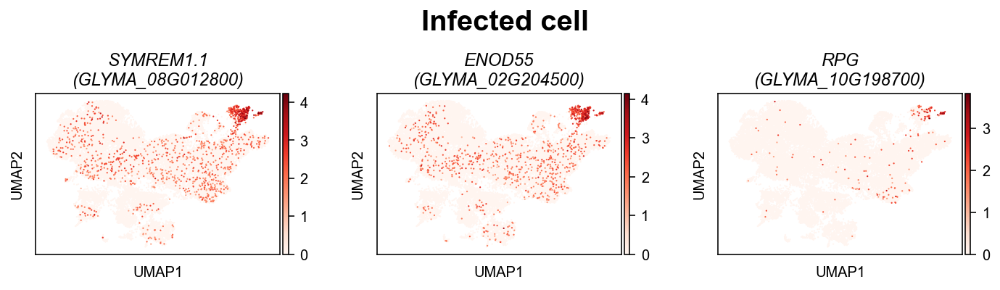

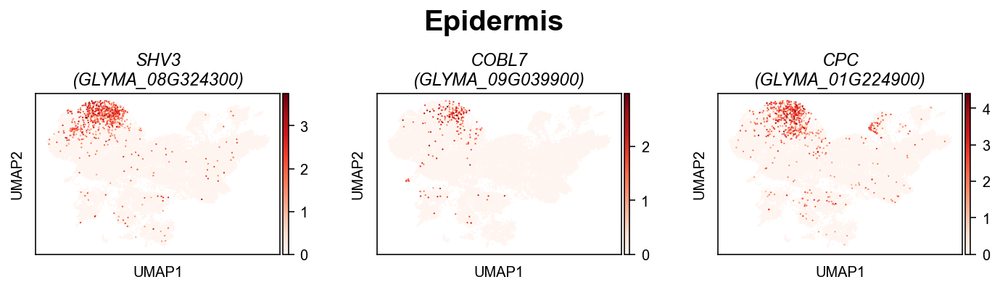

In [ ]:
with plt.rc_context({"figure.figsize": (3, 2)}):
    for (celltype, _dt_genes), x, z, y in zip(
        dt_visualizationGene.items(), [0.45, 0.45, 0.46, 0.45, 0.45], [5,5,5,5,10], [1.3,1.3,1.3,1.3,1.3]
    ):
        axs = sc.pl.umap(
            ad,
            layer="normalize_log",
            cmap="Reds",
            color=_dt_genes.keys(),
            title=_dt_genes.values(),
            size=z,
            show=False,
            ncols=4,
            hspace=0.7,
        )
            
        if len(_dt_genes) == 1:
            axs = [axs]
        for ax in axs:
            plt.sca(ax)
            text = ax.get_title()
            plt.title(text, fontdict={"style": "italic"})
        if celltype == 'Stele':
            celltype = 'Vascular bundle'
        plt.suptitle(celltype, x=x, y=y, fontsize=20, fontweight='bold')
        plt.show()

[<AxesSubplot:title={'center':'GLYMA_02G098200'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_11G203900'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_05G088400'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GLYMA_13G300600'}, xlabel='UMAP1', ylabel='UMAP2'>]

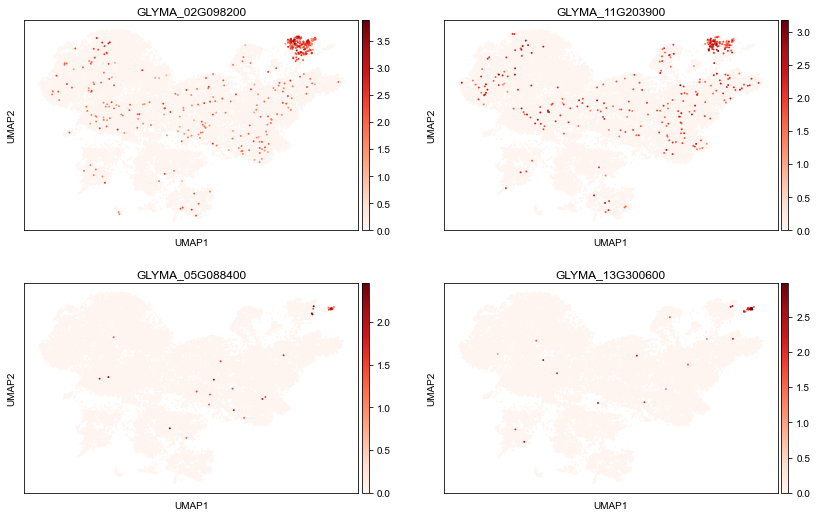

In [ ]:
_ls = ['GLYMA_02G098200', 'GLYMA_11G203900', 'GLYMA_05G088400', 'GLYMA_13G300600']

sc.pl.umap(
                ad,
                layer="normalize_log",
                cmap="Reds",
                color=_ls,
                size=15,
                ncols=2,
                show=False,
            )

## by ara

In [ ]:
dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1/arab__v__soybase_2.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [ ]:
dt_arab2soybean = pd.read_table(
    "/public/home/liuzj/data/ortholog/plant/parsed/1v1_test/soybase_2__v__arab.1v1.tsv"
).set_index("arab")["soybase_2"].to_dict()

In [ ]:
ad_ara = sc.read_h5ad('/data/Zhaijx/liuzj/projects/singleCellRoot/bioaxivData/GSE152766_Root_Atlas.h5ad')
ad_ara = ad_ara[:, ad_ara.var.index.isin(list(dt_arab2soybean.keys()))]
ad_ara.var.index = ad_ara.var.index.map(dt_arab2soybean)
ad_ara.obs['specie'] = 'arabidopsis'

In [ ]:
ad_root = ad[ad.obs['batch'] == 'root'].copy()

In [ ]:
ad_root.obs['orig.ident'] = 'soybean'
ad_root.obs['specie'] = 'soybean'

In [ ]:
import anndata

In [ ]:
toPkl(ad_ara, 'ad_ara', 'scem')
toPkl(ad_root, 'ad_root', 'scem')

2022-11-02 19:20:20.833 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_ara', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object
2022-11-02 19:20:52.617 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_root', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0
0


In [ ]:
# ad_root = loadPkl('ad_root',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()
# ad_ara = loadPkl('ad_ara',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()

# ad_ara = ad_ara[ad_ara.obs['time.anno'].isin(['Maturation'])]
# ad_ara = ad_ara[~ad_ara.obs['celltype.anno'].isin(['Putative Quiescent Center', 'Stem Cell Niche', 'Columella', 'Lateral Root Cap'])]

# ad_integrated = singleCellTools.scvi.labelTransferByScanvi(
#     ad_ara,
#     "celltype.anno",
#     "raw",
#     ad_root,
#     "raw",
#     True,
#     ["orig.ident", "specie"],
#     max_epochs=200,
#     mode="merge",
#     batch_size_ref=2**11, 
#     dt_params2SCVIModel = {'n_layers': 4},
#     dt_params2SCANVIModel = {'n_layers':4},
#     hvgBatch='specie',
#     n_top_genes=5000)




# toPkl(ad_root, 'ad_root', 'ipf', dir_path=dir_temp)
# toPkl(ad_integrated, 'ad_integrated', 'ipf', dir_path=dir_temp)

In [ ]:
ad_root = loadPkl('ad_root',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()
ad_integrated = loadPkl('ad_integrated',  lambda **dt:sc.read_h5ad(**dt), arg_path='filename').copy()

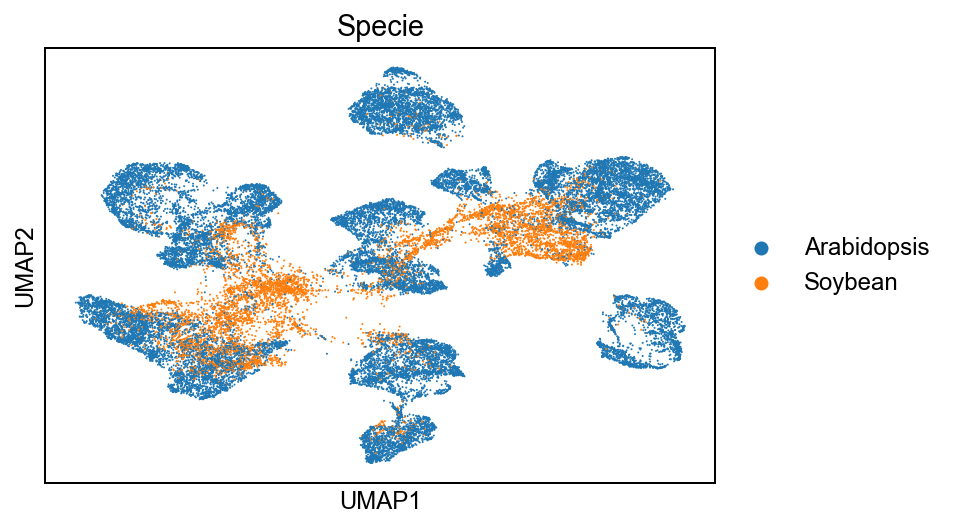

In [ ]:
_dt = {'arabidopsis': 'Arabidopsis', 'soybean':'Soybean'}
ad_integrated.obs['Specie'] = ad_integrated.obs['specie'].map(_dt)
sc.pl.umap(ad_integrated, color='Specie', )

In [ ]:
ad_root.obs["labelTransfer_scanvi_celltype.anno"] = (
    ad_root.obs["labelTransfer_scanvi_celltype.anno"]
    .str.capitalize()
    .astype("category")
    .cat.reorder_categories(
        [
            "Atrichoblast",
            "Cortex",
            "Endodermis",
            "Pericycle",
            "Phloem",
            "Procambium",
            "Trichoblast",
            "Xylem",
            "Unknown",
        ]
    )
)

In [ ]:
ad_integrated.obs['scANVI_results'] = ad_root.obs['labelTransfer_scanvi_celltype.anno'] 
ad_root.obs['Cluster'] = ad.obs['Cluster']
ad_integrated.obs['Cluster'] = ad.obs['Cluster'] 

Trying to set attribute `.uns` of view, copying.


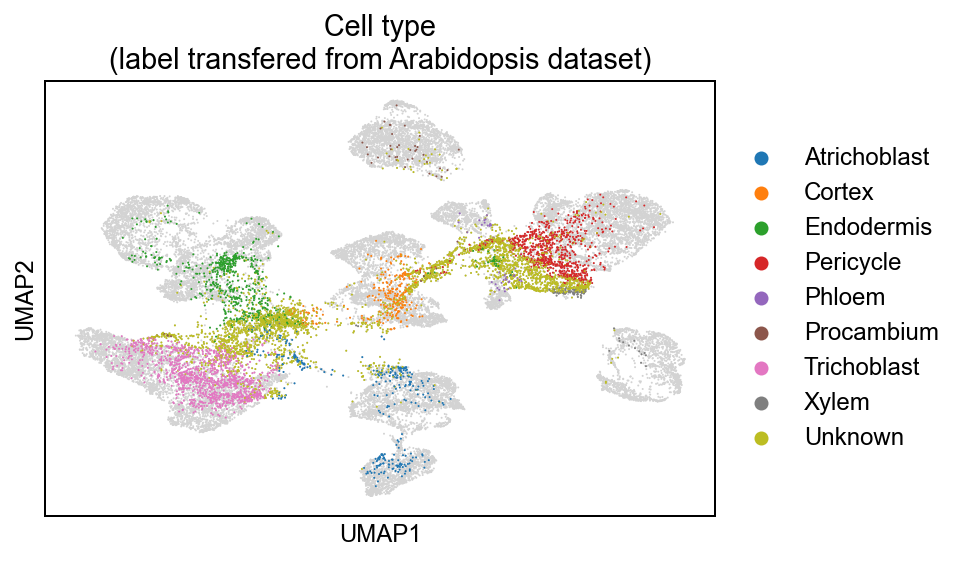

Trying to set attribute `.uns` of view, copying.


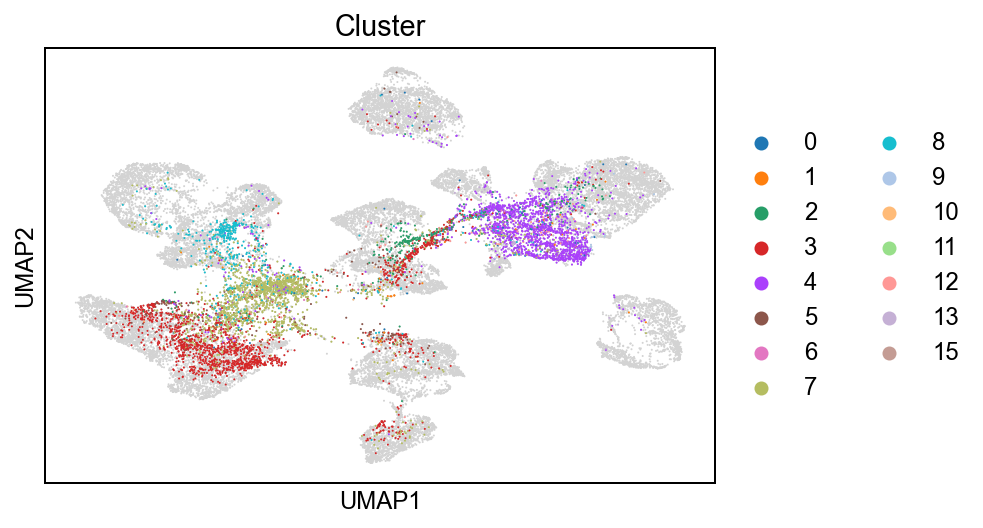

In [ ]:
_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    color="scANVI_results",
    size=12e4 / len(ad_integrated),
)
plt.show()

_ad = ad_integrated[ad_integrated.obs.eval("Specie == 'Soybean'")]
ax = sc.pl.umap(ad_integrated, show=False)
sc.pl.umap(
    _ad,
    show=False,
    ax=ax,
    color="Cluster",
    size=12e4 / len(ad_integrated),
)
plt.show()

In [ ]:
ad_root = loadPkl(
    "ad_root",
    dir_path="/public/home/liuzj/projects/singleCell/02_jupyter/soybean/2021_11_12",
)

<AxesSubplot:title={'center':'Cell type\n(label transfered from Arabidopsis dataset)'}, xlabel='UMAP1', ylabel='UMAP2'>

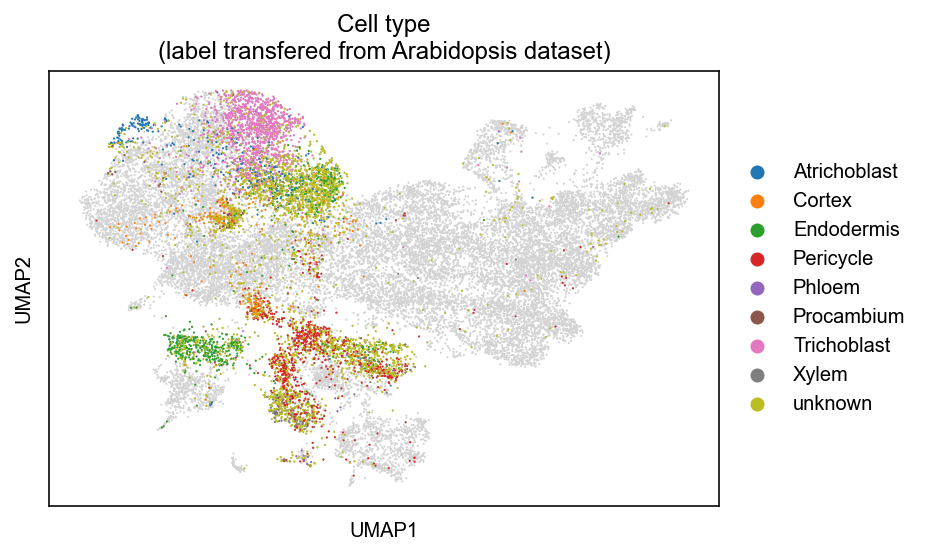

In [ ]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_scanvi_celltype.anno",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [ ]:
_dt = {
    "Atrichoblast": "Epidermis",
    "Pericycle": "Stele",
    "Phloem": "Stele",
    "Procambium": "Stele",
    "Trichoblast": "Epidermis",
    "Xylem": "Stele",
    "unknown": "Unknown",
}

In [ ]:
ad_root.obs["labelTransfer_results"] = ad_root.obs[
    "labelTransfer_scanvi_celltype.anno"
].map(lambda x: _dt.get(x, x))

In [ ]:
# ad_root.uns['labelTransfer_results_colors'] = ['#FBB03B', '#F77D0E', '#8C5552', '#B5C3E2', '#808080']

In [ ]:
_dt = singleCellTools.basic.getadataColor(ad_root, 'labelTransfer_results')
_dt['Unknown'] = '#808080'
singleCellTools.basic.setadataColor(ad_root, 'labelTransfer_results', _dt);

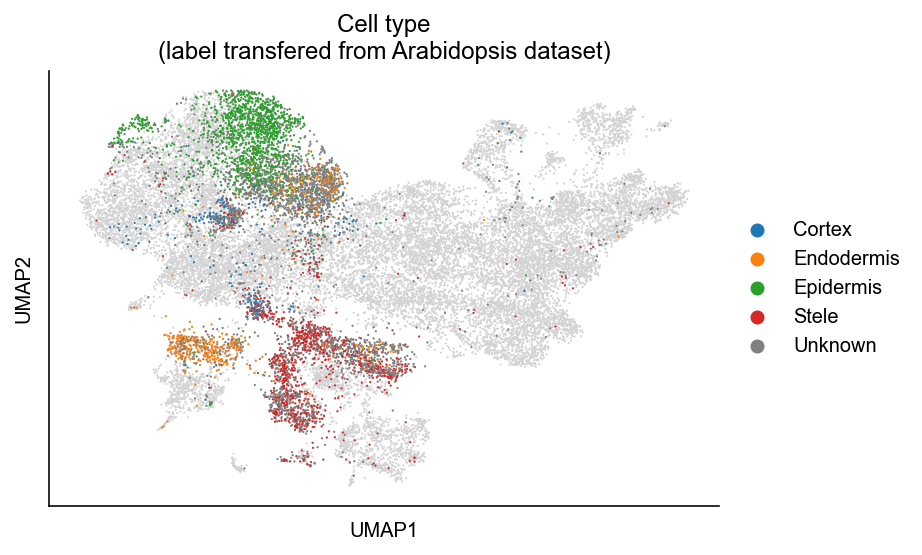

In [ ]:
ax = sc.pl.umap(ad, show=False)
sc.pl.umap(
    ad_root,
    color="labelTransfer_results",
    ax=ax,
    size=12e4 / len(ad),
    title="Cell type\n(label transfered from Arabidopsis dataset)",
    show=False
)
sns.despine()
# plt.legend(ncol=4, frameon=False, bbox_to_anchor=(0,1))

In [ ]:
# ad.obs['labelTransfer_scanvi_celltype.anno'] = ad_integrated.obs['labelTransfer_scanvi_celltype.anno']
# ad.obs['labelTransfer_scanvi_time.celltype.anno'] = ad_integratedZone.obs['labelTransfer_scanvi_time.celltype.anno']

In [ ]:
ad_root.obs['Cluster'] = ad.obs['Cluster']

In [ ]:
ad_root.obs['Cluster'].value_counts().loc[lambda x:x >= 100].index.to_list()

['3', '6', '5', '8', '2', '10', '4', '13']

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

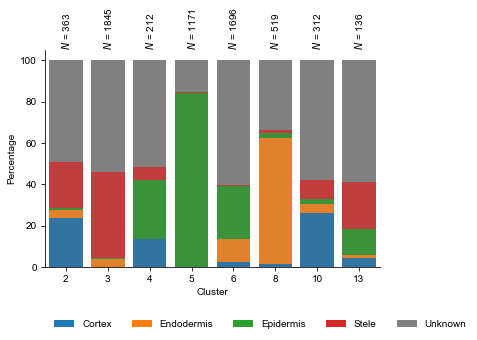

In [ ]:
_ls = ad_root.obs["Cluster"].value_counts().loc[lambda x: x >= 100].index.to_list()
_ad = ad_root[ad_root.obs.eval("Cluster in @_ls")]
singleCellTools.plotting.plotLabelPercentageInCluster(
    _ad, "Cluster", "labelTransfer_results", dt_kwargsForLegend=dict(ncol=5, loc='upper left', bbox_to_anchor=(0,-0.2))
)

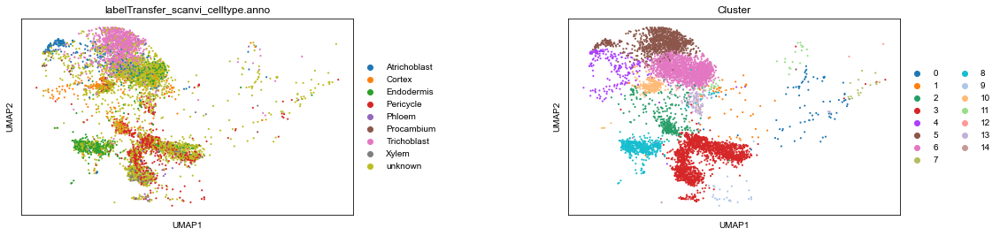

In [ ]:
sc.pl.umap(ad_root, color=['labelTransfer_scanvi_celltype.anno', 'Cluster'], wspace=0.5,)

# test clustering resolution

In [ ]:
import tqdm
import sklearn.metrics

In [ ]:
ad_forClusteringTest = ad.copy()

In [ ]:
for res in tqdm.tqdm(np.linspace(0, 1.5, 16)):
    res= f"{res:.1f}" >> F(float)
    sc.tl.leiden(ad_forClusteringTest, resolution=res, key_added=f"leiden_{res}")

100%|██████████| 16/16 [01:31<00:00,  5.72s/it]


In [ ]:
dt_silhouette_score = {}
for res in tqdm.tqdm(np.linspace(0, 1.5, 16)):
    if res == 0:
        continue
    res= f"{res:.1f}" >> F(float)
    dt_silhouette_score[res] = sklearn.metrics.silhouette_score(ad_forClusteringTest.obsm['X_scvi'], ad_forClusteringTest.obs[f"leiden_{res}"], random_state = 39)

100%|██████████| 16/16 [04:22<00:00, 16.42s/it]


In [ ]:
ad_rootKnownByAra = ad_root[ad_root.obs.eval("labelTransfer_results != 'Unknown'")]

In [ ]:
dt_ami = {}
for res in np.linspace(0, 1.5, 16):
    res= f"{res:.1f}" >> F(float)
    dt_ami[res >> F(str)] = sklearn.metrics.adjusted_mutual_info_score(ad_rootKnownByAra.obs['labelTransfer_results'], ad_forClusteringTest[ad_rootKnownByAra.obs.index].obs[f"leiden_{res}"] )

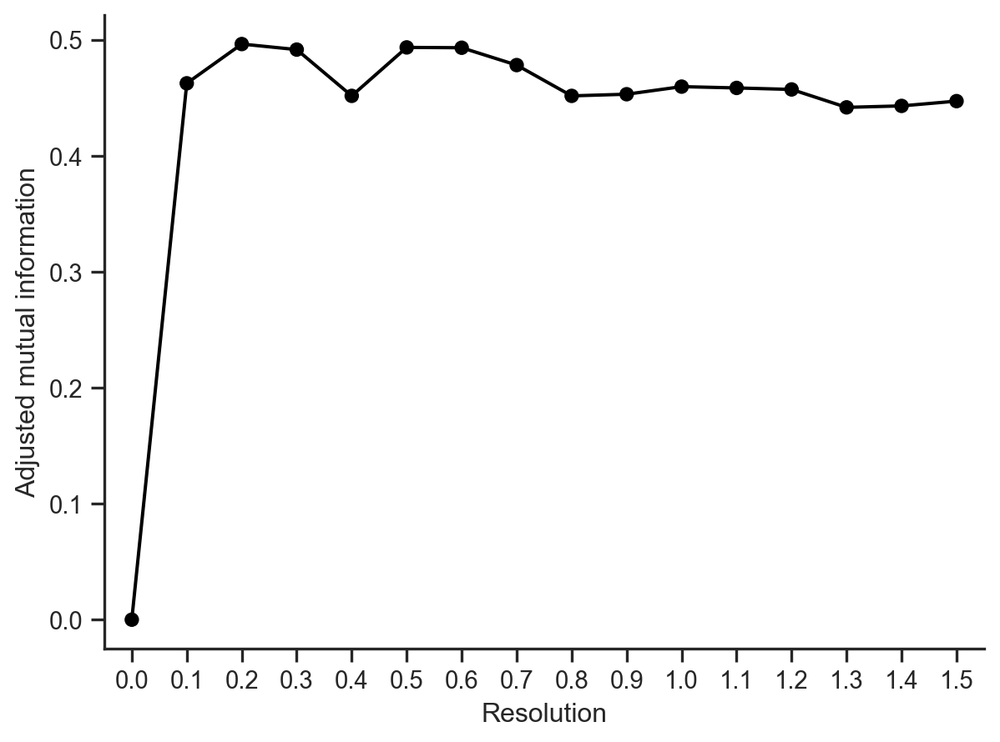

In [ ]:
(
    so.Plot(x=dt_ami.keys(), y=dt_ami.values())
    .add(so.Line(color='Black'))
    .add(so.Dot(color='Black'))
    .theme(dt_snsStyle)
    .label(x='Resolution', y='Adjusted mutual information')
)

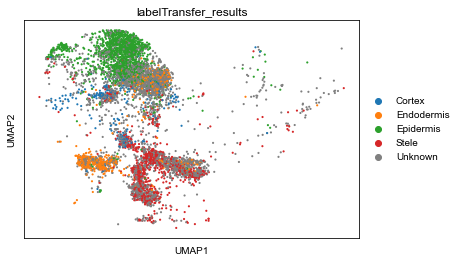

In [ ]:
sc.pl.umap(ad_root, color='labelTransfer_results')

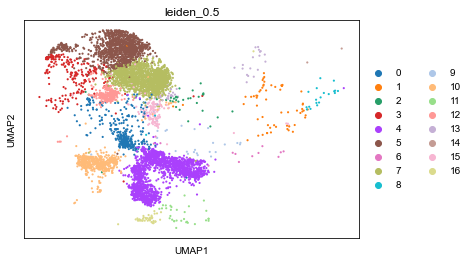

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.5')

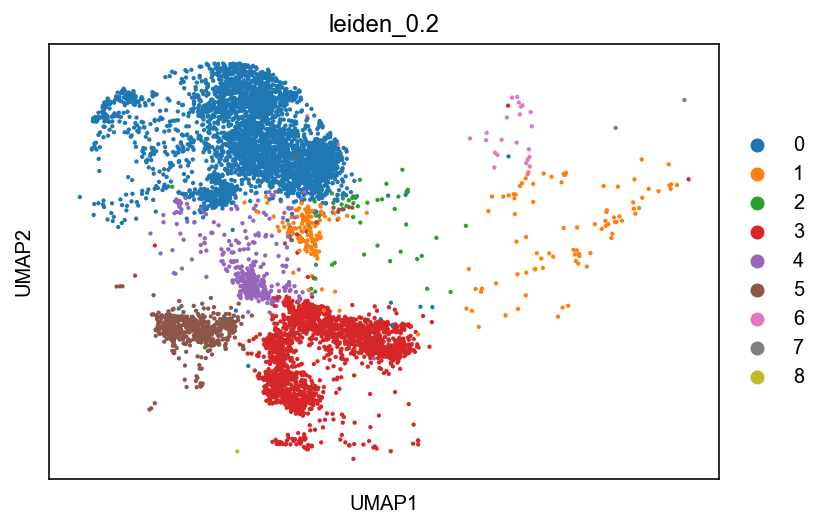

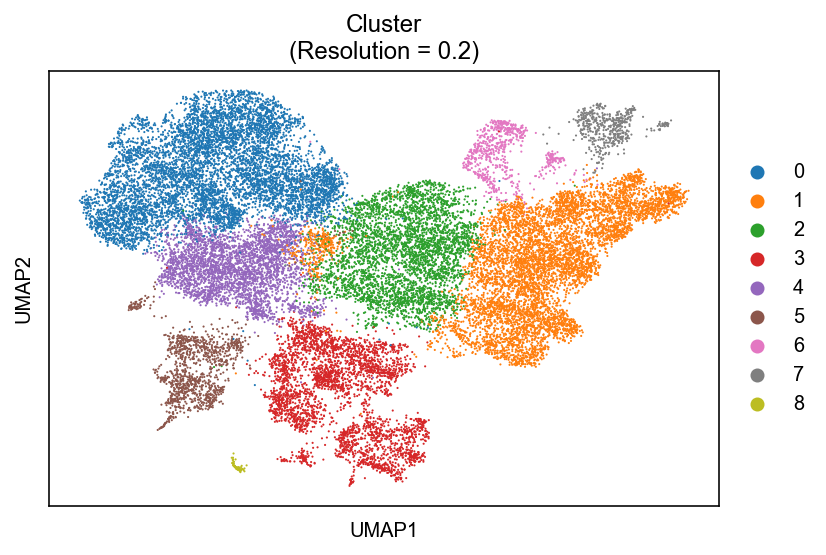

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.2')
sc.pl.umap(ad_forClusteringTest, color='leiden_0.2', title='Cluster\n(Resolution = 0.2)')

In [ ]:
ad_forClusteringTest.uns['leiden_0.3_colors'] = ad.uns['Cluster_colors']

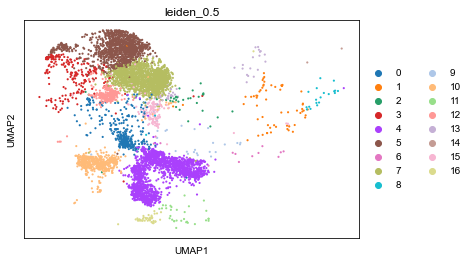

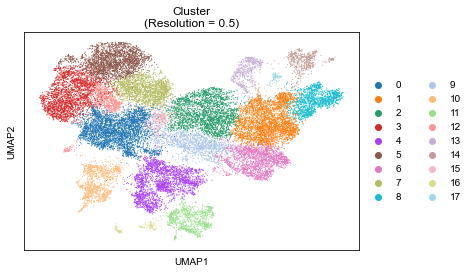

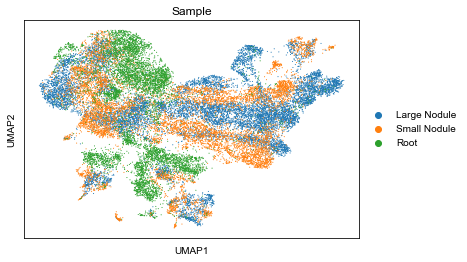

In [ ]:
sc.pl.umap(ad_root, color='leiden_0.5')
sc.pl.umap(ad_forClusteringTest, color='leiden_0.5',  title='Cluster\n(Resolution = 0.5)')

sc.pl.umap(ad_forClusteringTest, color='Sample')

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_forClusteringTest, 'raw', 'leiden_0.5', kayAddedPrefix='enrichScore_')

In [ ]:
_dt = ad_forClusteringTest.uns['enrichScore__cellexES'].groupby('leiden_0.5').apply(lambda x: x.sort_values('enrichScore', ascending=False).head(5)['gene'].to_list()).to_dict()

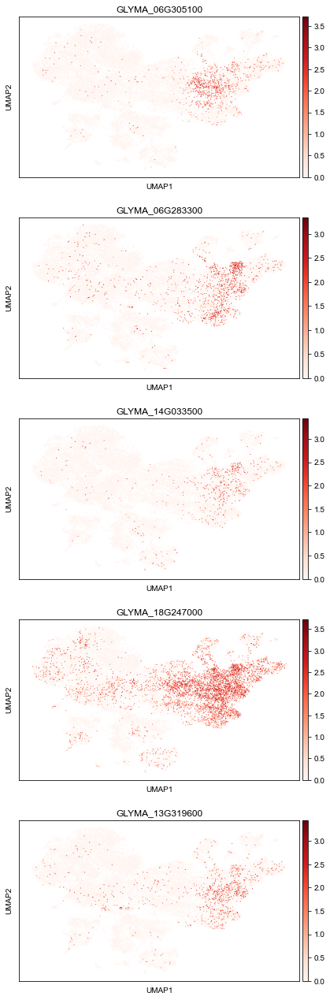

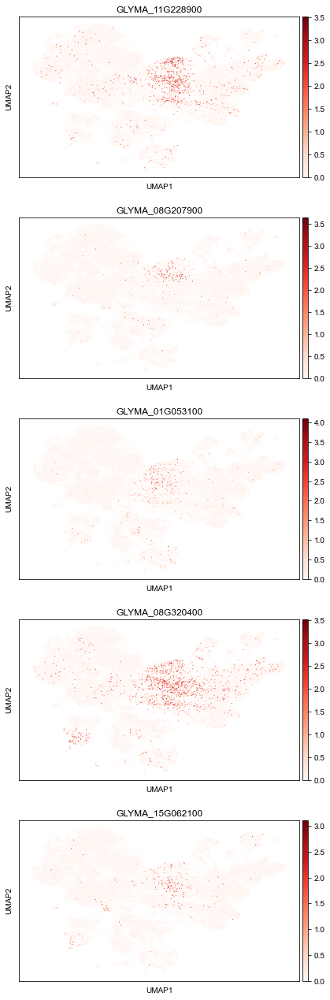

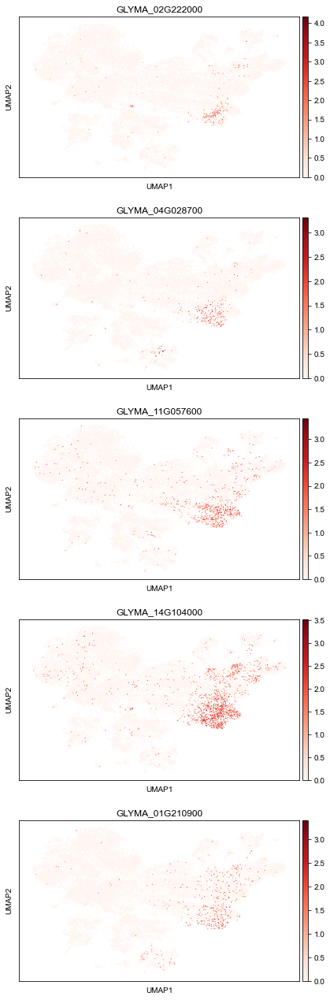

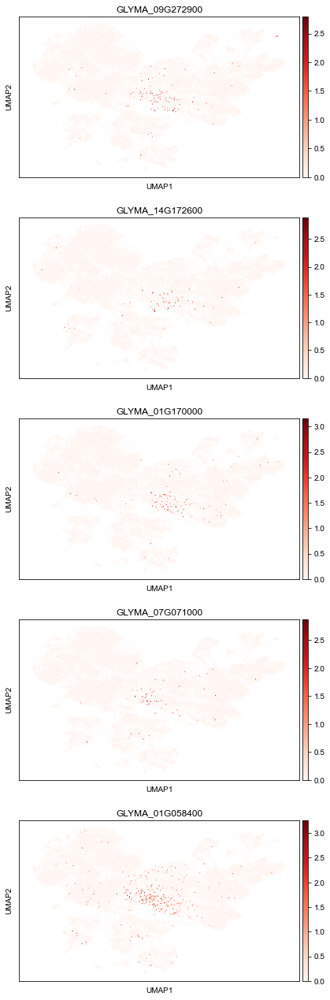

In [ ]:
for c in ['1','2', '6', '9']:
    sc.pl.umap(ad_forClusteringTest, color=_dt[c], ncols=1, layer='normalize_log', cmap='Reds')

# QC test

In [ ]:
import glob

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/step1_cellRanger/"

In [ ]:
ls_sample = ['nodule_large', 'nodule_small', 'root']

In [ ]:
ls_cellrangerH5 = [f"{dir_result}/{x}/{x}/outs/filtered_feature_bc_matrix.h5" for x in ls_sample]

In [ ]:
dir_result = "/public/home/liuzj/projects/singleCell/soybean/02_result/20210922/analysis/noduleWithRoot/"

In [ ]:
ls_ad = [sc.read_10x_h5(x) for x in ls_cellrangerH5]

In [ ]:
ad_raw = sc.concat(ls_ad, label='batch', keys=ls_sample, index_unique='-batch-')

In [ ]:
dt_renameSample = {
    "root": "Root",
    "nodule_large": "Nodule (21 dpi)",
    "nodule_small": "Nodule (12 dpi)",
}

In [ ]:
ad_raw.obs['Sample'] = ad_raw.obs['batch'].map(dt_renameSample).astype('category').cat.set_categories(['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root'])

In [ ]:
sc.pp.filter_genes(ad_raw, min_cells=10)

In [ ]:
singleCellTools.detectDoublet.byScDblFinder(ad_raw, batch_key='batch')

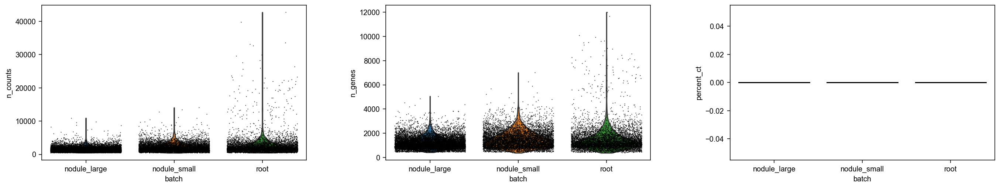

In [ ]:
singleCellTools.plotting.plotCellScatter(ad_raw, batch='batch')

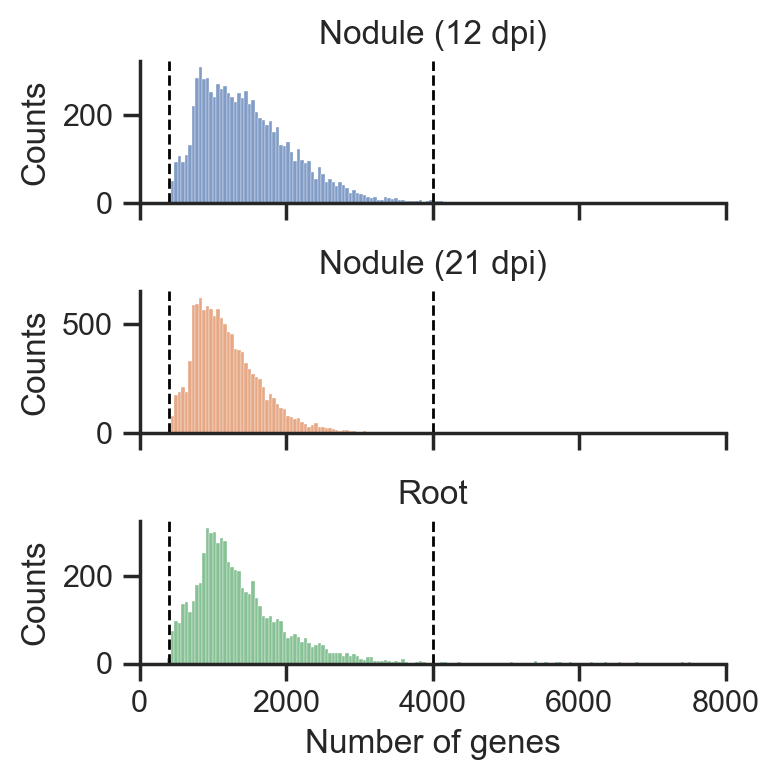

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 8000)), so.Stack(), x='n_genes', color='Sample', legend=False)
    .share(y=False)
    .limit(x=(0, 8000))
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=400, y=[0, 1250], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=4000, y=[0, 1250], orient='y', data={})
    .scale(color='deep')
    .theme(dt_snsStyle)
    .label(x='Number of genes', y='Counts')
    .layout(size=(4,4))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=400, ls='--', color='black', lw=1)
    ax.axvline(x=4000, ls='--', color='black', lw=1)
fig

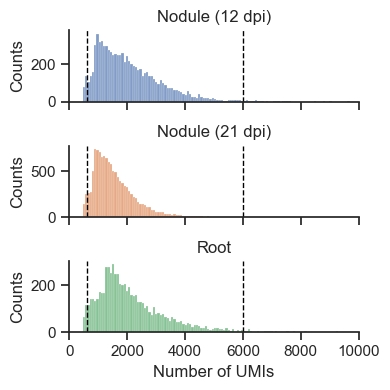

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 10000)), so.Stack(), x='n_counts', color='Sample', legend=False)
    .limit(x=(0, 10000))
    .share(y=False)
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=600, y=[0, 1350], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=6000, y=[0, 1350], orient='y', data={})
    .scale(color='deep')
    .theme(dt_snsStyle)
    .label(x='Number of UMIs', y='Counts')
    .layout(size=(4,4))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=600, ls='--', color='black', lw=1)
    ax.axvline(x=6000, ls='--', color='black', lw=1)
fig

<AxesSubplot:xlabel='Cluster', ylabel='n_counts'>

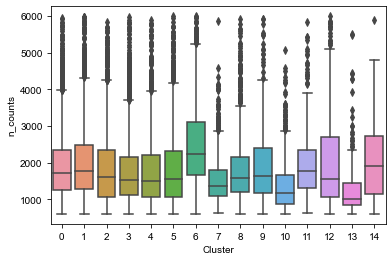

In [ ]:
sns.boxplot(ad.obs, x='Cluster', y='n_counts')

<AxesSubplot:xlabel='Cluster', ylabel='n_genes'>

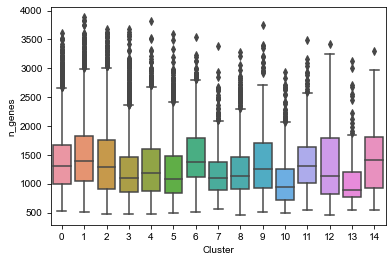

In [ ]:
sns.boxplot(ad.obs, x='Cluster', y='n_genes')

# QC alternative 1

stringent

umi: 800 -- 4000

genes: 600 -- 3000

In [ ]:
dt

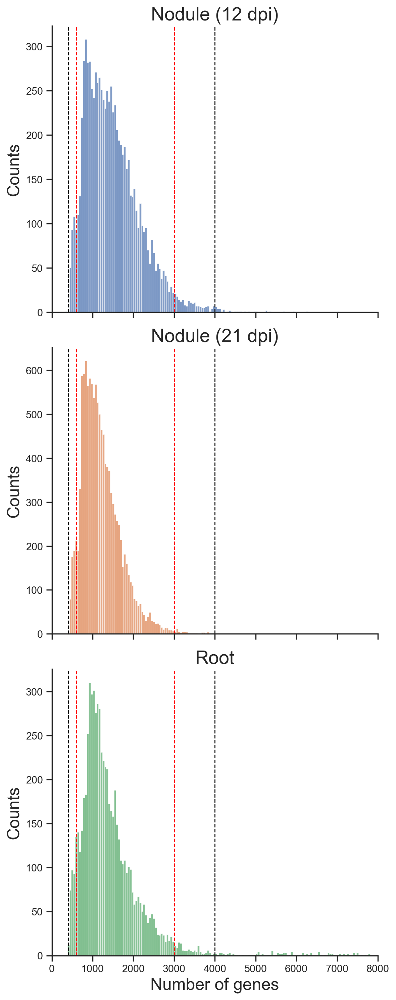

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 8000)), so.Stack(), x='n_genes', color='Sample', legend=False)
    .share(y=False)
    .limit(x=(0, 8000))
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=400, y=[0, 1250], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=4000, y=[0, 1250], orient='y', data={})
    .scale(color='deep')
    .theme({**dt_snsStyle, 'axes.titlesize':20, "axes.labelsize":18})
    .label(x='Number of genes', y='Counts')
    .layout(size=(6,15))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=600, ls='--', color='red', lw=1)
    ax.axvline(x=3000, ls='--', color='red', lw=1)
    ax.axvline(x=400, ls='--', color='black', lw=1)
    ax.axvline(x=4000, ls='--', color='black', lw=1)
fig

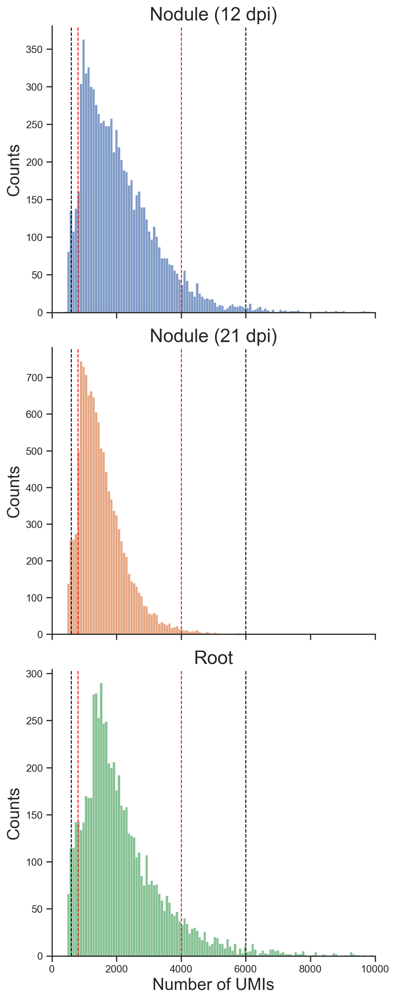

In [ ]:
fig = (
    so.Plot(data=ad_raw.obs)
    .facet(row='Sample')
    .add(so.Bars(), so.Hist(binrange=(0, 10000)), so.Stack(), x='n_counts', color='Sample', legend=False)
    .limit(x=(0, 10000))
    .share(y=False)
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=600, y=[0, 1350], orient='y', data={})
    # .add(so.Line(linestyle='--', color='black', linewidth=1), x=6000, y=[0, 1350], orient='y', data={})
    .scale(color='deep')
    .theme({**dt_snsStyle, 'axes.titlesize':20, "axes.labelsize":18})
    .label(x='Number of UMIs', y='Counts')
    .layout(size=(6,15))
    .plot()._figure
)
axs = fig.axes
for ax in axs:
    ax.axvline(x=800, ls='--', color='red', lw=1)
    ax.axvline(x=4000, ls='--', color='red', lw=1)
    ax.axvline(x=600, ls='--', color='black', lw=1)
    ax.axvline(x=6000, ls='--', color='black', lw=1)
fig

In [ ]:
ad_qc1 = ad_raw[ad_raw.obs.eval("600 < n_genes < 3000 & 800 < n_counts < 4000")]

In [ ]:
ad_qc1.obs.value_counts("batch")

batch
nodule_large    10980
nodule_small     7293
root             5582
dtype: int64

In [ ]:
ad_qc1.layers['raw'] = ad_qc1.X.copy()

In [ ]:
sc.pp.highly_variable_genes(ad_qc1, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad_qc1forScvi = singleCellTools.basic.getPartialLayersAdata(ad_qc1, 'raw', ['batch'], ['highly_variable'])
ad_qc1forScvi = ad_qc1forScvi[:, ad_qc1forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_qc1forScvi, 'ad_qc1forScvi', 'scem')

2022-09-23 17:27:31.062 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_qc1forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0


In [ ]:
# run on scem

# scvi.model.SCVI.setup_anndata(
#     ad_qc1forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 24

# model = scvi.model.SCVI(ad_qc1forScvi)
# model.train()
# ad_qc1forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_qc1forScvi).copy()

# toPkl(ad_qc1forScvi, 'ad_qc1forScvi', 'ipf')

In [ ]:
ad_qc1forScvi = loadPkl('ad_qc1forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

In [ ]:
sc.pp.neighbors(ad_qc1forScvi, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad_qc1forScvi)

In [ ]:
ad_qc1forScvi.obs['Cluster'] = ad.obs['Cluster']
ad_qc1forScvi.obs['leiden_R'] = ad.obs['leiden_R']

In [ ]:
ad_qc1forScvi

AnnData object with n_obs × n_vars = 23855 × 5000
    obs: 'batch', '_scvi_batch', '_scvi_labels', 'Cluster', 'leiden_R'
    var: 'highly_variable'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'neighbors', 'umap'
    obsm: 'X_scvi', 'X_umap'
    obsp: 'distances', 'connectivities'

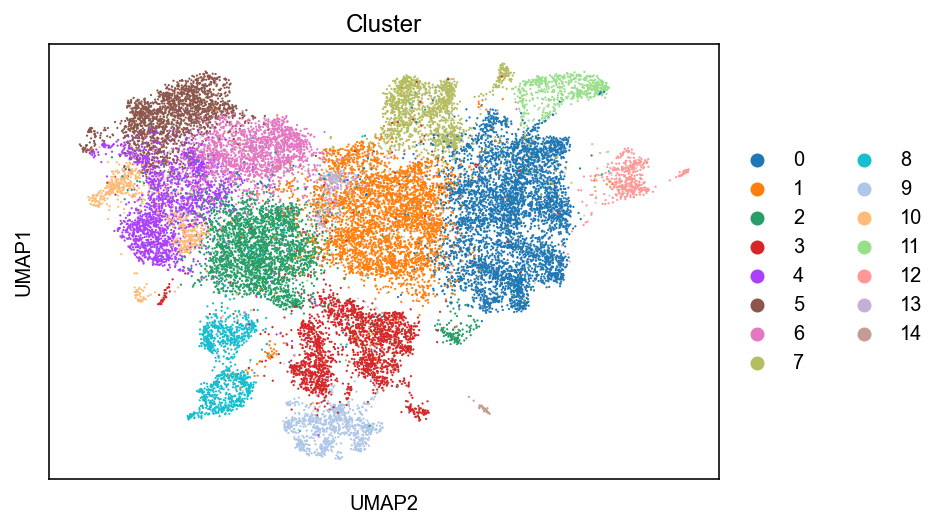

In [ ]:
ax = sc.pl.umap(ad_qc1forScvi, color='Cluster', show=False, na_in_legend=False, components=('2,1'))
# ax.invert_yaxis()
# ax.invert_xaxis()
plt.show()

In [ ]:
ad_qc1forScvi.uns['Cluster_colors'] = ad.uns['Cluster_colors']

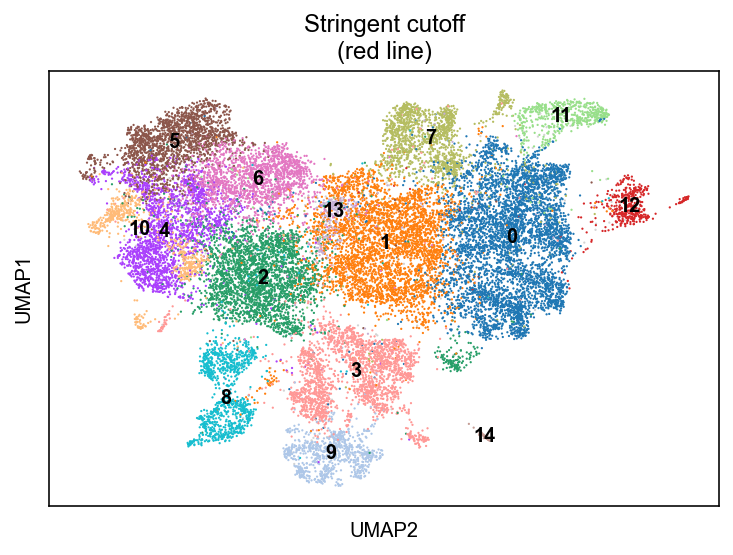

In [ ]:
sc.pl.umap(ad_qc1forScvi, color='Cluster', show=False, na_in_legend=False, components=('2,1'), legend_loc='on data', title='Stringent cutoff\n(red line)')
plt.show()
# ax.invert_yaxis()

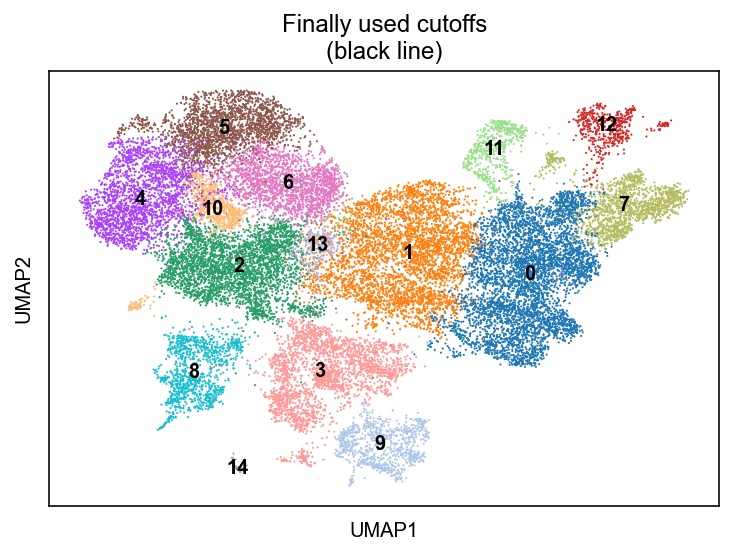

In [ ]:
sc.pl.umap(ad, color = 'Cluster', legend_loc='on data', title='Finally used cutoffs\n(black line)')

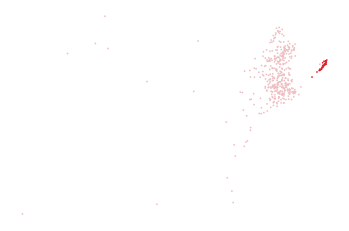

In [ ]:
ax = sc.pl.umap(
    ad_qc1forScvi[ad_qc1forScvi.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12, components=('2,1')
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

plt.show()

# QC alternative 2

NO further QC

In [ ]:
ad_qc2 = ad_raw.copy()

In [ ]:
ad_qc2.layers['raw'] = ad_qc2.X.copy()

In [ ]:
sc.pp.highly_variable_genes(ad_qc2, layer='raw', batch_key='batch', n_top_genes=5000, flavor='seurat_v3')

In [ ]:
ad_qc2forScvi = singleCellTools.basic.getPartialLayersAdata(ad_qc2, 'raw', ['batch'], ['highly_variable'])
ad_qc2forScvi = ad_qc2forScvi[:, ad_qc2forScvi.var['highly_variable']].copy()

In [ ]:
toPkl(ad_qc2forScvi, 'ad_qc2forScvi', 'scem')

2022-09-23 19:17:57.778 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_qc2forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


0


In [ ]:
# run on scem

# scvi.model.SCVI.setup_anndata(
#     ad_qc2forScvi,
#     batch_key='batch'
# )

# scvi.settings.seed = 39
# scvi.settings.num_threads = 24

# model = scvi.model.SCVI(ad_qc2forScvi)
# model.train()
# ad_qc2forScvi.obsm['X_scvi'] = model.get_latent_representation(ad_qc2forScvi).copy()

# toPkl(ad_qc2forScvi, 'ad_qc2forScvi', 'ipf')

In [ ]:
ad_qc2forScvi = loadPkl('ad_qc2forScvi', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

In [ ]:
sc.pp.neighbors(ad_qc2forScvi, use_rep='X_scvi')

In [ ]:
sc.tl.umap(ad_qc2forScvi)

In [ ]:
ad_qc2forScvi.obs['Cluster'] = ad.obs['Cluster']
ad_qc2forScvi.obs['leiden_R'] = ad.obs['leiden_R']

In [ ]:
ad_qc2forScvi.uns['Cluster_colors'] = ad.uns['Cluster_colors']

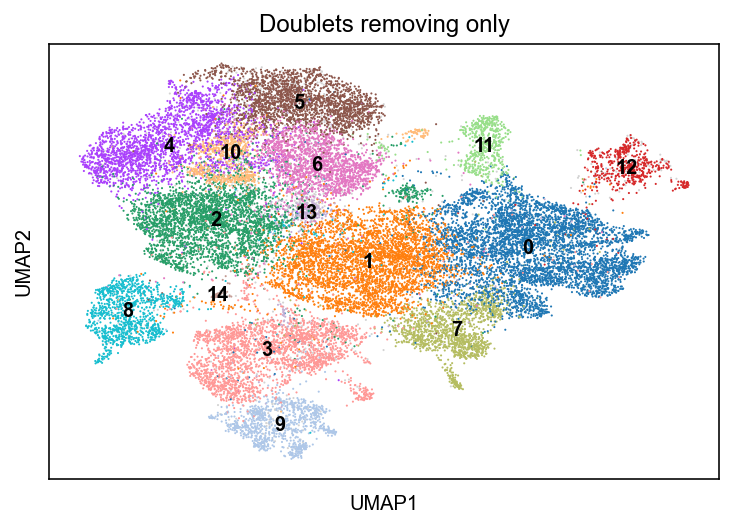

In [ ]:
ax = sc.pl.umap(ad_qc2forScvi, color='Cluster', legend_loc='on data', title='Doublets removing only', show=False, na_in_legend=False)
ax.invert_yaxis()
plt.show()

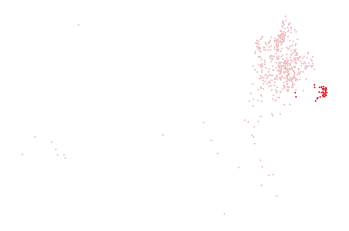

In [ ]:
ax = sc.pl.umap(
    ad_qc2forScvi[ad_qc2forScvi.obs.eval("Cluster in ['12']")],
    color="leiden_R", show=False, palette=['#EEBFC2', '#DE1E2A'], legend_loc=None,size=12
)
sns.despine(left=True, bottom=True)
plt.title('')
plt.xlabel('')
plt.ylabel('')

ax.invert_yaxis()
# ax.invert_xaxis()
plt.show()

## spatial

### deconvolution

In [ ]:
ad_st = loadPkl('ad_afterTissueCut_polished', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [ ]:
ad_sc = sc.read_h5ad(f"{dir_result}/ad_20220311.v1.h5ad")
ad_scNodule = ad_sc[ad_sc.obs.eval("Sample != 'Root'")].copy()

In [ ]:
toPkl(ad_st, 'ad_st', 'scem')
toPkl(ad_scNodule, 'ad_scNodule', 'scem')

In [ ]:
# scem :

# ad_st = loadPkl('ad_st', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')
# ad_scNodule = loadPkl('ad_scNodule', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')

# ls_keepCluster = ad_scNodule.obs['Cluster'].value_counts().pipe(lambda sr:sr[sr > 500].index.to_list())
# ad_scNoduleFiltered = ad_scNodule[ad_scNodule.obs.eval("Cluster in @ls_keepCluster")]

# singleCellTools.spatialTools.getClusterScoreFromScDataByDestvi(
#     ad_st,
#     ad_scNoduleFiltered,
#     clusterKey="Cluster",
#     nFeatures=3000,
#     condScviEpoch=1000, 
#     destviEpoch=4000, 
#     minUmiCountsInStLayer = 10, 
#     batchSize=1024, hvgLabel='Sample',  
#     hvgScDataOnly=True,
#     # dt_condScviConfigs={'n_layers':4},
# )
# toPkl(ad_st, 'ad_st_afterDeconvolution', 'ipf')

In [ ]:
ad_st = loadPkl('ad_st_afterDeconvolution', lambda **dt:sc.read_h5ad(**dt), arg_path='filename',  dir_path=dir_result)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


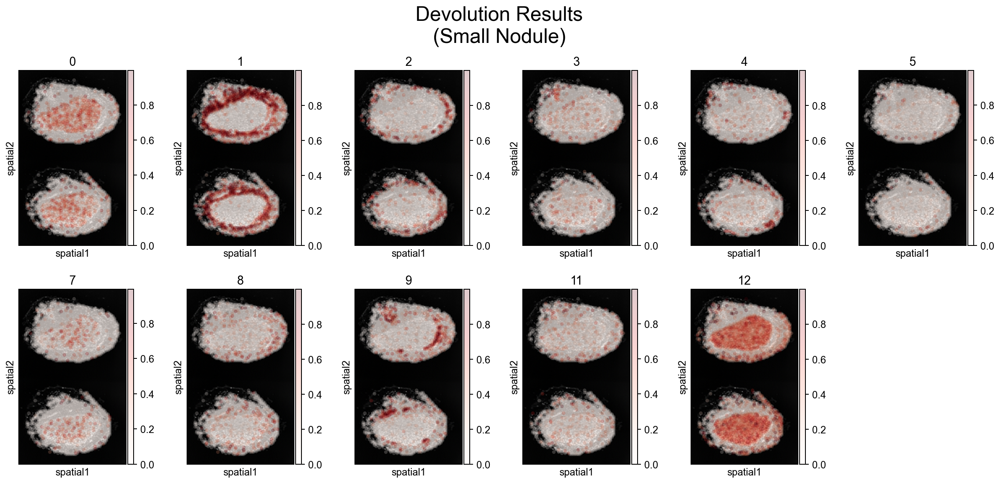

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stSm, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.2,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Small Nodule)", x=0.45, y=1.02, fontsize=24)

... storing 'destVI_results' as categorical
... storing 'destVI_results_merged' as categorical


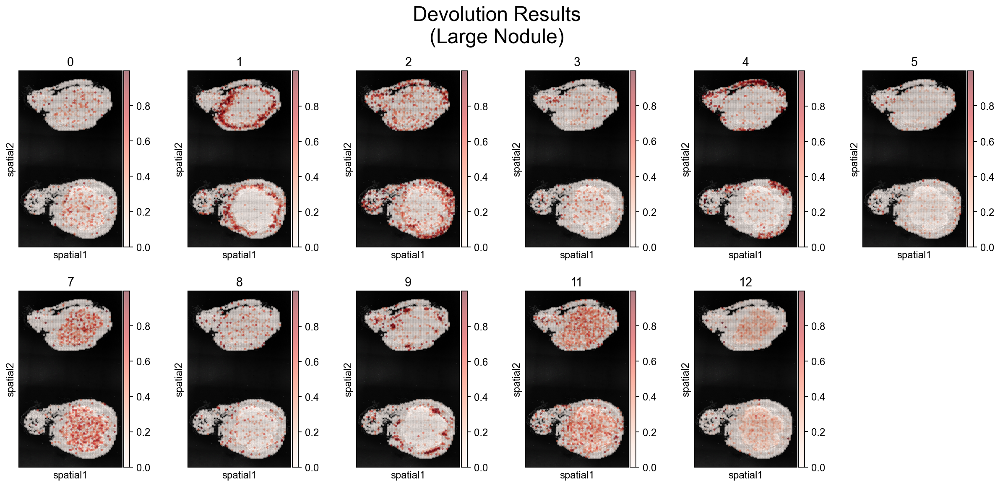

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(_ad_stLg, "proportions"),
        color=ad_st.obsm["proportions"].columns[:-1],
        size=0.2,
        cmap="Reds",
        wspace=0,
        alpha=0.5,
        ncols=6,
        show=False,
    )
    plt.suptitle("Devolution Results\n(Large Nodule)", x=0.45, y=1.02, fontsize=24)

### add cross-cut image

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/st_alignCross_0503.h5ad")

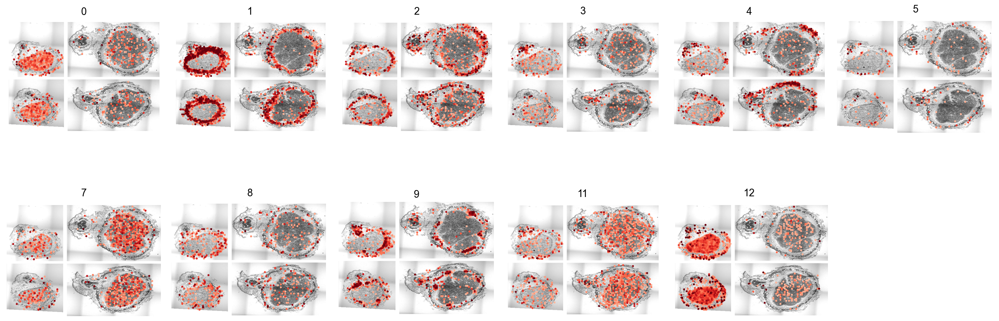

In [ ]:
fig, axs = plt.subplots(2,6, figsize=(20,8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm['proportions'].columns[:-1]
for ax, cluster in zip(axs, ls_useCluster):
#     sc.pl.spatial(
#         ad_align,
#         size=0.075,
#         ax=ax,show=False,img_key="cross"
#     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap='Reds',
        vmin=0, vmax=1,colorbar_loc=None,show=False,img_key="cross"
    )
#     ax.invert_yaxis()
    sns.despine(left=True, bottom=True)
    plt.sca(ax)
    plt.xlabel('')
    plt.ylabel('')
axs[-1].set_visible(False)
plt.tight_layout()
plt.show()

In [ ]:
# ad_stAlign.write_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Endodermis",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:y.rstrip('*') for x,y in dt_cluster2Tissue.items()}
dt_cluster2Tissue = {x:f"{x}\n({y})" for x,y in dt_cluster2Tissue.items()}

Text(0.5, 1.0, '12\n(Infected cells)')

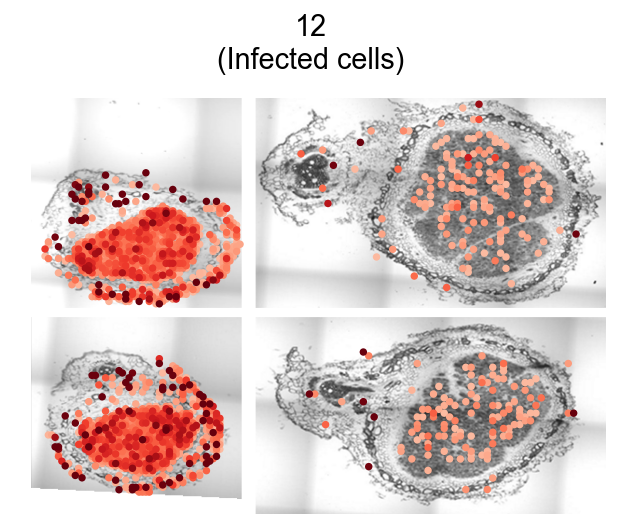

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
_ad = _ad[_ad.obs[cluster] > 0.25]
ax = sc.pl.spatial(
    _ad,
    color=cluster,
    size=0.2,
    cmap="Reds",
    vmin=0,
    vmax=1,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)[0]
#     ax.invert_yaxis()
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")
plt.title(dt_cluster2Tissue[ax.get_title()])

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
ax.get_xlim(), ax.get_ylim()


((-18.346480678304268, 617.3859695561097),
 (447.6898209228389, -19.078977186801858))

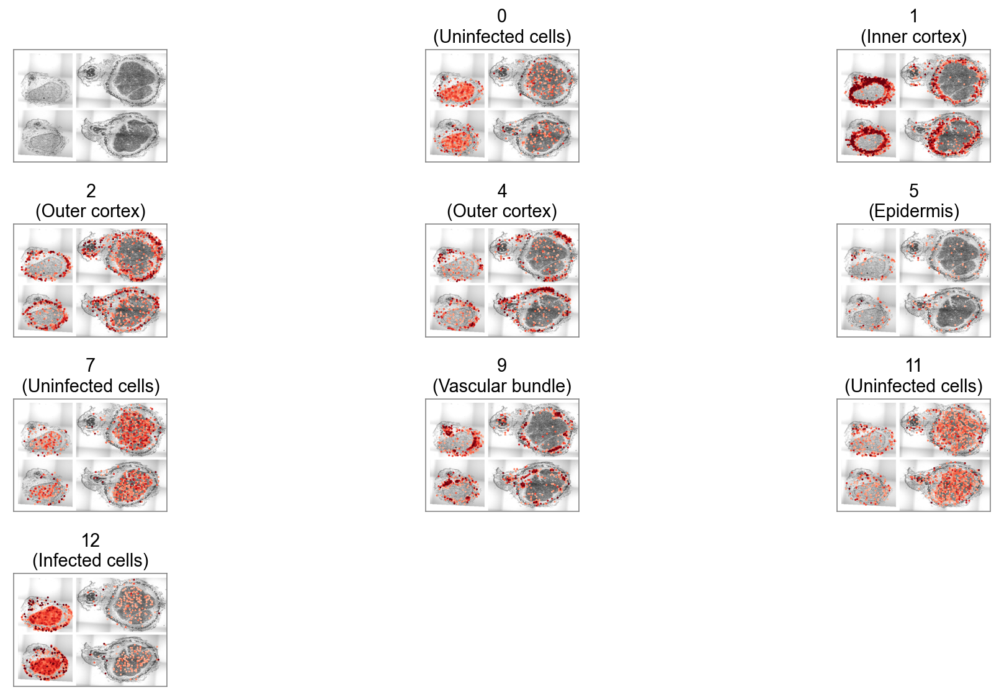

In [ ]:
fig, axs = plt.subplots(4, 3, figsize=(14, 8))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs[1:], [x for x in ls_useCluster if x not in ['3', '8']]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
    plt.title(dt_cluster2Tissue[ax.get_title()])
ax = axs[0]
plt.sca(ax)
sc.pl.spatial(
    _ad,
    ax=axs[0],
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
ax.spines['top'].set_color('grey') 
ax.spines['right'].set_color('grey')
ax.spines['bottom'].set_color('grey')
ax.spines['left'].set_color('grey')
plt.xlabel("")
plt.ylabel("")
plt.xlim(-18.346480678304268, 617.3859695561097)
plt.ylim(447.6898209228389, -19.078977186801858)

axs[-2].remove()
axs[-1].remove()
plt.tight_layout()
plt.show()

In [ ]:
from itertools import cycle

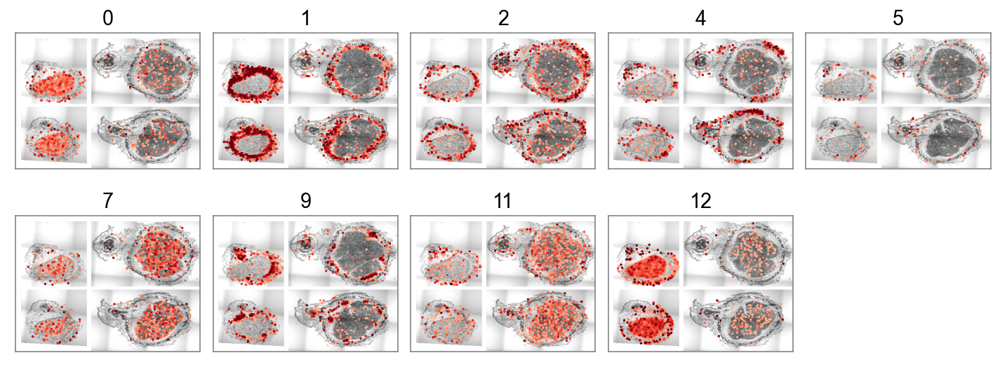

In [ ]:
colWidth = 0.115
fig, axs = plt.subplots(2, 5, figsize=(17, 4))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs, [x for x in ls_useCluster if x not in ['3', '8']]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
#     plt.title(dt_cluster2Tissue[ax.get_title()])
plt.tight_layout()
for ax, icol in zip(axs, cycle([0,1,2,3,4])):
    pos = ax.get_position()
    ax.set_position([colWidth * icol, pos.y0, pos.x1 - pos.x0, pos.y1-pos.y0])
axs[-1].remove()
plt.show()

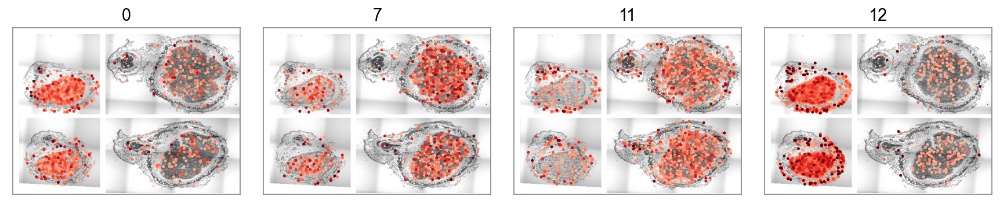

In [ ]:
colWidth = 0.25
fig, axs = plt.subplots(1, 4, figsize=(12, 3))
axs = axs.reshape(-1)
ls_useCluster = ad_stAlign.obsm["proportions"].columns[:-1]
for ax, cluster in zip(axs, [x for x in ["0", "7", "11", "12"]]):
    #     sc.pl.spatial(
    #         ad_align,
    #         size=0.075,
    #         ax=ax,show=False,img_key="cross"
    #     )
    _ad = singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions")
    _ad = _ad[_ad.obs[cluster] > 0.25]
    sc.pl.spatial(
        _ad,
        color=cluster,
        size=0.2,
        ax=ax,
        cmap="Reds",
        vmin=0,
        vmax=1,
        colorbar_loc=None,
        show=False,
        img_key="cross",
    )
    #     ax.invert_yaxis()
    plt.sca(ax)
    plt.xlabel("")
    plt.ylabel("")
    plt.xlim(-18.346480678304268, 617.3859695561097)
    plt.ylim(447.6898209228389, -19.078977186801858)
    ax.spines['top'].set_color('grey') 
    ax.spines['right'].set_color('grey')
    ax.spines['bottom'].set_color('grey')
    ax.spines['left'].set_color('grey')
#     plt.title(dt_cluster2Tissue[ax.get_title()])
plt.tight_layout()
for ax, icol in zip(axs, cycle([0,1,2,3])):
    pos = ax.get_position()
    ax.set_position([colWidth * icol, pos.y0, pos.x1 - pos.x0, pos.y1-pos.y0])
plt.show()

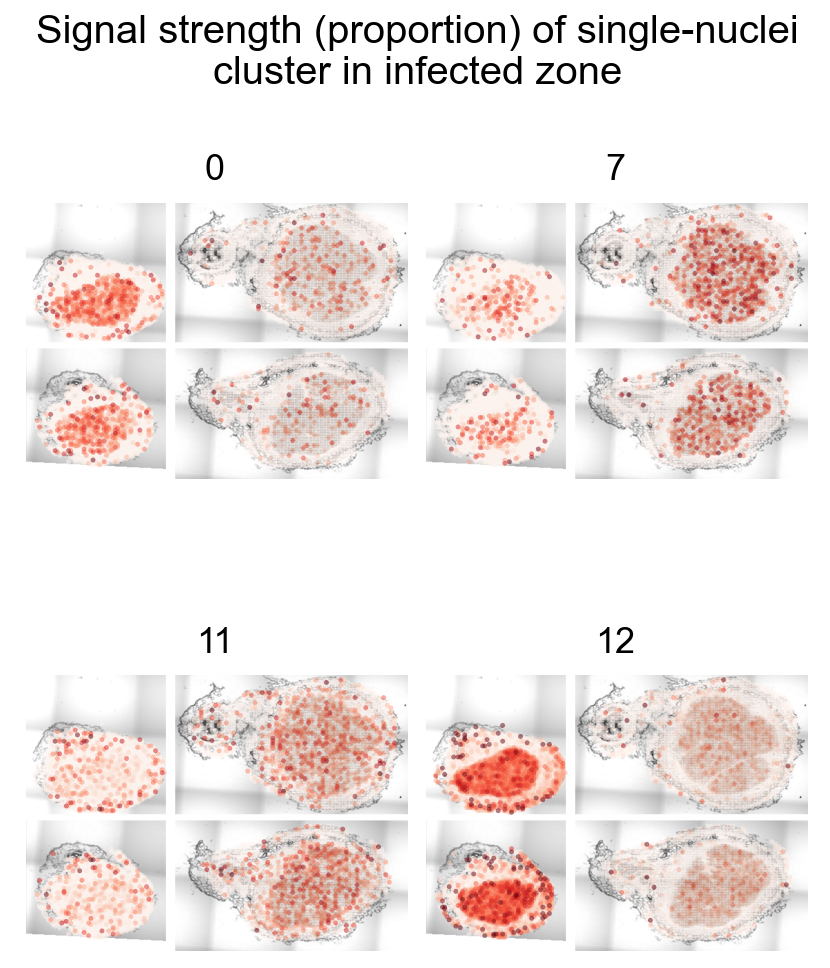

In [ ]:
with plt.rc_context({"figure.figsize": (3.5, 4)}):
    axs = sc.pl.spatial(
        singleCellTools.plotting.obsmToObs(ad_stAlign, "proportions"),
        color=["0", "7", "11", "12"],
        size=0.2,
        cmap="Reds",
        wspace=0,
        hspace=0,
        alpha=0.5,
        ncols=2,
        show=False,
        colorbar_loc=None,
        img_key="cross",
    )
    for ax in axs:
        plt.sca(ax)
        plt.xlabel("")
        plt.ylabel("")
        sns.despine(left=True, bottom=True)
        plt.title(ax.get_title(), fontdict=dict(size=18))
    plt.suptitle(
        "Signal strength (proportion) of single-nuclei\ncluster in infected zone",
        x=0.5,
        y=0.96,
        fontsize=20,
    )
    plt.show()

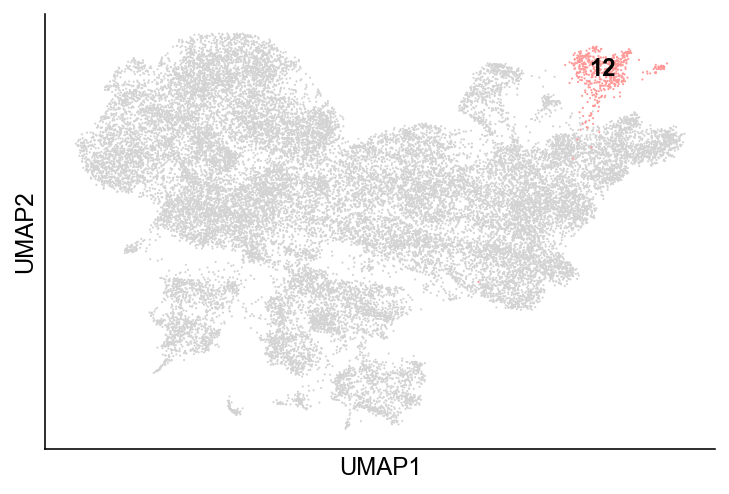

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("")

plt.show()

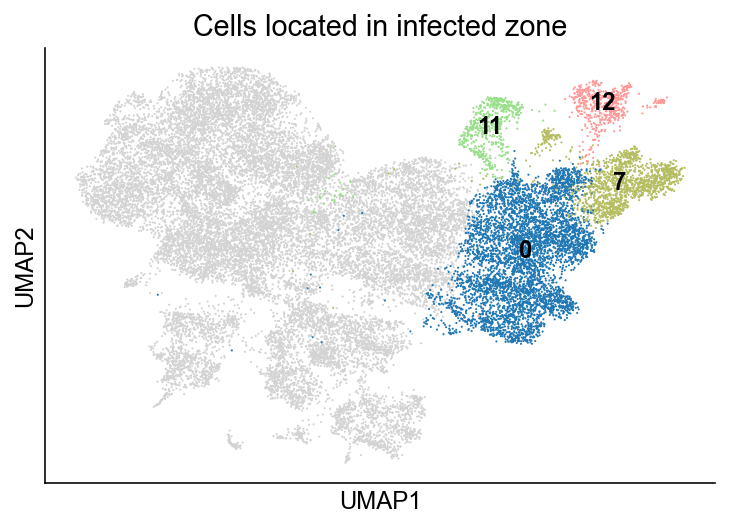

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = ['0', '7', '11', '12']
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, groups = _ls)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False, legend_loc=None)
sns.despine(top=True, right=True)
# plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Cells located in infected zone")
plt.show()

#### figure 1a

In [ ]:
ad_stLarge = ad_stAlign[ad_stAlign.obs.eval("batch == 'lg2'")]

Text(0, 0.5, '')

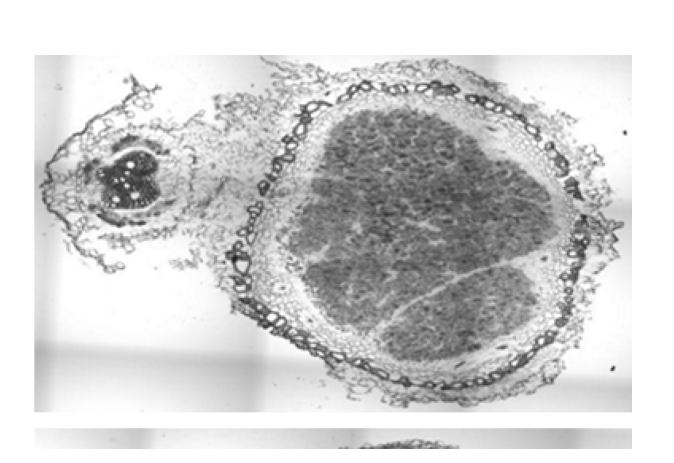

In [ ]:
sc.pl.spatial(
    ad_stLarge,
    colorbar_loc=None,
    show=False,
    img_key="cross",
)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

In [ ]:
dt_mergeStPropotion = {
    "0": ["0", "12", "7", "11"],
    "1": ["1"],
    "2": ["2", "4"],
    "3": ["9"],
}

In [ ]:
def mergePropotion(line):
    
    dt_finalPropotion = {}
    for mergedCluster, ls_elementCluster in dt_mergeStPropotion.items():
        dt_finalPropotion[mergedCluster] = 0
        for element in ls_elementCluster:
            dt_finalPropotion[mergedCluster] += line.at[element]
    return pd.Series(dt_finalPropotion).rename(line.name)
                

In [ ]:
ls_results = []
for _, line in ad_stLarge.obsm["proportions"].iterrows():
    ls_results.append(mergePropotion(line))

In [ ]:
ad_stLarge.obsm['propotion_merged'] = pd.concat(ls_results, axis=1).T

In [ ]:
ad_stLarge.obs['propotion_merged'] = np.where(
    ad_stLarge.obsm["propotion_merged"].max(1) > 0.5,
    ad_stLarge.obsm["propotion_merged"].idxmax(1),
    None,
)

In [ ]:
_dt_color = singleCellTools.basic.getadataColor(ad, 'Cluster')

In [ ]:
singleCellTools.basic.setadataColor(ad_stLarge, 'propotion_merged', _dt_color);

Text(0, 0.5, '')

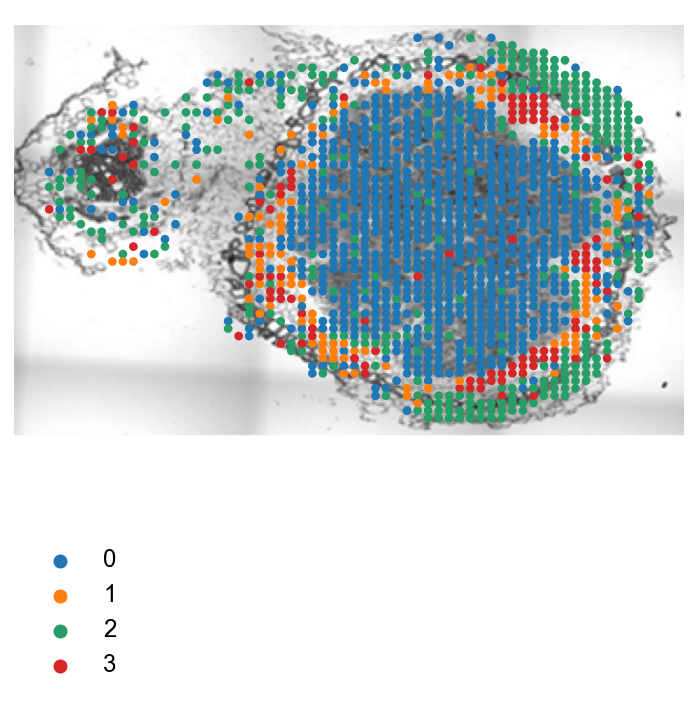

In [ ]:
sc.pl.spatial(
    ad_stLarge,
    color="propotion_merged",
    title='',
    size=0.12,
    show=False,
    img_key="cross", na_in_legend=False
)
plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

# st data clustering

In [ ]:
ad_stAlign = sc.read_h5ad(f"{dir_result}/stAlignedAndCuted.h5ad")

In [ ]:
ad_stAlign.obs['imagecol'] = ad_stAlign.obsm['spatial'][:, 0]
ad_stAlign.obs['imagerow'] = ad_stAlign.obsm['spatial'][:, 1]

In [ ]:
ad_stSm = ad_stAlign[ad_stAlign.obs.eval("Sample == 'Small Nodule'")]
ad_stLg = ad_stAlign[ad_stAlign.obs.eval("Sample == 'Large Nodule'")]

In [ ]:
so_stSm = singleCellTools.normalize.normalizeBySCT_r(ad_stSm)
so_stLg = singleCellTools.normalize.normalizeBySCT_r(ad_stLg)

R[write to console]: Warning:
R[write to console]:  Feature names cannot have underscores ('_'), replacing with dashes ('-')

R[write to console]: Warning:
R[write to console]:  Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_scvi_total_ to umapscvitotal_

R[write to console]: Warning:
R[write to console]:  All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to umapscvitotal_

R[write to console]: Warning:
R[write to console]:  Adding a Graph without an assay associated with it

R[write to console]: Warning:
R[write to console]:  Adding a Graph without an assay associated with it

R[write to console]: vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

R[write to console]: Calculating cell attributes from input UMI matrix: log_umi

R[write to console]: Total Step 1 genes: 21116

R[write to console]: Total overdispersed genes: 20883

R[write to console]: Exclud

  |======================================================================| 100%


R[write to console]: Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

R[write to console]: # of step1 poisson genes (variance < mean): 0

R[write to console]: # of low mean genes (mean < 0.001): 0

R[write to console]: Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

R[write to console]: Total # of poisson genes (theta=Inf; variance < mean): 233

R[write to console]: Calling offset model for all 233 poisson genes

R[write to console]: Ignoring theta inf genes

R[write to console]: Replacing fit params for 233 poisson genes by theta=Inf

R[write to console]: Setting min_variance based on median UMI:  0.16

R[write to console]: Second step: Get residuals using fitted parameters for 21116 genes



  |======================================================================| 100%


R[write to console]: Computing corrected count matrix for 21116 genes



  |======================================================================| 100%


R[write to console]: Calculating gene attributes

R[write to console]: Wall clock passed: Time difference of 1.582168 mins

R[write to console]: Determine variable features

R[write to console]: Place corrected count matrix in counts slot

R[write to console]: Centering data matrix

  |                                                                            
  |                                                                      |   0%
  |                                                                            
  |==                                                                    |   3%
  |                                                                            
  |=====                                                                 |   7%
  |                                                                            
  |=======                                                               |  10%
  |                                                                         

  |======================================================================| 100%


R[write to console]: Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

R[write to console]: # of step1 poisson genes (variance < mean): 0

R[write to console]: # of low mean genes (mean < 0.001): 0

R[write to console]: Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

R[write to console]: Total # of poisson genes (theta=Inf; variance < mean): 280

R[write to console]: Calling offset model for all 280 poisson genes

R[write to console]: Found 1 outliers - those will be ignored in fitting/regularization step


R[write to console]: Ignoring theta inf genes

R[write to console]: Replacing fit params for 280 poisson genes by theta=Inf

R[write to console]: Setting min_variance based on median UMI:  0.04

R[write to console]: Second step: Get residuals using fitted parameters for 15833 genes



  |======================================================================| 100%


R[write to console]: Computing corrected count matrix for 15833 genes



  |======================================================================| 100%


R[write to console]: Calculating gene attributes

R[write to console]: Wall clock passed: Time difference of 1.024059 mins

R[write to console]: Determine variable features

R[write to console]: Place corrected count matrix in counts slot

R[write to console]: Centering data matrix

  |                                                                            
  |                                                                      |   0%
  |                                                                            
  |===                                                                   |   5%
  |                                                                            
  |======                                                                |   9%
  |                                                                            
  |==========                                                            |  14%
  |                                                                         

In [ ]:
ad_stBc = ad_stAlign.copy()

In [ ]:
ad_stSm = ad_stSm[:, ad_stSm.uns["SCT_data_features"] >> F(map, lambda x:x.replace("-", "_")) >> F(list)]
ad_stLg = ad_stLg[:, ad_stLg.uns["SCT_data_features"] >> F(map, lambda x:x.replace("-", "_")) >> F(list)]

In [ ]:
ad_stSm.layers['SCT_counts'] = so_stSm["SCT"].layers['SCT_counts']
ad_stLg.layers['SCT_counts'] = so_stLg["SCT"].layers['SCT_counts']

ad_stSm.layers['SCT_scale.data'] = so_stSm['SCT_scale.data'].layers['SCT_scale.data']
ad_stLg.layers['SCT_scale.data'] = so_stLg['SCT_scale.data'].layers['SCT_scale.data']

In [ ]:
ad_stAlign = sc.concat([ad_stSm, ad_stLg], uns_merge="first")

In [ ]:
n_inducing = 1000

In [ ]:
sc.pp.highly_variable_genes(ad_stAlign, flavor="seurat_v3", n_top_genes=3000, batch_key='Sample', layer='raw')

In [ ]:
mu.tl.mofa(ad_stAlign, groups_label='Sample', n_factors=5, 
           use_layer='SCT_scale.data',
           center_groups=False,
           smooth_covariate=["imagerow", "imagecol"],
           smooth_kwargs={
               "sparseGP": True, "frac_inducing": n_inducing/ad_stAlign.n_obs,
               "start_opt": 10, "opt_freq": 10,
           },
           use_float32=True, seed=39,
           quiet=False)


        #########################################################
        ###           __  __  ____  ______                    ### 
        ###          |  \/  |/ __ \|  ____/\    _             ### 
        ###          | \  / | |  | | |__ /  \ _| |_           ### 
        ###          | |\/| | |  | |  __/ /\ \_   _|          ###
        ###          | |  | | |__| | | / ____ \|_|            ###
        ###          |_|  |_|\____/|_|/_/    \_\              ###
        ###                                                   ### 
        ######################################################### 
       
 
        
use_float32 set to True: replacing float64 arrays by float32 arrays to speed up computations...

Loaded view='data' group='Small Nodule' with N=3574 samples and D=3000 features...
Loaded view='data' group='Large Nodule' with N=4100 samples and D=3000 features...


Model options:
- Automatic Relevance Determination prior on the factors: True
- Automatic Relevance Determination pr

AttributeError: 'AnnData' object has no attribute 'mod'

In [ ]:
ad_stAlign = loadPkl('ad_stAlign_20221008_mefisto', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result)

In [ ]:
sc.pp.neighbors(ad_stAlign, use_rep='X_mofa', n_neighbors=15)
sc.tl.umap(ad_stAlign, 0.3)

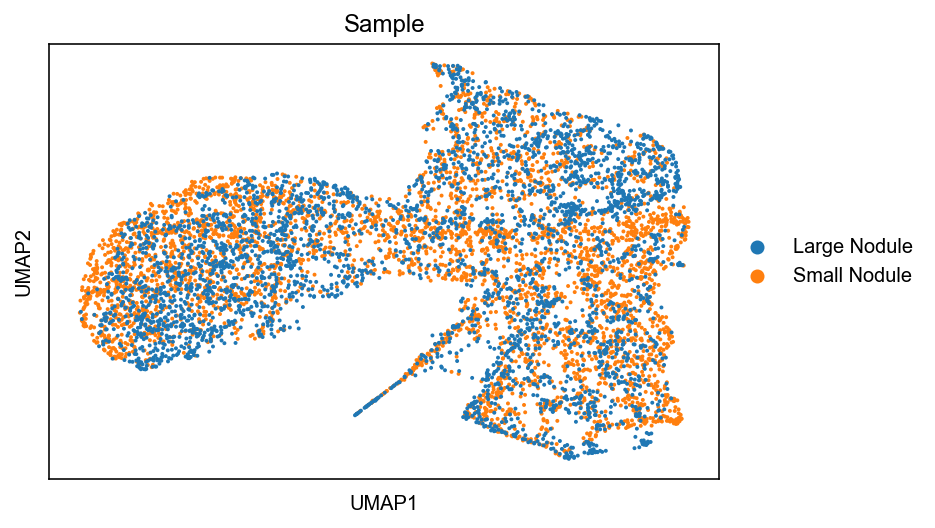

In [ ]:
sc.pl.umap(ad_stAlign, color='Sample')

In [ ]:
sc.tl.leiden(ad_stAlign, 0.2)

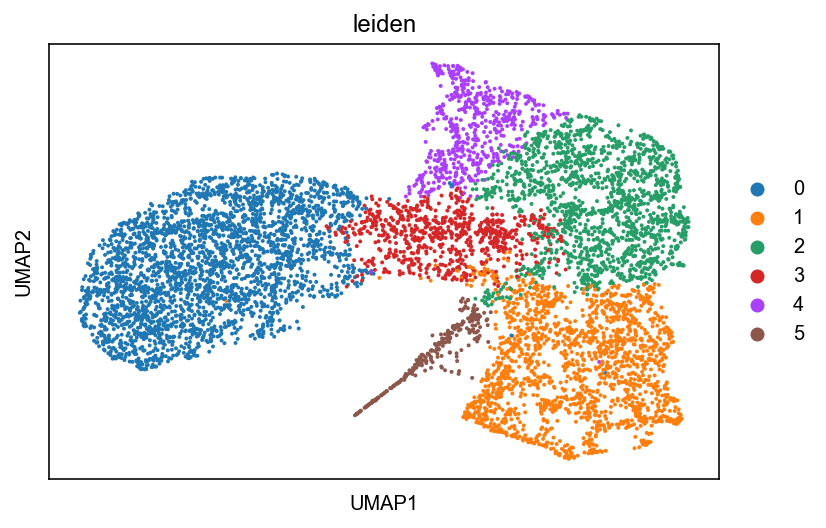

In [ ]:
sc.pl.umap(ad_stAlign, color='leiden')

Text(0, 0.5, '')

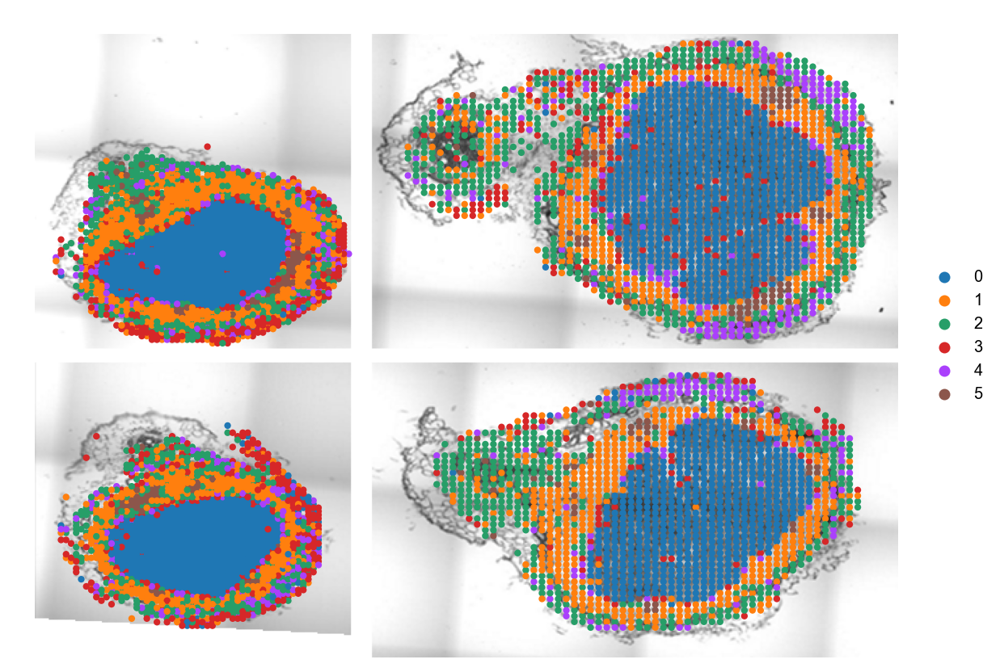

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.spatial(
    ad_stAlign,
    color="leiden",
    title='',
    size=0.12,
    show=False,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    ax=ax
)
# plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)
sns.despine(left=True, bottom=True)
plt.xlabel("")
plt.ylabel("")

In [ ]:
dt_stAnno = {"0": "0: Infected Zone", "1": "1: Inner Cortex", "2": "2: Outer Cortex", "3": "3: Epidermis", "4": "4: Outer Cortex", "5": "5: Vascular Bundle"}
ad_stAlign.obs["annotation"] = ad_stAlign.obs["leiden"].map(dt_stAnno)

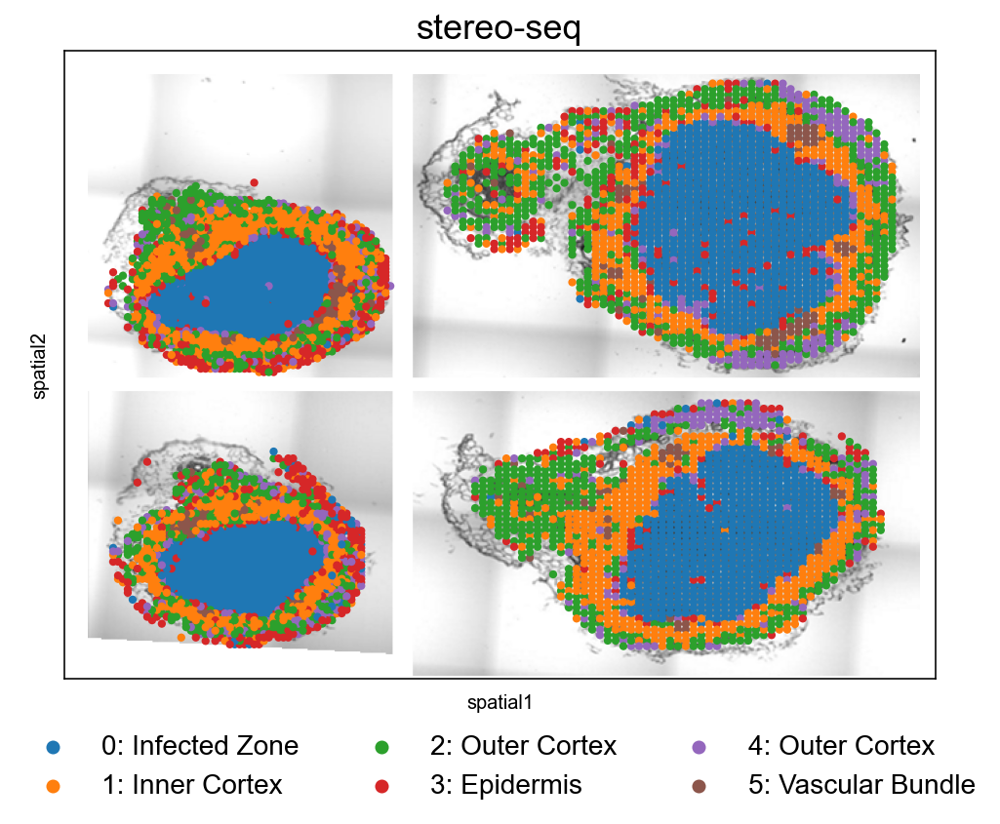

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
sc.pl.spatial(
    ad_stAlign,
    color="annotation",
    title='',
    size=0.15,
    show=False,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    ax=ax
)
plt.legend(ncol=3, loc='upper center', bbox_to_anchor=(0.5,-0.05), frameon=False, fontsize=14)
plt.title("stereo-seq", fontsize=18)
plt.savefig("/public/home/liuzj/share/scSoybean/allSpatial_sample/leiden.png", dpi=300, bbox_inches='tight')

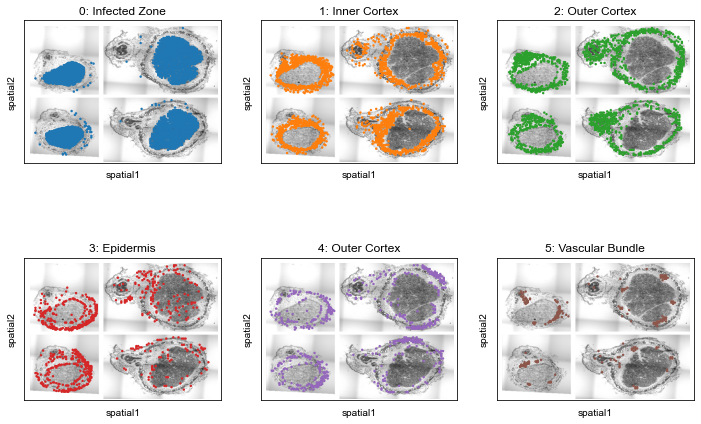

In [ ]:
fig, axs = plt.subplots(2, 3, figsize=(12,8))
axs = axs.reshape(-1)
for ax, ct in zip(axs, dt_stAnno.values()):
    sc.pl.spatial(
        ad_stAlign,
        color="annotation",
        title=ct,
        groups=[ct],
        size=0.2,
        show=False,
        # alpha=0.75,
        img_key="cross", 
        legend_loc=None,
        na_in_legend=False,
        ax=ax
    )

In [ ]:
# toPkl(ad_stAlign, 'ad_stAlign_20221013_mefisto_anno', 'ipf', dir_path=dir_result)

2022-10-13 16:30:48.102 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_stAlign_20221013_mefisto_anno', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


In [ ]:
ad_stAlign = loadPkl('ad_stAlign_20221013_mefisto_anno', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_result)

## get spec genes

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad_stAlign, 'raw', 'leiden')

In [ ]:
dt_stSpecGenes = ad_stAlign.uns['leiden_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
).groupby('leiden')['gene'].agg(list).to_dict()

In [ ]:
# ad_stAlign.uns['leiden_cellexES'].query(
#     "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
# ).to_excel(f"{dir_result}/stereoseq_spec_genes.xlsx")

In [ ]:
df_stSpecGenes = ad_stAlign.uns['leiden_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio / expressed_ratio_others > 2"
)

In [ ]:
df_stSpecGenes.merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
    "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
    engine="python",
).to_excel(f"{dir_result}/stereoseq_spec_genes.xlsx")

In [ ]:
_str = """GLYMA_05G244700 GLYMA_05G151300 GLYMA_11G185200 GLYMA_13G024500 GLYMA_18G036300
GLYMA_06G182700 GLYMA_20G203800
GLYMA_03G185900 GLYMA_09G093000 GLYMA_20G241600
GLYMA_05G220500 GLYMA_09G092700 GLYMA_12G217300 GLYMA_17G139700  GLYMA_17G019300
GLYMA_02G160500 GLYMA_02G003700  GLYMA_02G135100  GLYMA_06G310700"""
_ls = _str >> F(lambda x:x.split('\n')) >> F(map, str.split) >> F(list)
dt_stMarkerGeneExample = {x:y for x,y in zip(["0: Infected Zone", "1: Inner Cortex", "2: Outer Cortex", "4: Outer Cortex", "5: Vascular Bundle"], _ls)}

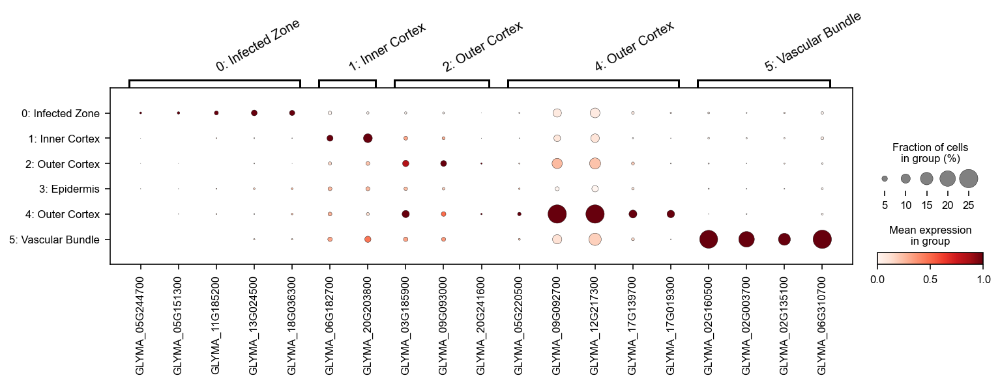

In [ ]:
axs = sc.pl.dotplot(ad_stAlign, dt_stMarkerGeneExample, groupby='annotation', cmap='Reds', layer='normalize_log', standard_scale='var', dot_max=0.25, figsize=(12,2.5), show=False)
ax = axs['gene_group_ax']
plt.sca(ax)
ax = axs['gene_group_ax']
for text in ax.texts:
    text.set(rotation=30, ha='left')

In [ ]:
# _ls = ['12','0', '7', '11', '1', '4','2', '3','9', '5', '6', '8','10', '13', '14']
_ls = ['12','0', '7', '11', '1', '4','2', '3','9', '5']

In [ ]:
_ad = ad[ad.obs.eval("Cluster in @_ls")].copy()
_ad.obs['Cluster'] = _ad.obs['Cluster'].cat.set_categories(_ls)

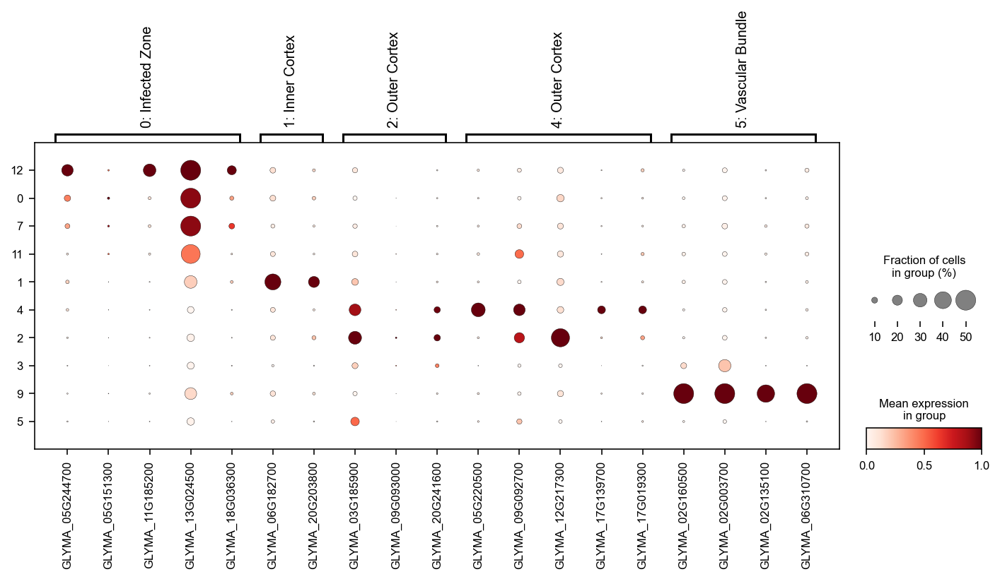

In [ ]:
sc.pl.dotplot(_ad, dt_stMarkerGeneExample, groupby='Cluster', cmap='Reds', layer='normalize_log', standard_scale='var', dot_max=0.5, figsize=(12,4))

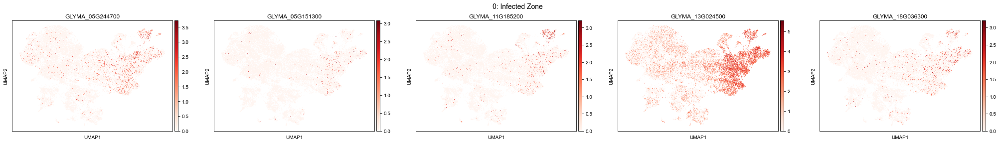

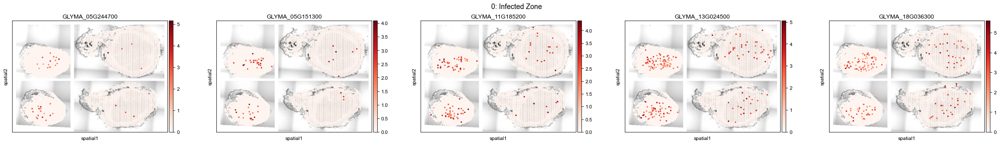

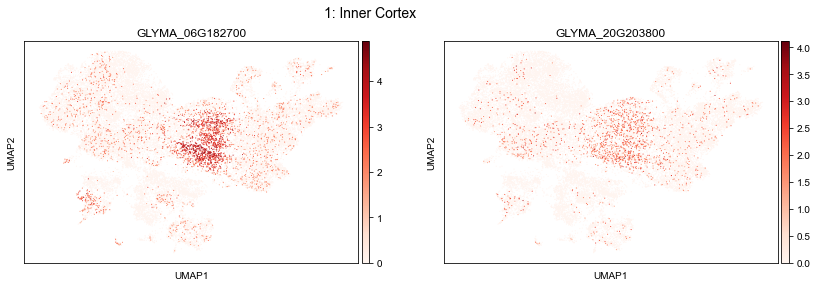

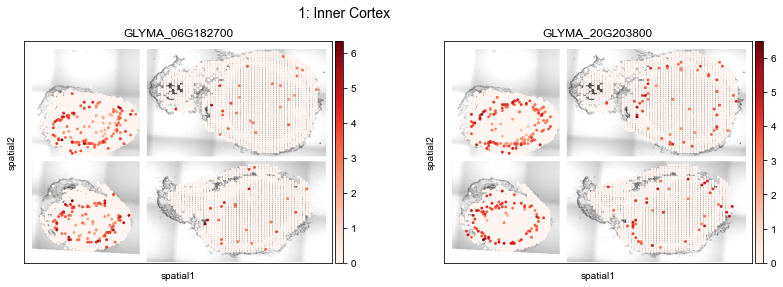

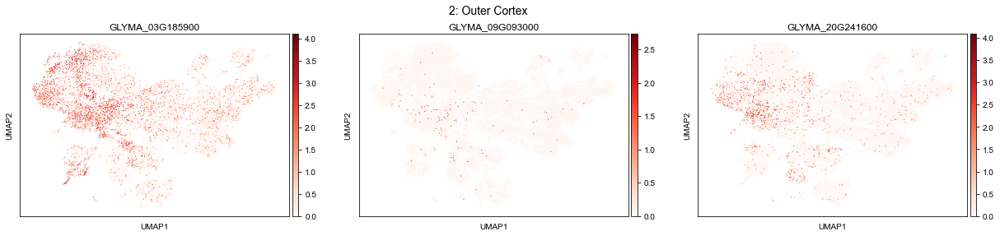

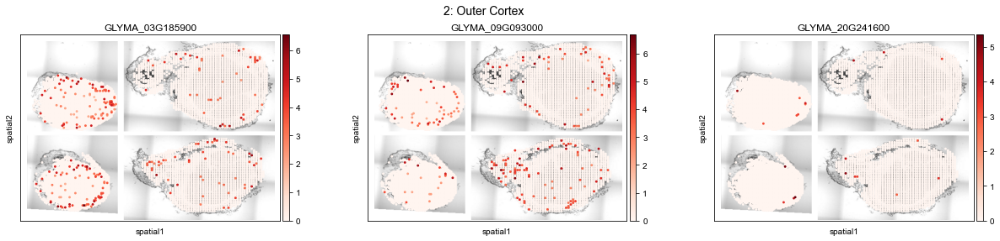

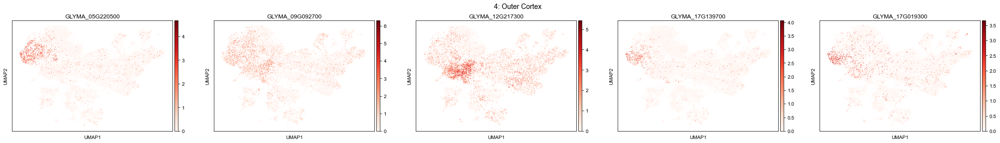

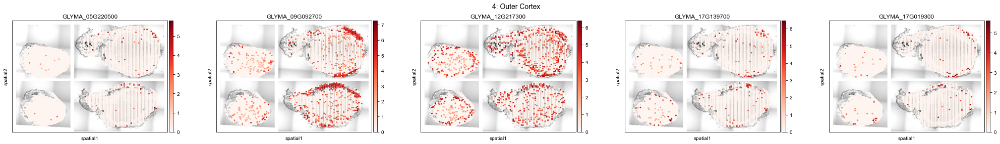

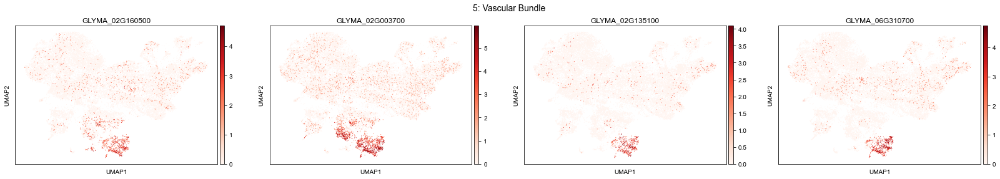

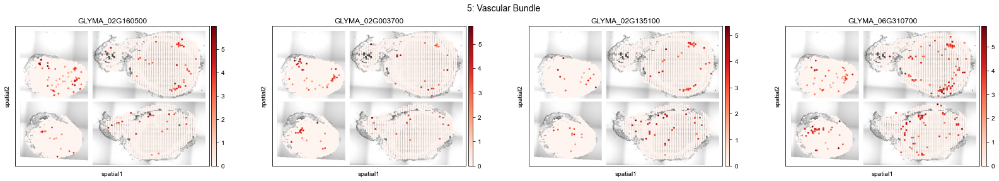

In [ ]:
for ct, ls_genes in dt_stMarkerGeneExample.items():
    ax = sc.pl.umap(ad, color=ls_genes, layer='normalize_log', cmap='Reds', ncols=5, show=False)
    plt.suptitle(ct, x=0.45, y=1.02, fontsize=14)
    plt.show()
    sc.pl.spatial(
        ad_stAlign,
        color=ls_genes,
        size=0.15,
        show=False,
        # alpha=0.75,
        img_key="cross", na_in_legend=False,
        layer='normalize_log', cmap='Reds', ncols=5
    )
    plt.suptitle(ct, x=0.45, y=1.02, fontsize=14)
    plt.show()

# final annotation

In [ ]:
# dt_cluster2Tissue = {
#     "0": "Cortex",
#     "1": "Cortex",
#     "2": "Unknown",
#     "3": "Stele",
#     "4": "Unknown",
#     "5": "Epidermis",
#     "6": "Cortex",
#     "7": "Cortex",
#     "8": "Endodermis",
#     "9":"Stele",
#     "10":"Cortex",
#     "11":"Unknown",
#     "12":"Infected zone",
#     "13":"Unknown",
#     "14":"Unknown",
# }
# dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
# ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)
dt_cluster2Tissue = {
    "0": "Uninfected cells*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Uninfected cells*",
    "8": "Unknown",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Uninfected cells*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)

In [ ]:
dt_cluster2Tissue = {
    "0": "Cells in infected zone*",
    "1": "Inner cortex",
    "2": "Outer cortex*",
    "3": "Vascular bundle",
    "4": "Outer cortex*",
    "5": "Epidermis",
    "6": "Unknown",
    "7": "Cells in infected zone*",
    "8": "Unknown",
    "9":"Vascular bundle",
    "10":"Unknown",
    "11":"Cells in infected zone*",
    "12":"Infected cells",
    "13":"Unknown",
    "14":"Unknown",
}
dt_cluster2Tissue = {x:f"{x}: {y}" for x,y in dt_cluster2Tissue.items()}
ad.obs['Cell type'] = ad.obs['Cluster'].map(dt_cluster2Tissue)

In [ ]:
%config InlineBackend.figure_format = 'png'


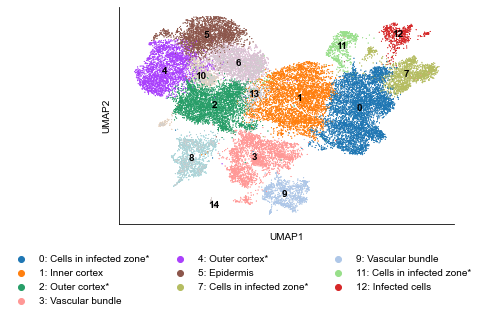

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = range(15) | F(map, str) | F(filter, lambda x: x not in ['6', '8', '10', '13', '14']) | F(list)
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False)

# ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
plt.legend(loc="upper left", bbox_to_anchor=(-0.35, -0.1), ncol=3, frameon=False)
# plt.title("Single-nucleus transcriptomes")
sns.despine()
plt.show()

In [ ]:
ad.obs['Sample_two'] = ad.obs['Sample'].map(lambda x:x.split(' ')[-1])

In [ ]:
singleCellTools.basic.getadataColor(ad, 'Sample')

{'Large Nodule': '#1f77b4', 'Small Nodule': '#ff7f0e', 'Root': '#2ca02c'}

In [ ]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)

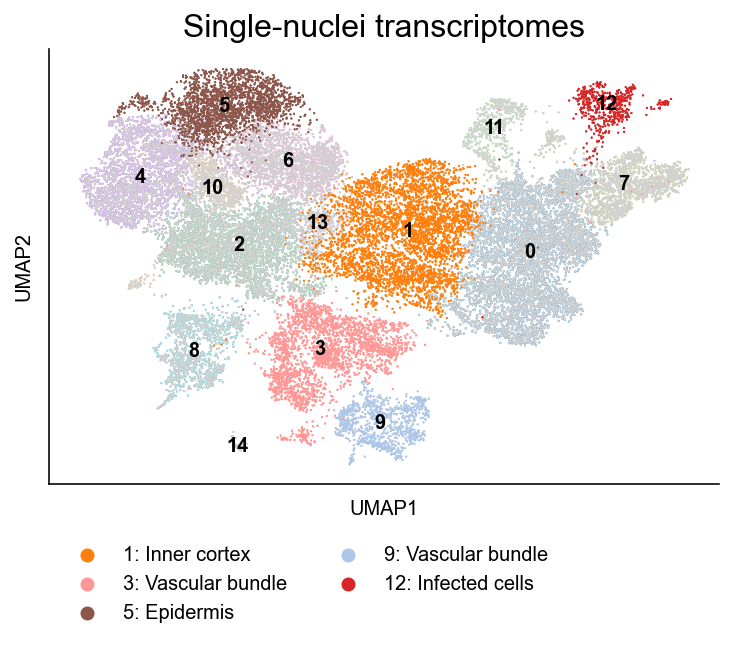

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", groups=[dt_cluster2Tissue[x] for x in _ls], na_in_legend=False)
sns.despine(top=True, right=True)
plt.legend(loc="upper left", bbox_to_anchor=(0, -0.1), ncol=2, frameon=False)
plt.title("Single-nuclei transcriptomes", fontsize=16)
plt.show()

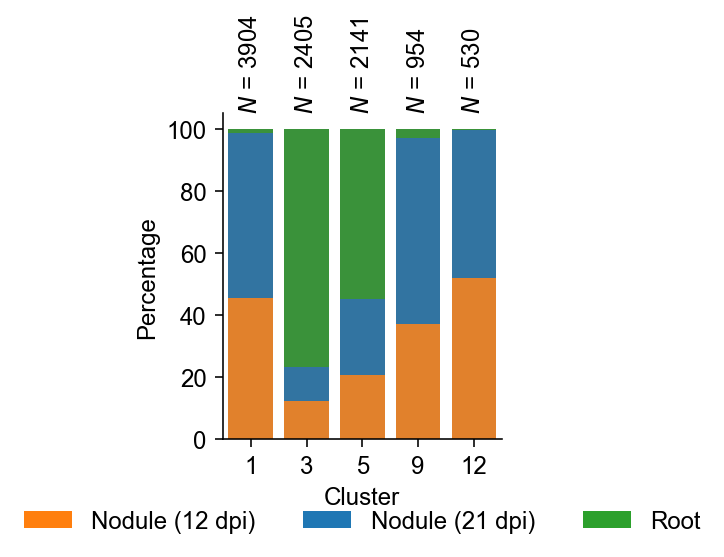

<AxesSubplot:xlabel='Cluster', ylabel='Percentage'>

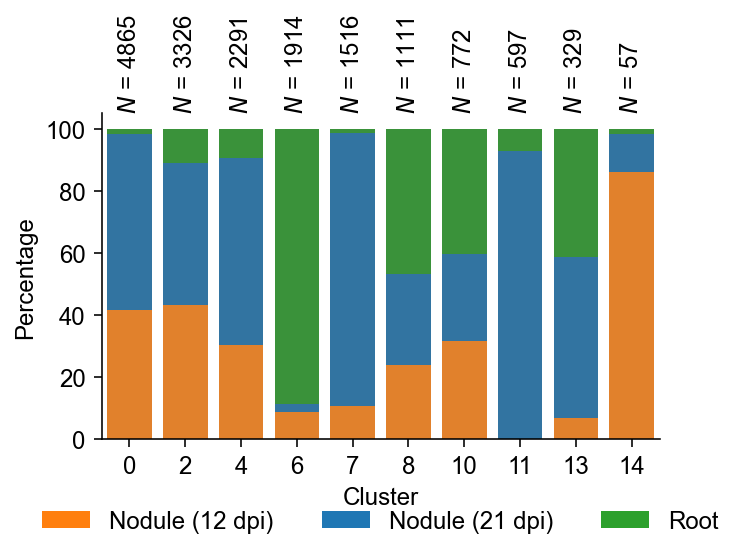

In [ ]:
_ls = (
    [x for x in ad.obs["Cell type"].unique() if ("*" not in x) & ("Unknown" not in x)]
    | F(map, lambda x: x.split(":")[0])
) | F(list)
fig,ax=plt.subplots(figsize=(2.5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)
plt.show()
fig,ax=plt.subplots(figsize=(5,3))
singleCellTools.plotting.plotLabelPercentageInCluster(
    ad[ad.obs.eval("Cluster not in @_ls")],
    "Cluster",
    "Sample_time",
    dt_kwargsForLegend={"ncol": 3, "bbox_to_anchor": [0.5, -0.15], 'loc':'upper center'},
)

In [ ]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

In [ ]:
ad.obs['Sample_time']

AAACCCAAGACGCAGT-1-batch-nodule_large    Nodule (21 dpi)
AAACCCAAGAGGATCC-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAAATACAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCAGTAG-1-batch-nodule_large    Nodule (21 dpi)
AAACCCACAGCTGTAT-1-batch-nodule_large    Nodule (21 dpi)
                                              ...       
TTTGTTGGTGTTACAC-1-batch-root                       Root
TTTGTTGTCAGTCCGG-1-batch-root                       Root
TTTGTTGTCCTCTTTC-1-batch-root                       Root
TTTGTTGTCGGTTGTA-1-batch-root                       Root
TTTGTTGTCTCATTTG-1-batch-root                       Root
Name: Sample_time, Length: 26712, dtype: category
Categories (3, object): ['Nodule (12 dpi)', 'Nodule (21 dpi)', 'Root']

In [ ]:
import importlib
importlib.reload(singleCellTools.plotting)

<module 'jpy_tools.singleCellTools.plotting' from '/public/home/liuzj/softwares/anaconda3/lib/python3.8/site-packages/jpy_tools/singleCellTools/plotting.py'>

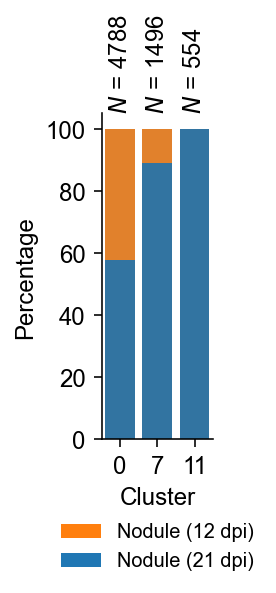

In [ ]:
with plt.rc_context({"figure.figsize": (1, 3)}):
    _ls = ["0", "7", "11"]
    singleCellTools.plotting.plotLabelPercentageInCluster(
        ad[ad.obs.eval("Sample in ['Large Nodule', 'Small Nodule'] & Cluster in @_ls")],
        "Cluster",
        "Sample_time",
        labelColor={"Nodule (12 dpi)": "#ff7f0e", "Nodule (21 dpi)": "#1f77b4"},
        dt_kwargsForLegend={
            "bbox_to_anchor": [0.5, -0.2],
            "loc": "upper center",
            "ncol": 1,
            "fontsize": 10,
        },
    )

# get marker

In [ ]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, 'raw', 'Cell type')

In [ ]:
df_marker = ad.uns['Cell type_cellexES'].assign(
    Cluster=lambda df: df["Cell type"].str.split(":").str[0]
)

In [ ]:
df_marker["Cluster"] = df_marker["Cluster"].astype("category").cat.set_categories(
    ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12", "13", "14"]
)

In [ ]:
# df_marker.drop(columns=["Cell type"]).query(
#     "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
# ).merge(df_symbol, how="left", left_on="gene", right_index=True).eval(
#     "Symbol = Symbol.fillna('') \n other_designations = other_designations.fillna('')",
#     engine="python",
# ).to_excel(f"{dir_result}/20220607_enrichGene.xlsx")

In [ ]:
ad.uns['Cell type_cellexES'].query(
    "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
)

,gene,Cell type,enrichScore,expressed_ratio,expressed_ratio_others
69,GLYMA_01G008000,0: Cortex,0.818345,0.111614,0.028928
83,GLYMA_01G009600,0: Cortex,0.811713,0.526208,0.197464
167,GLYMA_01G019700,0: Cortex,0.802225,0.364645,0.147984
224,GLYMA_01G027200,0: Cortex,0.783761,0.193011,0.064997
237,GLYMA_01G028600,0: Cortex,0.944330,0.110997,0.016844
...,...,...,...,...,...
589547,GLYMA_20G184900,9: Stele,0.800815,0.100629,0.008696
589627,GLYMA_20G195100,9: Stele,0.753702,0.406709,0.072599
589686,GLYMA_20G203100,9: Stele,0.868116,0.585954,0.031447
589713,GLYMA_20G206900,9: Stele,0.884120,0.606918,0.028496


In [ ]:
df_marker.drop(columns=["Cell type"]).query("expressed_ratio > 0.2 & expressed_ratio_others < 0.01")

,gene,enrichScore,expressed_ratio,expressed_ratio_others,Cluster
45735,GLYMA_04G079600,0.951995,0.213731,0.005821,10
58903,GLYMA_10G179400,0.952461,0.321244,0.009483,10
61374,GLYMA_11G200300,0.917594,0.310881,0.009715,10
83285,GLYMA_03G113200,0.961702,0.207705,0.004404,11
91803,GLYMA_07G195300,0.971626,0.232831,0.009420,11
...,...,...,...,...,...
586559,GLYMA_19G015800,0.915971,0.250524,0.007338,9
588247,GLYMA_19G258700,0.943305,0.210692,0.004736,9
589098,GLYMA_20G126500,0.930998,0.250524,0.007648,9
589543,GLYMA_20G184300,0.930953,0.292453,0.009589,9


In [ ]:
dt_marker = (
    df_marker.query(
        "enrichScore > 0.75 & expressed_ratio > 0.1 & expressed_ratio / expressed_ratio_others > 2"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

dt_spercificGenes = (
    df_marker.query(
        "expressed_ratio > 0.2 &expressed_ratio_others < 0.01"
    )
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
ls_c12EnrichedGenes = dt_marker['12']
ls_c12SpercificGenes= dt_spercificGenes['12']

In [ ]:
_ls_cluster = list(dt_marker.keys()) | F(sorted, key=int)
_ls_snfPropotion = [len([y for y in dt_marker[x] if y in ls_knownSnfGenes]) / len(dt_marker[x]) * 100 for x in _ls_cluster]

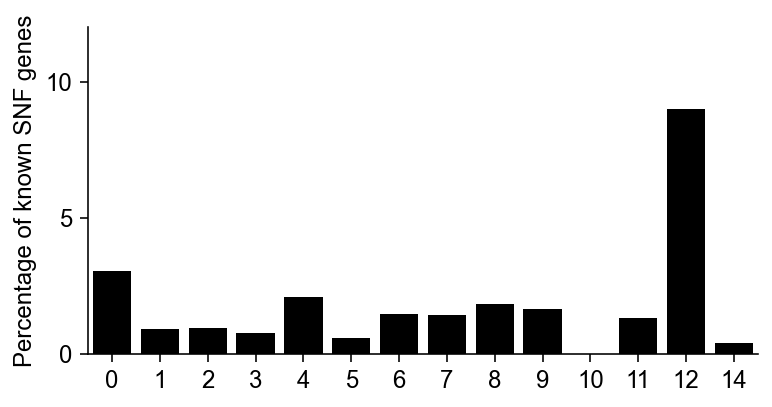

In [ ]:
fig, ax = plt.subplots(figsize=(6, 3))

# sns.barplot(y=["1", "2", "3"], x=[100, 100, 100], palette=["#D3D3D3"])
sns.barplot(
    x=_ls_cluster,
    y=_ls_snfPropotion,
    palette=["black"],
)
plt.ylabel("Percentage of known SNF genes")
plt.ylim(0, 12)
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))

plt.xticks(
    rotation=-90, ha='center'
)
sns.despine()
plt.xticks(rotation=0);

In [ ]:
len(ls_c12EnrichedGenes), len(ls_c12SpercificGenes), len(
    ls_c12EnrichedGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list)
), len(ls_c12SpercificGenes | F(filter, lambda x: x in ls_knownSnfGenes) | F(list))

(311, 33, 28, 2)

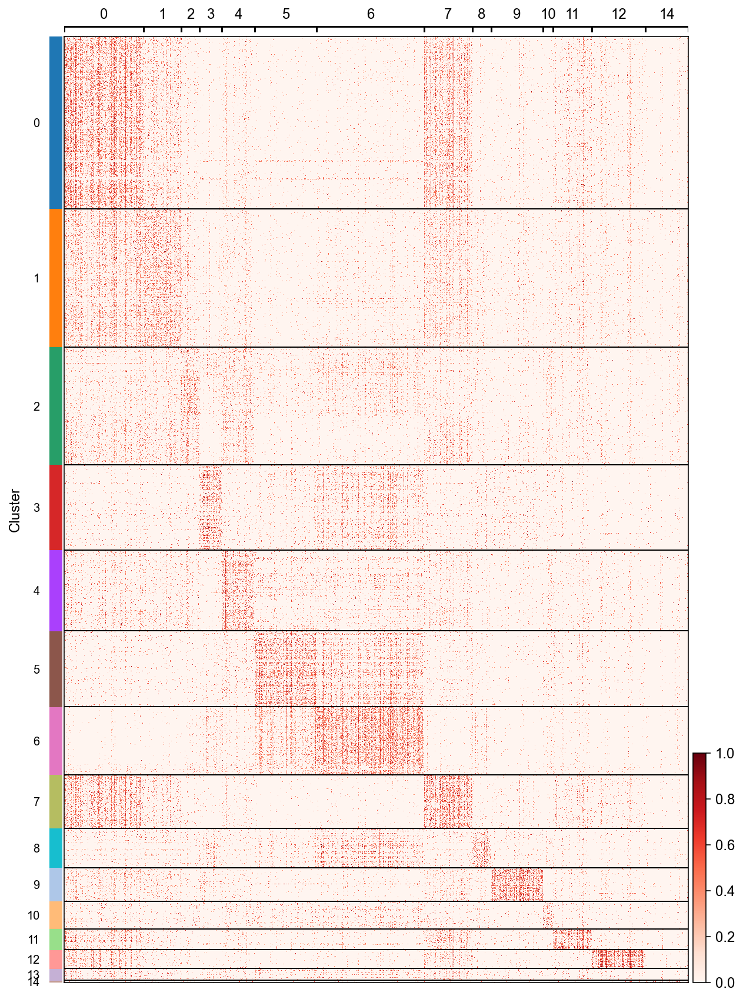

In [ ]:
sc.pl.heatmap(
    ad,
    {x: y for x, y in dt_marker.items() if y},
    "Cluster",
    layer="normalize_log",
    cmap="Reds",
    figsize=(10, 15), standard_scale='var'
)

In [ ]:
{x:len(y) for x,y in dt_marker.items() if y}

{'10': 3, '11': 6, '12': 33, '14': 50, '5': 3, '6': 2, '8': 7, '9': 28}

In [ ]:
2 / 33

0.06060606060606061

In [ ]:
{x:[z for z in y if z in ls_knownSnfGenes] for x,y in dt_marker.items() if y}

{'5': [],
 '6': [],
 '8': [],
 '9': [],
 '10': [],
 '11': [],
 '12': ['GLYMA_15G048400', 'GLYMA_07G025800'],
 '14': []}

Text(0.5, 1.0, 'Propotion of known SNF genes')

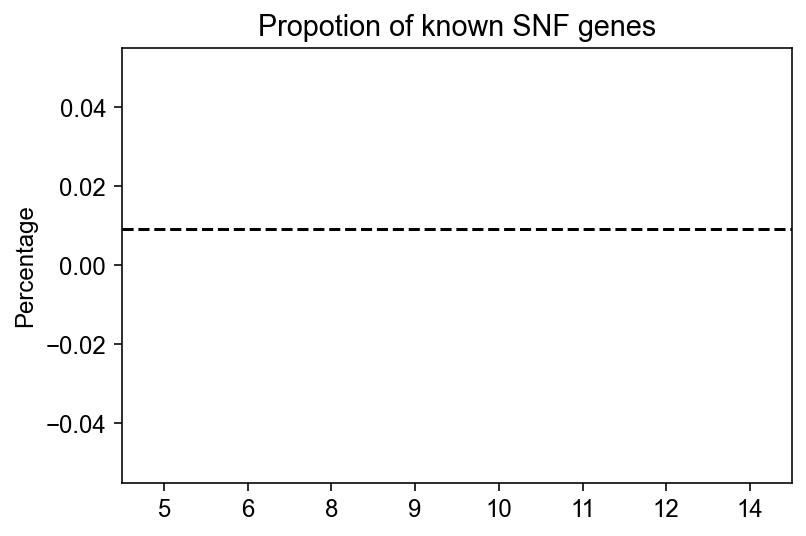

In [ ]:
_df = pd.Series({x:len([z for z in y if z in ls_knownSnfGenes]) / len(y) for x,y in dt_marker.items() if y})
sns.barplot(data = _df.reset_index(), x='index', y=0, palette=singleCellTools.basic.getadataColor(ad, 'Cluster'))
plt.ylabel('Percentage')
plt.xlabel('')
plt.axhline(len(ls_knownSnfGenes) / ad.shape[1], ls='--', color='black')
plt.title('Propotion of known SNF genes')

## sc spec gene in st data

In [ ]:
_dt_marker = dt_marker >> F(lambda j: {x: [z for z in y if z in ad_stAlign.var.index] for x, y in j.items() if y})

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(ad_stAlign, _dt_marker, 'raw', threads=14, label='scUpRegGenes_AUC')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


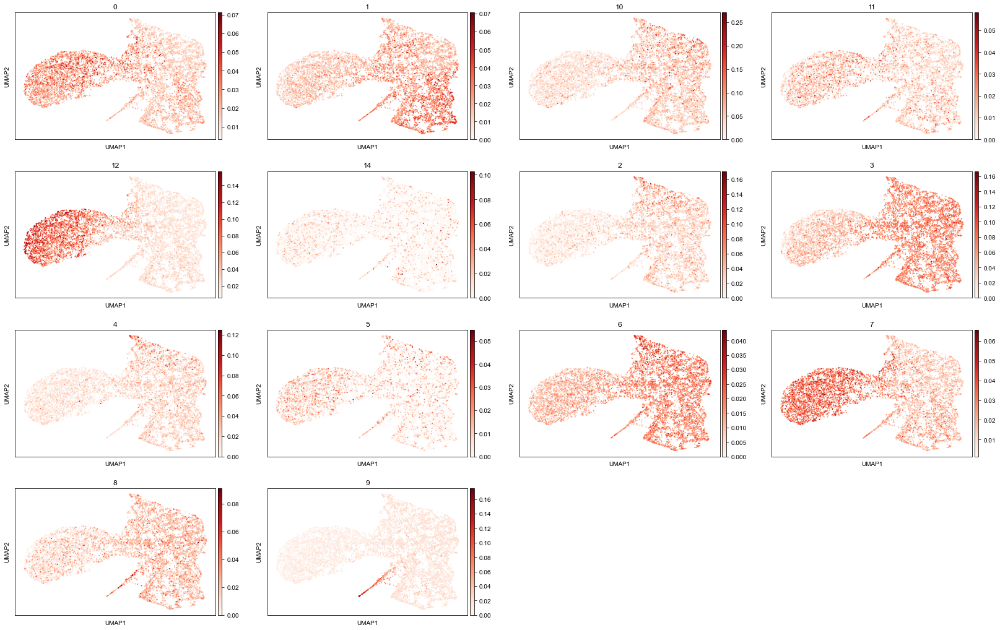

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_stAlign, 'scUpRegGenes_AUC')
sc.pl.umap(_ad, color=_ad.uns['plot_obsm'], cmap='Reds')

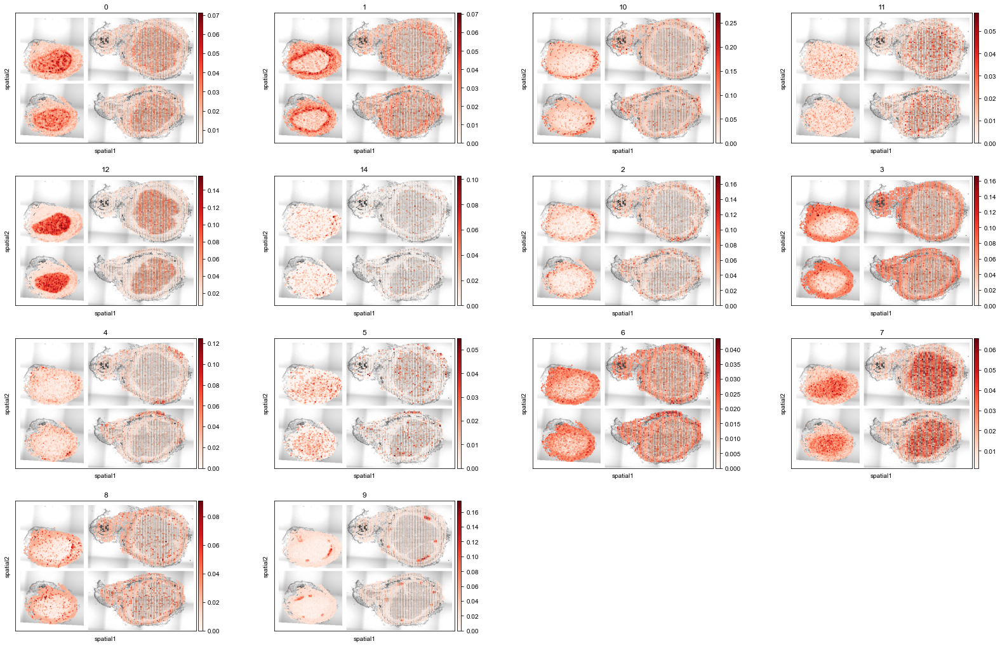

In [ ]:
sc.pl.spatial(
    _ad,
    color=_ad.uns['plot_obsm'],
    size=0.12,
    # alpha=0.75,
    img_key="cross", na_in_legend=False,
    cmap='Reds'
)
# plt.legend(ncol=1, loc='upper left', bbox_to_anchor=(0,-0.2), frameon=False)

## GO for each cluster

In [ ]:
from jpy_tools.otherTools import getGoDesc

In [ ]:
df_go = pd.read_table("/data/Zhaijx/liuzj/data/soybase_IPF/soybase_soybean_go_term.tsv")
df_goDesc = getGoDesc(df_go["goTerm"].unique().tolist())
_dt = df_goDesc["hitGO"].to_dict()
df_termGene = (
    df_go[["goTerm", "gene"]]
    .assign(goTerm=lambda df: df["goTerm"].map(_dt))
    .rename(columns={"gene": "Gene stable ID", "goTerm": "GO term accession"})
)
df_termName = df_goDesc.reset_index()[["hitGO", "hitName"]].rename(
    columns={"index": "GO term accession", "hitName": "GO term name"}
)
dt_goToCat = df_go.set_index("goTerm")["cate"].to_dict()

100%|██████████| 5017/5017 [01:16<00:00, 65.89it/s]
2022-11-03 13:50:08.631 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007126, target : GO:0051321
2022-11-03 13:50:08.633 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0016568, target : GO:0006325
2022-11-03 13:50:08.636 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0006944, target : GO:0061025
2022-11-03 13:50:08.642 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007067, target : GO:0000278
2022-11-03 13:50:08.643 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0006342, target : GO:0031507
2022-11-03 13:50:08.646 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0070838, target : GO:0030001
2022-11-03 13:50:08.647 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0009814, target : GO:0098542
2022-11-03 13:50:08.649 | WARNING  | jpy_tools.otherTools:getGoDesc:605 - query : GO:0007050, target : GO:0051726
2022-11-03 13:50:08.651 | WARNING  |

In [ ]:
ad_stAlign.obs['n_counts'].mean(), ad_stAlign.obs['n_genes'].mean()

(695.0361, 224.3304665102945)

In [ ]:
cpro = importr('clusterProfiler')
rBase = importr("base")
R = ro.r

dfR_termGene = py2r(df_termGene)
dfR_termName = py2r(df_termName)

In [ ]:
def enrichmentAnalysisGO(ls_gene, ls_background, qvalueCutoff=0.2, dt_goToCat=None, pvalueCutoff=0.05):
    _go = cpro.enricher(
        R.c(*ls_gene),
        universe=R.c(*ls_background),
        TERM2GENE=dfR_termGene,
        TERM2NAME=dfR_termName,
        qvalueCutoff=qvalueCutoff,
        pvalueCutoff=pvalueCutoff
    )
    df_go = r2py(rBase.as_data_frame(_go))
    if df_go.empty:
        return df_go
    df_go["-log10Pvalue"] = np.log10(df_go["pvalue"]) * -1
    if dt_goToCat:
        df_go["Category"] = df_go.index.map(dt_goToCat)
        df_go = df_go.sort_values(["Category", "pvalue"])
    else:
        df_go = df_go.sort_values(["pvalue"])
    return df_go

In [ ]:
dt_goColor = {x:y for x,y in zip(['Biological Process ', 'Cellular Component ', 'Molecular Function '], sns.palettes.color_palette())}

In [ ]:
def _fcSplitGoTerm(x, cutoff=40):
    from more_itertools import chunked
    ls_x = x.split(' ')
    parsed = ''
    lineChrCounts = 0
    for x in ls_x:
        x = x.strip()
        chrCounts = len(x)
        lineChrCounts += chrCounts
        if lineChrCounts > cutoff:
            parsed = parsed + '\n' + x
            lineChrCounts = 0
        else:
            parsed = parsed + ' ' + x
    return parsed

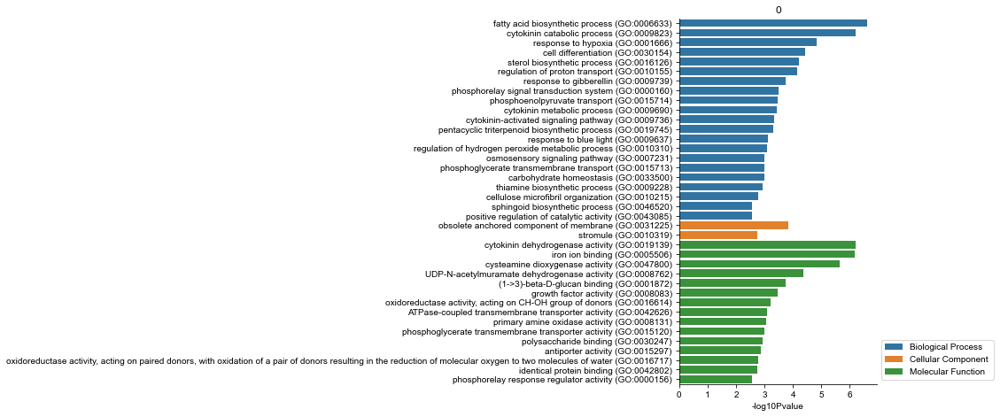

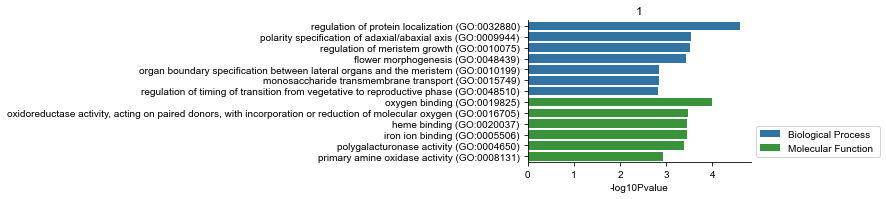

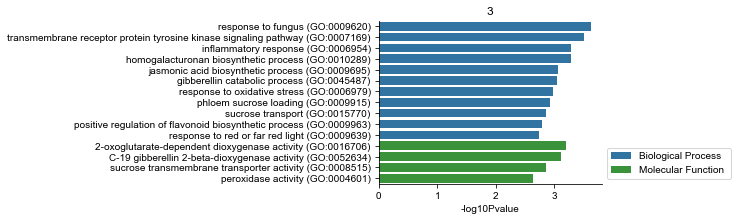

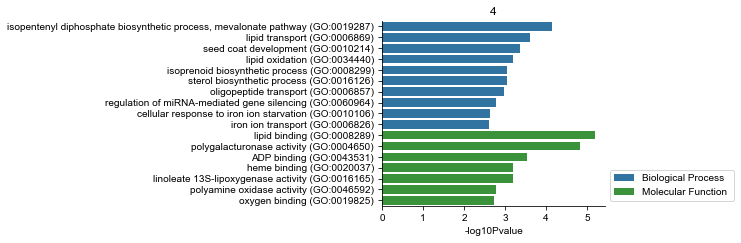

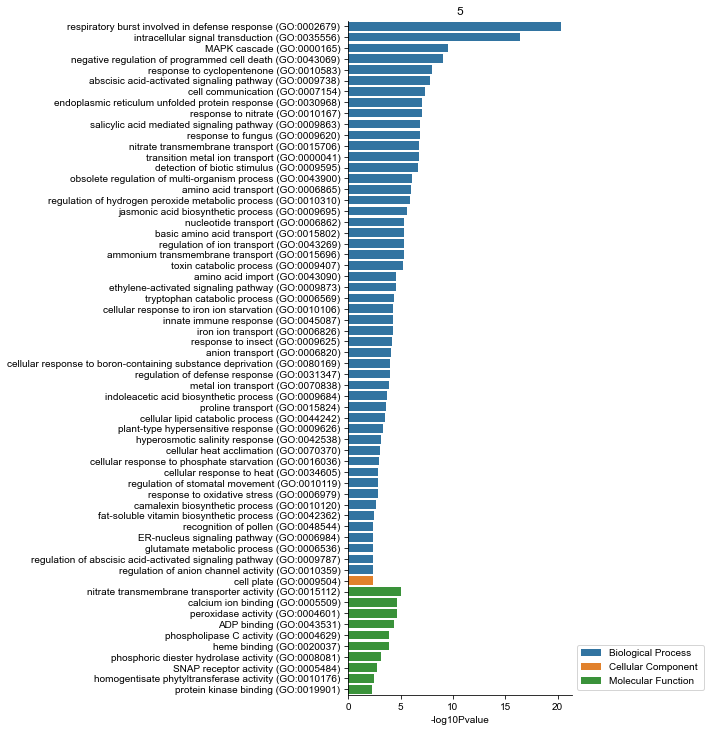

...

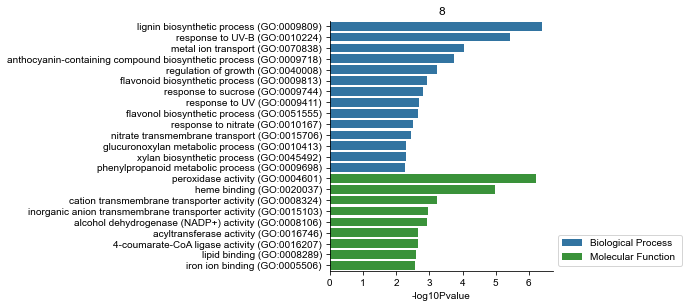

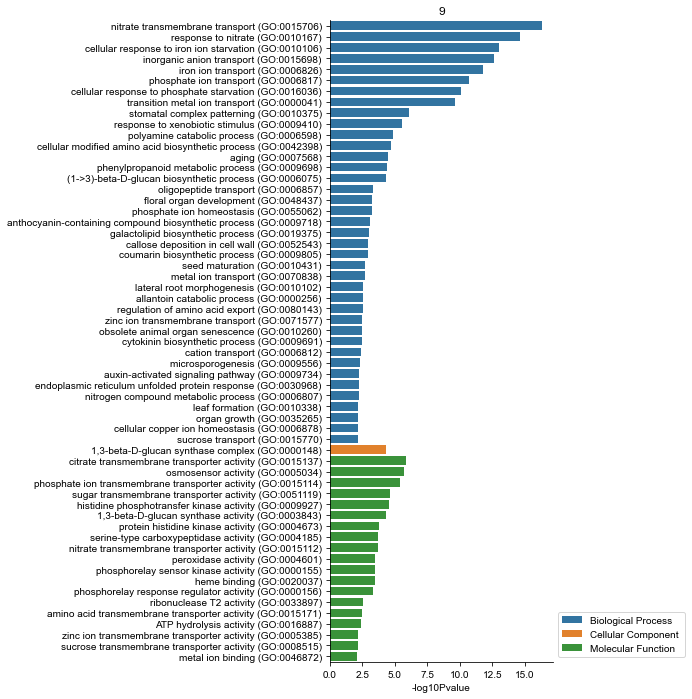

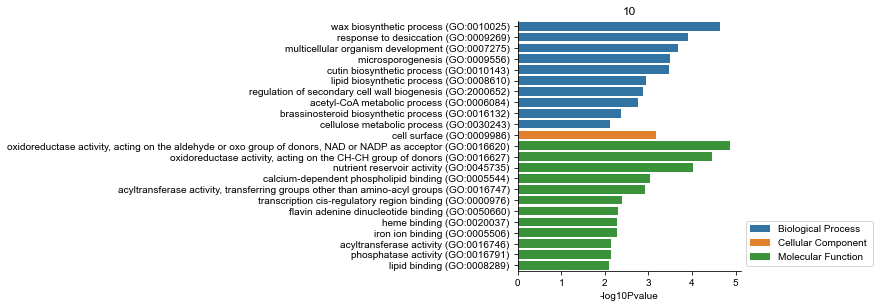

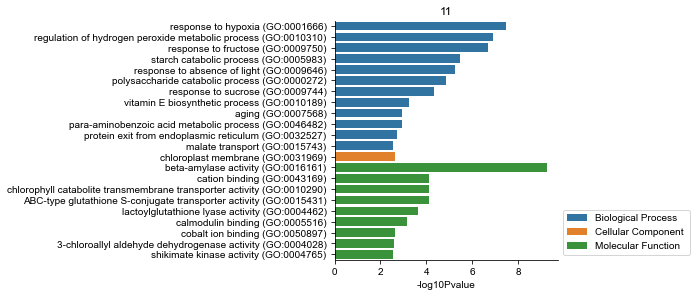

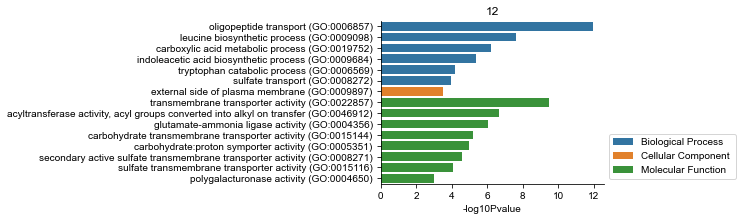

R[write to console]: --> No gene can be mapped....

R[write to console]: --> Expected input gene ID: GLYMA_17G001600,GLYMA_20G123100,GLYMA_18G025900,GLYMA_04G060500,GLYMA_19G026800,GLYMA_13G063400

R[write to console]: --> return NULL...



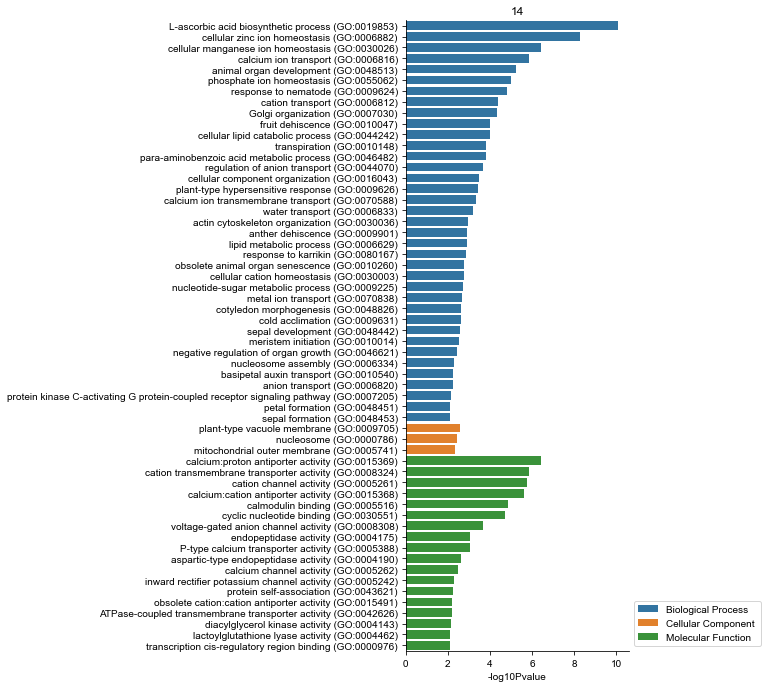

In [ ]:
lsDf_go = []
for cluster, ls_gene in dt_marker.items():
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

In [ ]:
_ls_go = ['GO:0009098', 'GO:0015144']
cluster = '12'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '12')
df_go = df_go.query("ID in @_ls_go")

In [ ]:
lsDf_go = []
_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

_ls_go = ['GO:0016161', 'GO:0010310', 'GO:0009750']
cluster = '11'
ls_gene = dt_marker[cluster]
df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat,  qvalueCutoff=0.2, pvalueCutoff=0.05)
df_go.insert(0, 'Cluster', '11')
df_go = df_go.query("ID in @_ls_go")
lsDf_go.append(df_go)

In [ ]:
fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
# plt.legend(loc='lower left', bbox_to_anchor=[1,0])
ax.
plt.ylabel('')
sns.despine(top=True, right=True)
plt.title('11')
plt.show() 

,Cluster,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,-log10Pvalue,Category
GO:0010310,11,GO:0010310,regulation of hydrogen peroxide metabolic proc...,14/218,388/35944,1.296308e-07,1.732731e-05,1.514633e-05,GLYMA_02G086100/GLYMA_06G061900/GLYMA_07G19530...,14,6.887292,Biological Process
GO:0009750,11,GO:0009750,response to fructose (GO:0009750),12/218,285/35944,2.033955e-07,2.039040e-05,1.782387e-05,GLYMA_01G161500/GLYMA_02G145300/GLYMA_06G05010...,12,6.691659,Biological Process
GO:0016161,11,GO:0016161,beta-amylase activity (GO:0016161),6/218,17/35944,5.437488e-10,2.180433e-07,1.905983e-07,GLYMA_01G203400/GLYMA_05G068000/GLYMA_11G03940...,6,9.264602,Molecular Function


In [ ]:
_ls = df_go.loc['GO:0010310', 'geneID'].split('/')
df_symbol.query("index in @_ls")

,Symbol,other_designations
geneID,,
GLYMA_16G141500,BZIP117,bZIP transcription factor bZIP117
GLYMA_06G061900,WRKY17,WRKY transcription factor 17
GLYMA_11G121800,LOC102661758,nonsymbiotic hemoglobin|non-symbiotic hemoglob...
GLYMA_12G150500,LOC100814871,stem-specific protein TSJT1
GLYMA_02G086100,LOC100811587,RNA-dependent RNA polymerase 1
GLYMA_09G073600,LOC100806761,sucrose synthase
GLYMA_18G273200,LOC100787893,protein DOWNY MILDEW RESISTANCE 6
GLYMA_13G181000,LOC100786699,stem-specific protein TSJT1
GLYMA_13G242100,LOC100816141,stem-specific protein TSJT1


In [ ]:
len(_ls)

14

### IC UC GO

In [ ]:
lsDf_go = []
for cluster in ['0']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    df_go.loc['GO:0016717', 'Description'] = 'oxidoreductase activity (GO:0016717)'
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

In [ ]:
lsDf_go = []
for cluster in ["7", "11", "12"]:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat=dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, "Cluster", cluster)
    lsDf_go.append(df_go)

    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(
        data=df_go,
        x="-log10Pvalue",
        y="Description",
        hue="Category",
        ax=ax,
        dodge=False,
        palette=dt_goColor,
    )
    plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
    plt.xlabel("-log$_{10}$Pvalue")

    plt.ylabel("")
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show()

In [ ]:
lsDf_go = []
for cluster in ['11']:
    ls_gene = dt_marker[cluster]
    df_go = enrichmentAnalysisGO(ls_gene, ad.var.index.to_list(), dt_goToCat = dt_goToCat)
    if df_go.empty:
        continue
    df_go.insert(0, 'Cluster', cluster)
    lsDf_go.append(df_go)
    
    fig, ax = plt.subplots(figsize=(4, df_go.shape[0] * 0.2))
    sns.barplot(data=df_go, x="-log10Pvalue", y="Description", hue = 'Category', ax=ax, dodge=False, palette=dt_goColor)
    plt.legend(loc='lower left', bbox_to_anchor=[1,0])
    plt.xlabel("-log$_{10}$Pvalue")
    plt.ylabel('')
    sns.despine(top=True, right=True)
    plt.title(cluster)
    plt.show() 

In [ ]:
fig, ax = plt.subplots(figsize=(12, 0.5))
sns.barplot(
    data=df_go.query("ID in ['GO:0005983', 'GO:0016161']"),
    x="-log10Pvalue",
    y="Description",
    #     hue="Category",
    ax=ax,
    dodge=False,
    color="black"
    #     palette=dt_goColor,
)
# plt.legend(loc="lower left", bbox_to_anchor=[1, 0])
plt.xlabel("-log$_{10}$Pvalue")
plt.ylabel("")
sns.despine(top=True, right=True)
plt.title(cluster)
plt.show()

# get diff gene for each cluster

In [ ]:
import diffxpy.api as de

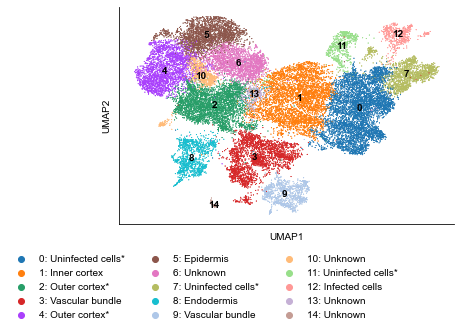

In [ ]:
# fig, ax = plt.subplots(figsize=(6, 3))
_ls = range(15) | F(map, str) | F(filter, lambda x: x not in ['6', '8', '10', '13', '14']) | F(list)
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", na_in_legend=False)

# ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="")
plt.legend(loc="upper left", bbox_to_anchor=(-0.35, -0.1), ncol=3, frameon=False)
# plt.title("Single-nucleus transcriptomes")
sns.despine()
plt.show()

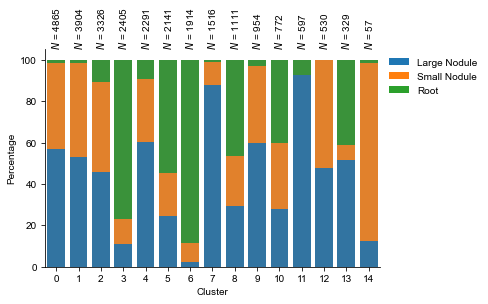

In [ ]:
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Sample")
plt.show()

In [ ]:
dt_diffxpyUseSampleForEachCluster = {}
ls_allUsedSample = ad.obs[["Cluster", "Sample"]].value_counts().loc[lambda sr:sr > 100].sort_index().index
for cluster, sample in ls_allUsedSample:
    if cluster not in dt_diffxpyUseSampleForEachCluster:
        dt_diffxpyUseSampleForEachCluster[cluster] = []
    dt_diffxpyUseSampleForEachCluster[cluster].append(sample)

In [ ]:
ls_diffxpyResults = []
for cluster, ls_diffxpyUsedSamples in dt_diffxpyUseSampleForEachCluster.items():
    print(cluster, ls_diffxpyUsedSamples)
    if len(ls_diffxpyUsedSamples) <= 1:
        print(f"Skip {cluster}")
        continue
    _ad = ad[ad.obs.eval("Cluster == @cluster & Sample in @ls_diffxpyUsedSamples"), :].copy()
    singleCellTools.geneEnrichInfo.getGeneMeanAndExpressedRatioGroups(_ad, layer='raw', groupby=['Sample'])
    de_res = de.test.versus_rest(_ad.layers['raw'], grouping='Sample', gene_names=_ad.var.index, sample_description=_ad.obs, quick_scale=True, noise_model='nb')
    for sample in ls_diffxpyUsedSamples:
        df_oneDiffxpyResult = de_res.summary_group(sample)
        df_oneDiffxpyResult = df_oneDiffxpyResult.merge(
            _ad.var[[f"Sample_{sample}_expressedRatio", f"Sample_{sample}_expressedCount"]].rename(columns=lambda x: x.replace(f"Sample_{sample}_", "")), 
            left_on='gene', right_index=True).assign(sample=sample, cluster=cluster
            )
        ls_diffxpyResults.append(df_oneDiffxpyResult)

0 ['Large Nodule', 'Small Nodule']
training location model: False
training scale model: False
iter   0: ll=87618564.355380
iter   1: ll=87618564.355380, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
training location model: False
training scale model: False
iter   0: ll=87557317.361295
iter   1: ll=87557317.361295, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
1 ['Large Nodule', 'Small Nodule']
training location model: False
training scale model: False
iter   0: ll=75932850.679249
iter   1: ll=75932850.679249, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
training location model: False
training scale model: False
iter   0: ll=75833950.477206
iter   1: ll=75833950.477206, converged: 100.00% (loc: 100.00%, scale update: True), in 0.00sec
2 ['Large Nodule', 'Small Nodule', 'Root']
training location model: False
training scale model: False
iter   0: ll=67738397.219641
iter   1: ll=67738397.219641, converged: 100.00% (loc: 100.00%,

In [ ]:
df_diffxpyResults = pd.concat(ls_diffxpyResults)
df_diffxpyResults = df_diffxpyResults.reset_index(drop=True)

In [ ]:
df_diffxpyResults = df_diffxpyResults.query("qval < 0.01 & log2fc < -4 & expressedCount > 10")

In [ ]:
dt_renameSample = {
    "Root": "Root",
    "Large Nodule": "Nodule (21 dpi)",
    "Small Nodule": "Nodule (12 dpi)",
}


df_diffxpyResults = df_diffxpyResults.assign(
    sample=lambda df: df["sample"].astype("category").cat.reorder_categories(['Small Nodule', 'Large Nodule', 'Root']).map(dt_renameSample),
    cluster=lambda df: df["cluster"].astype("category").cat.reorder_categories(['0', '1', '2', '3', '4', '5', '6', '7','8', '9', '10', '12', '13']),
)

In [ ]:
ls_diffxpyClusterUniqueGene = df_diffxpyResults['gene'].value_counts().loc[lambda x:x==1].index.to_list()

In [ ]:
df_diffxpyResults = df_diffxpyResults.assign(clusterUnique=lambda df: np.where(df['gene'].isin(ls_diffxpyClusterUniqueGene), 'Yes', 'No'))
df_diffxpyResults['clusterUnique'] = df_diffxpyResults['clusterUnique'].astype('category').cat.set_categories(['Yes', 'No'])

In [ ]:
df_diffxpyResults.value_counts(['clusterUnique']) / len(df_diffxpyResults)

clusterUnique
No               0.553776
Yes              0.446224
dtype: float64

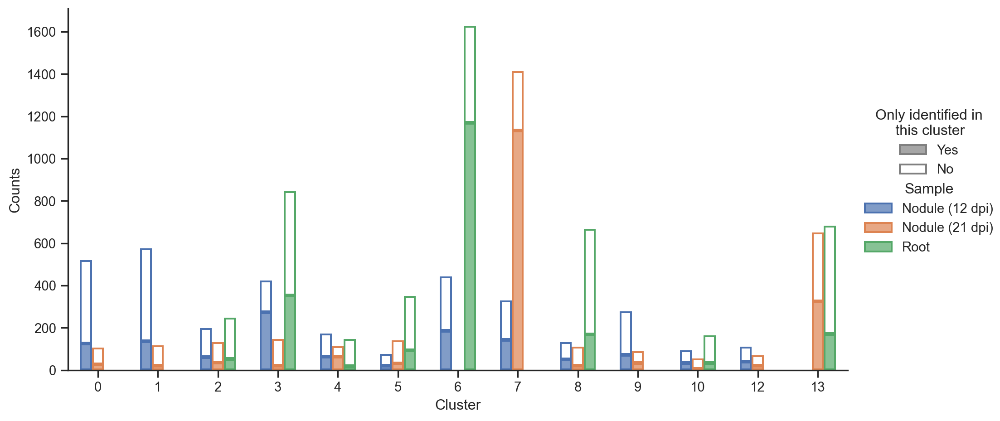

In [ ]:
(
    so.Plot(
        data=df_diffxpyResults.value_counts(['sample', 'cluster', 'clusterUnique']).rename("Counts").sort_index().reset_index().rename(columns=str.capitalize), 
        x='Cluster', y='Counts', fill='Clusterunique', color='Sample'
    )
    .add(so.Bar(width=0.6, edgewidth=1.5), so.Dodge(by=['color']), so.Stack())
    .scale(color="deep")
    .theme(dt_snsStyle)
    .label(fill='Only identified in\n     this cluster')
    .layout(size=(10,5))
)

In [ ]:
df_diffxpyResults['log2fc'] = df_diffxpyResults['log2fc'] * -1

In [ ]:
# df_diffxpyResults.to_excel(f"{dir_result}/cluster_within_deg.xlsx", index=False)

In [ ]:
df_diffxpyResults = df_diffxpyResults.assign(cluster_sample=lambda df:df['cluster'].astype(str) + ': ' + df['sample'].astype(str))
df_upset = df_diffxpyResults.pivot_table(values='expressedCount', index='gene', columns='cluster_sample').notna().value_counts()

In [ ]:
import upsetplot

{'matrix': <AxesSubplot:>,
 'shading': <AxesSubplot:>,
 'totals': <AxesSubplot:>,
 'intersections': <AxesSubplot:ylabel='Intersection size'>}

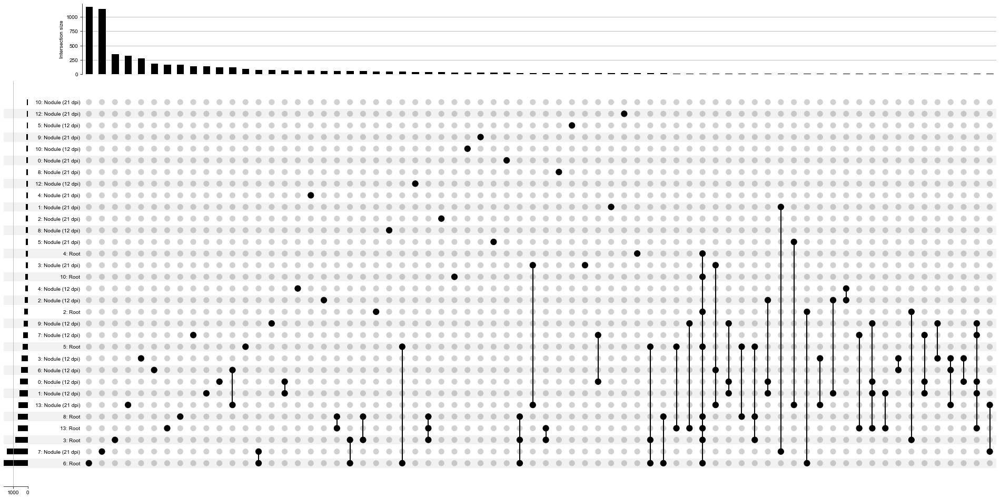

In [ ]:
upsetplot.plot(df_upset, min_subset_size=10, sort_by='cardinality')

# for web

In [ ]:
import lmdb
import tqdm
import pickle

In [ ]:
env = lmdb.open("/data/Zhaijx/liuzj/projects/singleCell/soybean/03_web/all_spatial", map_size=1099511627776)
txn = env.begin(write=True) 

In [ ]:
for gene in tqdm.tqdm(ad_stAlign.var.index):
    value = pickle.dumps(ad_stAlign[:, gene].layers['normalize_log'].A.reshape(-1))
    txn.put(key=gene.encode(), value=value)

100%|██████████| 27744/27744 [05:22<00:00, 86.13it/s]


In [ ]:
value = pickle.dumps(ad_stAlign.obsm['spatial'][:, 0] * ad_stAlign.uns['spatial']['Soybean']['scalefactors']['tissue_cross_scalef'])
txn.put(key='x'.encode(), value=value)

value = pickle.dumps(ad_stAlign.obsm['spatial'][:, 1] * ad_stAlign.uns['spatial']['Soybean']['scalefactors']['tissue_cross_scalef'])
txn.put(key='y'.encode(), value=value)

True

In [ ]:
value = pickle.dumps(ad_stAlign.uns['spatial']['Soybean']['images']['cross'])
txn.put(key='image'.encode(), value=value)

True

In [ ]:
txn.commit()
env.close()

In [ ]:
penguins = sns.load_dataset('penguins')

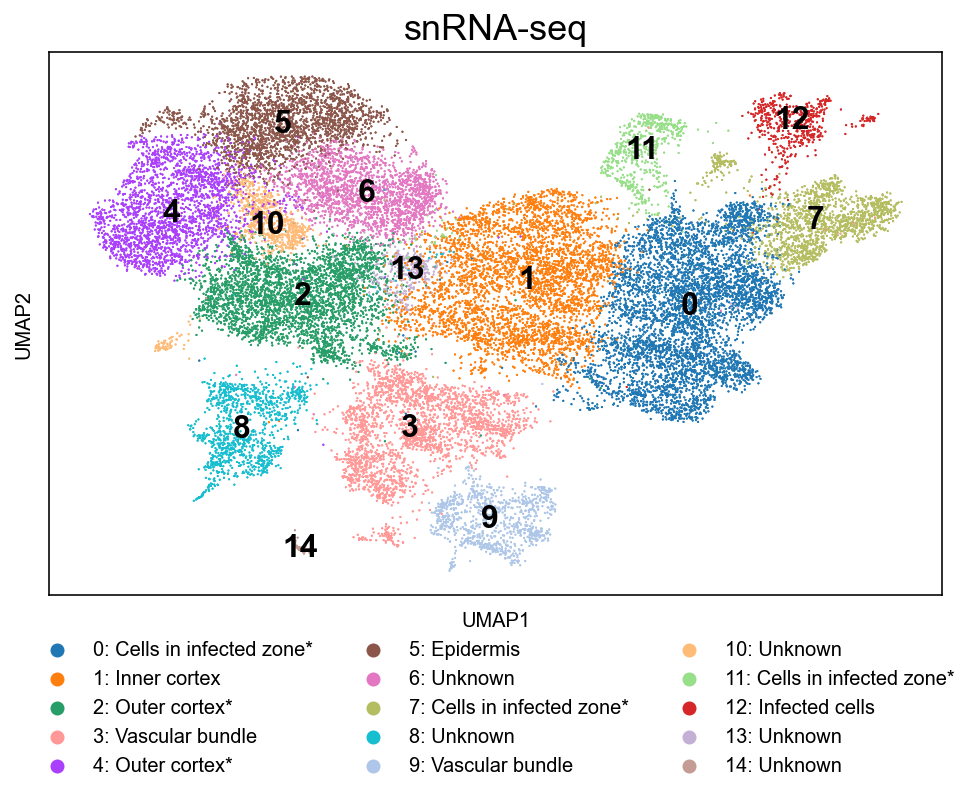

In [ ]:
fig, ax = plt.subplots(figsize=(8,5))
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False, na_in_legend=False, ax=ax)
sc.pl.umap(ad, color="Cell type", show=False, ax=ax, title="", na_in_legend=False)
plt.title('snRNA-seq', fontsize=18)
plt.legend(loc="upper center", bbox_to_anchor=(0.5, -0.05), ncol=3, frameon=False)
for text in ax.texts:
    text.set_fontsize(16)

plt.savefig("/public/home/liuzj/share/scSoybean/allUmap_bc/leiden.png", dpi=300, bbox_inches='tight')
plt.show()

## save barplot

In [ ]:
from joblib import Parallel, delayed
from more_itertools import chunked

In [ ]:
ad_merged = singleCellTools.geneEnrichInfo._mergeData(ad, 'Cluster', layer='raw')

In [ ]:
singleCellTools.basic.initLayer(ad_merged, total=1e6)

In [ ]:
_ls_colors = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#ff9896',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78',
 '#98df8a',
 '#d62728',
 '#c5b0d5',
 '#c49c94']

In [ ]:
def batchBarplot(ad_merged, ls_gene):
    for gene in ls_gene:
        sns.barplot(
            x=ad_merged.obs.index, y=ad_merged[:, gene].X.reshape(-1), palette=_ls_colors
        )
        plt.xlabel('Cluster')
        plt.ylabel('Expression\n(Log CPM)')
        plt.title(gene)
        plt.savefig(f"/public/home/liuzj/share/scSoybean/allBar/{gene}.bar.png", dpi=100)
        plt.close()

In [ ]:
ls_chunkedGene = chunked(ad.var.index.to_list(), 1000)
Parallel(12)(delayed(batchBarplot)(ad_merged, ls_gene) for ls_gene in ls_chunkedGene)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]